# **Import Libraries**

In [1]:
!pip uninstall -y scikit-learn
!pip install scikit-learn==1.2.2


Found existing installation: scikit-learn 1.2.2
Uninstalling scikit-learn-1.2.2:
  Successfully uninstalled scikit-learn-1.2.2
  Obtaining dependency information for scikit-learn==1.2.2 from https://files.pythonhosted.org/packages/db/98/169b46a84b48f92df2b5e163fce75d471f4df933f8b3d925a61133210776/scikit_learn-1.2.2-cp311-cp311-win_amd64.whl.metadata
  Using cached scikit_learn-1.2.2-cp311-cp311-win_amd64.whl.metadata (11 kB)
Using cached scikit_learn-1.2.2-cp311-cp311-win_amd64.whl (8.3 MB)


In [2]:
import pandas as pd
from glob import glob
import matplotlib as mlt
from IPython.display import display
import matplotlib.pyplot as plt
import numpy as np
import scipy
from scipy.signal import butter, lfilter, filtfilt,argrelextrema
import scipy.stats as stats
import re
import copy
import math
import itertools
import seaborn as sns
from sklearn.metrics import accuracy_score,confusion_matrix,mean_absolute_error
from sklearn.decomposition import PCA
from sklearn.neural_network import MLPClassifier
from sklearn.svm import SVC,LinearSVC
from sklearn.neighbors import KNeighborsClassifier,LocalOutlierFactor
from sklearn.tree import DecisionTreeClassifier
from sklearn import tree
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV,train_test_split
from sklearn.cluster import KMeans


plt.style.use("fivethirtyeight")
plt.rcParams["figure.figsize"]=(20,5)
plt.rcParams["figure.dpi"]=100
plt.rcParams["lines.linewidth"]=2

# **Custom Modules**

In [3]:
def count(df,cutoff=0.4,order=10,column="Accelerometer_r"):
    data=LowPass.low_pass_filter(df,column,fs,cutoff,order)
    indexes=argrelextrema(data[column+"_lowpass"].values,np.greater)
    peeks=data.iloc[indexes]
    fig,ax=plt.subplots()
    plt.plot(df[f"{column}_lowpass"])
    plt.plot(peeks[f"{column}_lowpass"],"o",color="red")
    ax.set_ylabel(f"{column}_lowpass")
    exercise=df["Label"].iloc[0].title()
    category=df["Category"].iloc[0].title()
    plt.title(f"{category} {exercise}: {len(peeks)} Reps")
    plt.show()
    return len(peeks)

# This class performs a Fourier transformation on the data to find frequencies that occur often and filter noise.
 
class FourierTransformation:
    
    def __init__(self):
        self.temp_list = []
        self.freqs = None

    # Find the amplitudes of the different frequencies using a fast fourier transformation. Here,
    # the sampling rate expresses the number of samples per second (i.e. Frequency is Hertz of the dataset).
    
    def find_fft_transformation(self, data):
        # Create the transformation, this includes the amplitudes of both the real and imaginary part.
        
        transformation = np.fft.rfft(data, len(data))
        real_amp = transformation.real
        maximum_freq = self.freqs[np.argmax(real_amp[0:len(real_amp)])]
        freq_weigthed = float(np.sum(self.freqs * real_amp)) / np.sum(real_amp)


        PSD = np.divide(np.square(real_amp), float(len(real_amp)))
        PSD_pdf = np.divide(PSD, np.sum(PSD))

        # confirming that there are no zeros.
        if np.count_nonzero(PSD_pdf) == PSD_pdf.size:
            pse = -np.sum(np.log(PSD_pdf) * PSD_pdf)
        else:
            pse = 0

        real_amp = np.insert(real_amp, 0, maximum_freq)
        real_amp = np.insert(real_amp, 0, freq_weigthed)
        row = np.insert(real_amp, 0, pse)

        self.temp_list.append(row)

        return 0

    # Get frequencies over a certain period.
    def abstract_frequency(self, data_table, columns, window_size, sampling_rate):
        self.freqs = (sampling_rate * np.fft.rfftfreq(int(window_size))).round(3)

        for col in columns:
            collist = []
            # preparing the column names
            collist.append(col + '_maximum_freq')
            collist.append(col + '_freq_weighted')
            collist.append(col + '_pse')
            
            collist = collist + [col + '_freq_' +
                    str(freq) + '_Hz_ws_' + str(window_size) for freq in self.freqs]
           
            # rolling statistics to calculate frequencies, per window size. 

            data_table[col].rolling(
                window_size + 1).apply(self.find_fft_transformation)

            # Padding the missing rows with NANs
            frequencies = np.pad(np.array(self.temp_list), ((window_size, 0), (0, 0)),
                        'constant', constant_values=np.nan)
            
            data_table[collist] = pd.DataFrame(frequencies, index=data_table.index)

            # reset temp-storage array
            del self.temp_list[:]
            

        
        return data_table

class AlgorithmClassification:

    # Forward selection for classification which selects a pre-defined number of features (max_features)
    # that show the best accuracy. We assume a decision tree learning for this purpose, but
    # this can easily be changed. It return the best features.
    def forward_selection(self, max_features, X_train, y_train):
        # Start with no features.
        ordered_features = []
        ordered_scores = []
        selected_features = []
        ac = AlgorithmClassification()
        prev_best_perf = 0

        # Select the required number of features.
        for i in range(0, max_features):
            print(i)

            # Determine the features left to select.
            features_left = list(set(X_train.columns) - set(selected_features))
            best_perf = 0
            best_attr = ""

            for f in features_left:
                temp_selected_features = copy.deepcopy(selected_features)
                temp_selected_features.append(f)

                # Determine the accuracy of a decision tree learner if we were to add the feature.
                
                (
                    pred_y_train,
                    pred_y_test,
                    prob_training_y,
                    prob_test_y,
                ) = ac.decision_tree(
                    X_train[temp_selected_features],
                    y_train,
                    X_train[temp_selected_features],
                )
                perf = accuracy_score(y_train, pred_y_train)

                # The current feature is set to the best feature if the performance exceeds our expectations 
                # (we aim for high accuracy), and the same is true for the best performance.
                
                if perf > best_perf:
                    best_perf = perf
                    best_feature = f
            #selecting the feature which has the best performance.
            selected_features.append(best_feature)
            prev_best_perf = best_perf
            ordered_features.append(best_feature)
            ordered_scores.append(best_perf)
        return selected_features, ordered_features, ordered_scores

    
    # Use a neural network to classify training data (with specific hidden layers and iterations) 
    # and predict outcomes for both the test and training sets.
    # The output includes categorical predictions for the training and test sets, 
    # as well as probabilities for each class expressed as a column in the data frame.
    
    def feedforward_neural_network(
        self,
        train_X,
        train_y,
        test_X,
        hidden_layer_sizes=(100,),
        max_iter=2000,
        activation="logistic",
        alpha=0.0001,
        learning_rate="adaptive",
        gridsearch=True,
        print_model_details=False,
    ):

        if gridsearch:
            tuned_parameters = [
                {
                    "hidden_layer_sizes": [
                        (5,),
                        (10,),
                        (25,),
                        (100,),
                        (
                            100,
                            5,
                        ),
                        (
                            100,
                            10,
                        ),
                    ],
                    "activation": [activation],
                    "learning_rate": [learning_rate],
                    "max_iter": [1000, 2000],
                    "alpha": [alpha],
                }
            ]
            nn = GridSearchCV(
                MLPClassifier(), tuned_parameters, cv=5, scoring="accuracy"
            )
        else:
            # model creation
            nn = MLPClassifier(
                hidden_layer_sizes=hidden_layer_sizes,
                activation=activation,
                max_iter=max_iter,
                learning_rate=learning_rate,
                alpha=alpha,
            )

        # Fit the model
        nn.fit(
            train_X,
            train_y.values.ravel(),
        )

        if gridsearch and print_model_details:
            print(nn.best_params_)

        if gridsearch:
            nn = nn.best_estimator_

        # Apply the model
        pred_prob_training_y = nn.predict_proba(train_X)
        pred_prob_test_y = nn.predict_proba(test_X)
        pred_training_y = nn.predict(train_X)
        pred_test_y = nn.predict(test_X)
        frame_prob_training_y = pd.DataFrame(pred_prob_training_y, columns=nn.classes_)
        frame_prob_test_y = pd.DataFrame(pred_prob_test_y, columns=nn.classes_)

        return pred_training_y, pred_test_y, frame_prob_training_y, frame_prob_test_y
    
    # Use a support vector machine to classify training data using stated values for C, epsilon, and kernel function. 
    # Use the model to predict outcomes for both test and training sets. 
    # It provides categorical predictions and probabilities for the training and test sets, 
    # with each class represented as a column in a data frame.
    def support_vector_machine_with_kernel(
        self,
        train_X,
        train_y,
        test_X,
        kernel="rbf",
        C=1,
        gamma=1e-3,
        gridsearch=True,
        print_model_details=False,
    ):
        # Create the model
        if gridsearch:
            tuned_parameters = [
                {"kernel": ["rbf", "poly"], "gamma": [1e-3, 1e-4], "C": [1, 10, 100]}
            ]
            svm = GridSearchCV(
                SVC(probability=True), tuned_parameters, cv=5, scoring="accuracy"
            )
        else:
            svm = SVC(
                C=C, kernel=kernel, gamma=gamma, probability=True, cache_size=7000
            )

        # Fit the model
        svm.fit(train_X, train_y.values.ravel())

        if gridsearch and print_model_details:
            print(svm.best_params_)

        if gridsearch:
            svm = svm.best_estimator_

        # Apply the model
        pred_prob_training_y = svm.predict_proba(train_X)
        pred_prob_test_y = svm.predict_proba(test_X)
        pred_training_y = svm.predict(train_X)
        pred_test_y = svm.predict(test_X)
        frame_prob_training_y = pd.DataFrame(pred_prob_training_y, columns=svm.classes_)
        frame_prob_test_y = pd.DataFrame(pred_prob_test_y, columns=svm.classes_)

        return pred_training_y, pred_test_y, frame_prob_training_y, frame_prob_test_y
    
    # Use a support vector machine to classify training data using stated values for C, epsilon, 
    # and kernel function. Use the model to predict outcomes for both test and training sets. 
    # It provides categorical predictions and probabilities for the training and test sets, 
    # with each class represented as a column in a data frame.
    def support_vector_machine_without_kernel(
        self,
        train_X,
        train_y,
        test_X,
        C=1,
        tol=1e-3,
        max_iter=1000,
        gridsearch=True,
        print_model_details=False,
    ):
        # model creation
        if gridsearch:
            tuned_parameters = [
                {"max_iter": [1000, 2000], "tol": [1e-3, 1e-4], "C": [1, 10, 100]}
            ]
            svm = GridSearchCV(LinearSVC(), tuned_parameters, cv=5, scoring="accuracy")
        else:
            svm = LinearSVC(C=C, tol=tol, max_iter=max_iter)

        # Fit the model
        svm.fit(train_X, train_y.values.ravel())

        if gridsearch and print_model_details:
            print(svm.best_params_)

        if gridsearch:
            svm = svm.best_estimator_

        # Apply the model

        distance_training_platt = 1 / (1 + np.exp(svm.decision_function(train_X)))
        pred_prob_training_y = (
            distance_training_platt / distance_training_platt.sum(axis=1)[:, None]
        )
        distance_test_platt = 1 / (1 + np.exp(svm.decision_function(test_X)))
        pred_prob_test_y = (
            distance_test_platt / distance_test_platt.sum(axis=1)[:, None]
        )
        pred_training_y = svm.predict(train_X)
        pred_test_y = svm.predict(test_X)
        frame_prob_training_y = pd.DataFrame(pred_prob_training_y, columns=svm.classes_)
        frame_prob_test_y = pd.DataFrame(pred_prob_test_y, columns=svm.classes_)

        return pred_training_y, pred_test_y, frame_prob_training_y, frame_prob_test_y

    
    # Use a nearest neighbor strategy to classify training data (with defined k value) 
    # and develop a model to predict outcomes for both test and training sets. 
    # It provides categorical predictions and probabilities for the training and test sets, 
    # with each class represented as a column in a data frame.
    def k_nearest_neighbor(
        self,
        train_X,
        train_y,
        test_X,
        n_neighbors=5,
        gridsearch=True,
        print_model_details=False,
    ):
        # model creation
        if gridsearch:
            tuned_parameters = [{"n_neighbors": [1, 2, 5, 10]}]
            knn = GridSearchCV(
                KNeighborsClassifier(), tuned_parameters, cv=5, scoring="accuracy"
            )
        else:
            knn = KNeighborsClassifier(n_neighbors=n_neighbors)

        # Fit the model
        knn.fit(train_X, train_y.values.ravel())

        if gridsearch and print_model_details:
            print(knn.best_params_)

        if gridsearch:
            knn = knn.best_estimator_

        # Apply the model
        pred_prob_training_y = knn.predict_proba(train_X)
        pred_prob_test_y = knn.predict_proba(test_X)
        pred_training_y = knn.predict(train_X)
        pred_test_y = knn.predict(test_X)
        frame_prob_training_y = pd.DataFrame(pred_prob_training_y, columns=knn.classes_)
        frame_prob_test_y = pd.DataFrame(pred_prob_test_y, columns=knn.classes_)

        return pred_training_y, pred_test_y, frame_prob_training_y, frame_prob_test_y

    
    # Use a decision tree to classify training data, specifying the minimum number of samples in each leaf 
    # and the export path (if print_model_details=True). 
    # Use the model to predict outcomes for both the test and training sets. 
    # It provides categorical predictions and probabilities for the training and test sets, 
    # with each class represented as a column in a data frame.
    def decision_tree(
        self,
        train_X,
        train_y,
        test_X,
        min_samples_leaf=50,
        criterion="gini",
        print_model_details=False,
        export_tree_path="Example_graphs/Chapter7/",
        export_tree_name="tree.dot",
        gridsearch=True,
    ):
        # model creation
        if gridsearch:
            tuned_parameters = [
                {
                    "min_samples_leaf": [2, 10, 50, 100, 200],
                    "criterion": ["gini", "entropy"],
                }
            ]
            dtree = GridSearchCV(
                DecisionTreeClassifier(), tuned_parameters, cv=5, scoring="accuracy"
            )
        else:
            dtree = DecisionTreeClassifier(
                min_samples_leaf=min_samples_leaf, criterion=criterion
            )

        # Fit the model

        dtree.fit(train_X, train_y.values.ravel())

        if gridsearch and print_model_details:
            print(dtree.best_params_)

        if gridsearch:
            dtree = dtree.best_estimator_

        # Apply the model
        pred_prob_training_y = dtree.predict_proba(train_X)
        pred_prob_test_y = dtree.predict_proba(test_X)
        pred_training_y = dtree.predict(train_X)
        pred_test_y = dtree.predict(test_X)
        frame_prob_training_y = pd.DataFrame(
            pred_prob_training_y, columns=dtree.classes_
        )
        frame_prob_test_y = pd.DataFrame(pred_prob_test_y, columns=dtree.classes_)

        if print_model_details:
            ordered_indices = [
                i[0]
                for i in sorted(
                    enumerate(dtree.feature_importances_),
                    key=lambda x: x[1],
                    reverse=True,
                )
            ]
            print("Feature importance decision tree:")
            for i in range(0, len(dtree.feature_importances_)):
                print(
                    train_X.columns[ordered_indices[i]],
                )
                print(
                    " & ",
                )
                print(dtree.feature_importances_[ordered_indices[i]])
            tree.export_graphviz(
                dtree,
                out_file=export_tree_path + export_tree_name,
                feature_names=train_X.columns,
                class_names=dtree.classes_,
            )

        return pred_training_y, pred_test_y, frame_prob_training_y, frame_prob_test_y

   
    # Use a naive bayes technique to classify training data 
    # and develop a model to predict outcomes for both test and training sets. 
    # The output includes categorical predictions for the training and test sets, 
    # as well as probabilities for each class expressed as a column in the data frame.
    def naive_bayes(self, train_X, train_y, test_X):
        # model creation
        nb = GaussianNB()

        # Fit the model
        nb.fit(train_X, train_y)

        # Apply the model
        pred_prob_training_y = nb.predict_proba(train_X)
        pred_prob_test_y = nb.predict_proba(test_X)
        pred_training_y = nb.predict(train_X)
        pred_test_y = nb.predict(test_X)
        frame_prob_training_y = pd.DataFrame(pred_prob_training_y, columns=nb.classes_)
        frame_prob_test_y = pd.DataFrame(pred_prob_test_y, columns=nb.classes_)

        return pred_training_y, pred_test_y, frame_prob_training_y, frame_prob_test_y


    # Use a random forest approach to classify training data, specifying the minimum sample size, number of trees, 
    # and whether to print model details (print_model_details=True). 
    # Use the resulting model to predict outcomes for both the test and training sets. 
    # The output includes categorical predictions for the training and test sets, 
    # as well as the probabilities for each class, expressed as a column in the data frame.
    def random_forest(
        self,
        train_X,
        train_y,
        test_X,
        n_estimators=10,
        min_samples_leaf=5,
        criterion="gini",
        print_model_details=False,
        gridsearch=True,
    ):

        if gridsearch:
            tuned_parameters = [
                {
                    "min_samples_leaf": [2, 10, 50, 100, 200],
                    "n_estimators": [10, 50, 100],
                    "criterion": ["gini", "entropy"],
                }
            ]
            rf = GridSearchCV(
                RandomForestClassifier(), tuned_parameters, cv=5, scoring="accuracy"
            )
        else:
            rf = RandomForestClassifier(
                n_estimators=n_estimators,
                min_samples_leaf=min_samples_leaf,
                criterion=criterion,
            )

        # Fit the model

        rf.fit(train_X, train_y.values.ravel())

        if gridsearch and print_model_details:
            print(rf.best_params_)

        if gridsearch:
            rf = rf.best_estimator_

        pred_prob_training_y = rf.predict_proba(train_X)
        pred_prob_test_y = rf.predict_proba(test_X)
        pred_training_y = rf.predict(train_X)
        pred_test_y = rf.predict(test_X)
        frame_prob_training_y = pd.DataFrame(pred_prob_training_y, columns=rf.classes_)
        frame_prob_test_y = pd.DataFrame(pred_prob_test_y, columns=rf.classes_)

        if print_model_details:
            ordered_indices = [
                i[0]
                for i in sorted(
                    enumerate(rf.feature_importances_), key=lambda x: x[1], reverse=True
                )
            ]
            print("Feature importance random forest:")
            for i in range(0, len(rf.feature_importances_)):
                print(
                    train_X.columns[ordered_indices[i]],
                )
                print(
                    " & ",
                )
                print(rf.feature_importances_[ordered_indices[i]])

        return (
            pred_training_y,
            pred_test_y,
            frame_prob_training_y,
            frame_prob_test_y,
        )

# Class to determine the history of numerical values we can use as an attribute.
class NumericalValueAbstraction:

    # creation of time points, assuming discrete time steps 
    def get_slope(self, data):
        
        times = np.array(range(0, len(data.index)))
        data = data.astype(np.float32)

        # Check for NaN's
        mask = ~np.isnan(data)

        # If we have no data but NaN we return NaN.
        if (len(data[mask]) == 0):
            return np.nan
        else:
            slope, _, _, _, _ = stats.linregress(times[mask], data[mask])
            return slope


    # This function aggregates a list of values using the specified aggregation
    # function (which can be 'mean', 'max', 'min', 'median', 'std', 'slope')
    def aggregate_value(self,data, window_size, aggregation_function):
        window = str(window_size) + 's'
        # finding the values and return the result.
        if aggregation_function == 'mean':
            return data.rolling(window, min_periods=window_size).mean()
        elif aggregation_function == 'max':
            return data.rolling(window, min_periods=window_size).max()
        elif aggregation_function == 'min':
            return data.rolling(window, min_periods=window_size).min()
        elif aggregation_function == 'median':
            return data.rolling(window, min_periods=window_size).median()
        elif aggregation_function == 'std':
            return data.rolling(window, min_periods=window_size).std()
        elif aggregation_function == 'slope':
            return data.rolling(window, min_periods=window_size).apply(self.get_slope)
        
        else:
            return np.nan


    def abstract_numeric_value(self, data_table, cols, window_size, aggregation_function_name):
    
        for col in cols:
            
            aggregations = self.aggregate_value(data_table[col], window_size, aggregation_function_name)
            data_table[col + '_temp_' + aggregation_function_name + '_ws_' + str(window_size)] = aggregations
      
        
        return data_table


def get_chapter(module_path):
    return re.search('_ch._', 'crowdsignals_ch3_outliers.py').group(0).strip('_')

def normalize_dataset(data_table, columns):
    dt_norm = copy.deepcopy(data_table)
    for col in columns:
        dt_norm[col] = (data_table[col] - data_table[col].mean()) / (data_table[col].max() - data_table[col].min())
    return dt_norm

# finding the distance between rows.
def distance(rows, d_function='euclidean'):
    if d_function == 'euclidean':
        return scipy.spatial.distance.pdist(rows, 'euclidean') 
    else:
        raise ValueError("Unknown distance value '" + d_function + "'")

def print_statistics(dataset, describe=True):

    if describe:
        # .describe() gives number of values, mean, standard deviation, min and max for each column in one table.
        print(dataset.describe().round(3).to_string())
        return

    print('\ncolumn \t\t % missing \t\t mean \t\t standard deviation \t\t min \t\t max')
    dataset_length = len(dataset.index)
    for col in dataset.columns:
        print('\t\t'.join([f'{col}',
                           f'{(dataset_length - dataset[col].count()) / dataset_length * 100:3.1f}%',
                           f'{dataset[col].mean():6.3f}',
                           f'{dataset[col].std():6.3f}',
                           f'{dataset[col].min():6.3f}',
                           f'{dataset[col].max():6.3f}']))

def print_table_cell(value1, value2):
    print("{0:.2f}".format(value1), ' / ', "{0:.2f}".format(value2), end='')

def print_latex_table_statistics_two_datasets(dataset1, dataset2):
    print('attribute, fraction missing values, mean, standard deviation, min, max')
    dataset1_length = len(dataset1.index)
    dataset2_length = len(dataset2.index)
    for col in dataset1.columns:
        print(col, '& ', end='')
        print_table_cell((float((dataset1_length - dataset1[col].count()))/dataset1_length)*100, (float((dataset2_length - dataset2[col].count()))/dataset2_length)*100)
        print(' & ', end='')
        print_table_cell(dataset1[col].mean(), dataset2[col].mean())
        print(' & ', end='')
        print_table_cell(dataset1[col].std(), dataset2[col].std())
        print(' & ', end='')
        print_table_cell(dataset1[col].min(), dataset2[col].min())
        print(' & ', end='')
        print_table_cell(dataset1[col].max(), dataset2[col].max())
        print('\\\\')

def print_latex_statistics_clusters(dataset, cluster_col, input_cols, label_col):
    label_cols = [c for c in dataset.columns if label_col == c[0:len(label_col)]]

    clusters = dataset[cluster_col].unique()

    for c in input_cols:
        print('\multirow{2}{*}{', c, '} & mean ', end='')
        for cluster in clusters:
            print(' & ', "{0:.2f}".format(dataset.loc[dataset[cluster_col] == cluster, c].mean()), end='')
        print('\\\\')
        print(' & std ', end='')
        for cluster in clusters:
            print(' & ', "{0:.2f}".format(dataset.loc[dataset[cluster_col] == cluster, c].std()), end='')
        print('\\\\')

    for l in label_cols:
        print(l, ' & percentage ', end='')
        for cluster in clusters:
            print(' & ', "{0:.2f}".format((float(dataset.loc[dataset[cluster_col] == cluster, l].sum())/len(dataset[dataset[l] == 1].index) * 100)), '\%', end='')
        print('\\\\')

def print_table_row_performances(row_name, training_len, test_len, values):
    scores_over_sd = []
    print(row_name, end='')

    for val in values:
        print(' & ', end='')
        sd_train = math.sqrt((val[0]*(1-val[0]))/training_len)
        print("{0:.4f}".format(val[0]), end='')
        print('\\emph{(', "{0:.4f}".format(val[0]-2*sd_train), '-', "{0:.4f}".format(val[0]+2*sd_train), ')}', ' & ', end='')
        sd_test = math.sqrt((val[1]*(1-val[1]))/test_len)
        print("{0:.4f}".format(val[1]), end='')
        print('\\emph{(', "{0:.4f}".format(val[1]-2*sd_test), '-', "{0:.4f}".format(val[1]+2*sd_test), ')}', end='')
        scores_over_sd.append([val[0], sd_train, val[1], sd_test])
    print('\\\\\\hline')
    return scores_over_sd

def print_table_row_performances_regression(row_name, training_len, test_len, values):
    print(row_name),

    for val in values:
        print(' & ', end='')
        print("{0:.4f}".format(val[0]), end='')
        print('\\emph{(', "{0:.4f}".format(val[1]), ')}', ' & ', end='')
        print("{0:.4f}".format(val[2]), end='')
        print('\\emph{(', "{0:.4f}".format(val[3]), ')}', end='')
    print('\\\\\\hline')

def print_pearson_correlations(correlations):
    for i in range(0, len(correlations)):
        if np.isfinite(correlations[i][1]):
            print(correlations[i][0], ' & ', "{0:.4f}".format(correlations[i][1]), '\\\\\\hline')

# This class removes the high frequency data (noise) from the data.
class LowPassFilter:

    def low_pass_filter(self, data_table, col, sampling_frequency, cutoff_frequency, order=5, phase_shift=True):
        # http://stackoverflow.com/questions/12093594/how-to-implement-band-pass-butterworth-filter-with-scipy-signal-butter
        # Cutoff frequencies are expressed as the fraction of the Nyquist frequency, which is half the sampling frequency
        nyq = 0.5 * sampling_frequency
        cut = cutoff_frequency / nyq

        b, a = butter(order, cut, btype='low', output='ba', analog=False)
        if phase_shift:
            data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])
        else:
            data_table[col + '_lowpass'] = lfilter(b, a, data_table[col])
        return data_table

# Class for Principal Component Analysis. We can only apply this when we do not have missing values (i.e. NaN).
class PrincipalComponentAnalysis:

    pca = []

    def __init__(self):
        self.pca = []
    # Perform the PCA on the selected columns and return the explained variance.
    def determine_pc_explained_variance(self, data_table, cols):
        dt_norm = normalize_dataset(data_table, cols)

        self.pca = PCA(n_components = len(cols))
        self.pca.fit(dt_norm[cols])
        return self.pca.explained_variance_ratio_

    # Apply a PCA given the number of components we have selected.
    def apply_pca(self, data_table, cols, number_comp):
        dt_norm = normalize_dataset(data_table, cols)

        self.pca = PCA(n_components = number_comp)
        self.pca.fit(dt_norm[cols])

        # Transform the old value and add the new values.
        new_values = self.pca.transform(dt_norm[cols])

        
        for comp in range(0, number_comp):
            data_table['pca_' +str(comp+1)] = new_values[:,comp]

        return data_table




def plot_binary_outliers(dataset, col, outlier_col, reset_index):

    # Taken from: https://github.com/mhoogen/ML4QS/blob/master/Python3Code/util/VisualizeDataset.py

    dataset = dataset.dropna(axis=0, subset=[col, outlier_col])
    dataset[outlier_col] = dataset[outlier_col].astype("bool")

    if reset_index:
        dataset = dataset.reset_index()

    fig, ax = plt.subplots()

    plt.xlabel("samples")
    plt.ylabel("value")

    # Plotting non outliers in default color
    ax.plot(
        dataset.index[~dataset[outlier_col]],
        dataset[col][~dataset[outlier_col]],
        "+",
    )
    # Plotting data points that are outliers in red
    ax.plot(
        dataset.index[dataset[outlier_col]],
        dataset[col][dataset[outlier_col]],
        "r+",
    )

    plt.legend(
        ["outlier " + col, "no outlier " + col],
        loc="upper center",
        ncol=2,
        fancybox=True,
        shadow=True,
    )
    plt.show()


def mark_outliers_iqr(dataset, col):

    dataset = dataset.copy()

    Q1 = dataset[col].quantile(0.25)
    Q3 = dataset[col].quantile(0.75)
    IQR = Q3 - Q1

    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    dataset[col + "_outlier"] = (dataset[col] < lower_bound) | (
        dataset[col] > upper_bound
    )

    return dataset


def mark_outliers_chauvenet(dataset, col, C=2):

    dataset = dataset.copy()
    # find the mean and standard deviation.
    mean = dataset[col].mean()
    std = dataset[col].std()
    N = len(dataset.index)
    criterion = 1.0 / (C * N)

    # Consider the deviation for the data points.
    deviation = abs(dataset[col] - mean) / std

    # Express the upper and lower bounds.
    low = -deviation / math.sqrt(C)
    high = deviation / math.sqrt(C)
    prob = []
    mask = []

    # Pass all rows in the dataset.
    for i in range(0, len(dataset.index)):
        # Determine the probability of observing the point
        prob.append(
            1.0 - 0.5 * (scipy.special.erf(high[i]) - scipy.special.erf(low[i]))
        )
        mask.append(prob[i] < criterion)
    dataset[col + "_outlier"] = mask
    return dataset


def mark_outliers_lof(dataset, columns, n=20):
   
    dataset = dataset.copy()

    lof = LocalOutlierFactor(n_neighbors=n)
    data = dataset[columns]
    outliers = lof.fit_predict(data)
    X_scores = lof.negative_outlier_factor_

    dataset["outlier_lof"] = outliers == -1
    return dataset, outliers, X_scores


# **Load Data**

In [4]:
df=pd.read_csv("https://raw.githubusercontent.com/manoj2005/FitnessTracker_ML/refs/heads/main/01_Data_Processed.csv")
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9009 entries, 0 to 9008
Data columns (total 11 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   epoch (ms)       9009 non-null   object 
 1   Accelerometer_x  9009 non-null   float64
 2   Accelerometer_y  9009 non-null   float64
 3   Accelerometer_z  9009 non-null   float64
 4   Gyroscope_x      9009 non-null   float64
 5   Gyroscope_y      9009 non-null   float64
 6   Gyroscope_z      9009 non-null   float64
 7   Participants     9009 non-null   object 
 8   Label            9009 non-null   object 
 9   Category         9009 non-null   object 
 10  Set              9009 non-null   int64  
dtypes: float64(6), int64(1), object(4)
memory usage: 774.3+ KB


In [5]:
df.set_index('epoch (ms)', inplace=True)
df

,Accelerometer_x,Accelerometer_y,Accelerometer_z,Gyroscope_x,Gyroscope_y,Gyroscope_z,Participants,Label,Category,Set
epoch (ms),,,,,,,,,,
2019-01-11 15:08:05.200,0.013500,0.977000,-0.071000,-1.8904,2.4392,0.9388,B,bench,heavy,30
2019-01-11 15:08:05.400,-0.001500,0.970500,-0.079500,-1.6826,-0.8904,2.1708,B,bench,heavy,30
2019-01-11 15:08:05.600,0.001333,0.971667,-0.064333,2.5608,-0.2560,-1.4146,B,bench,heavy,30
2019-01-11 15:08:05.800,-0.024000,0.957000,-0.073500,8.0610,-4.5244,-2.0730,B,bench,heavy,30
2019-01-11 15:08:06.000,-0.028000,0.957667,-0.115000,2.4390,-1.5486,-3.6098,B,bench,heavy,30
...,...,...,...,...,...,...,...,...,...,...
2019-01-20 17:33:27.000,-0.048000,-1.041500,-0.076500,1.4146,-5.6218,0.2926,E,row,medium,40
2019-01-20 17:33:27.200,-0.037000,-1.030333,-0.053333,-2.7684,-0.5854,2.2440,E,row,medium,40
2019-01-20 17:33:27.400,-0.060000,-1.031000,-0.082000,2.8416,-5.1342,-0.1220,E,row,medium,40


# **EDA**

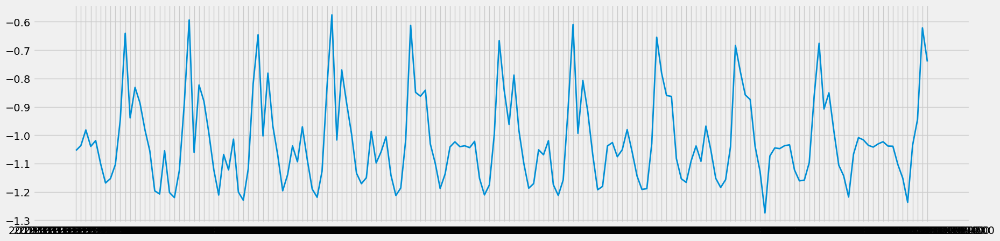

In [6]:
set_df=df[df["Set"]==1]
plt.plot(set_df["Accelerometer_y"])

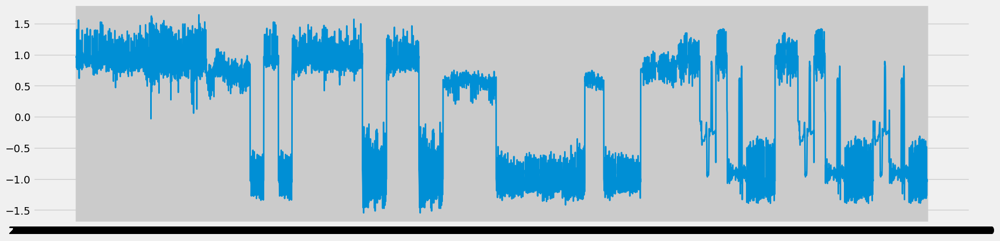

In [7]:
plt.plot(df["Accelerometer_y"])

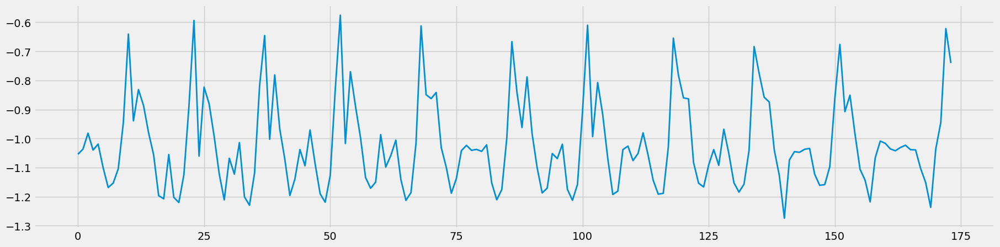

In [8]:
plt.plot(set_df["Accelerometer_y"].reset_index(drop=True))

In [9]:
df_label_unique=df["Label"].unique()
df_label_unique

array(['bench', 'ohp', 'squat', 'dead', 'row', 'rest'], dtype=object)

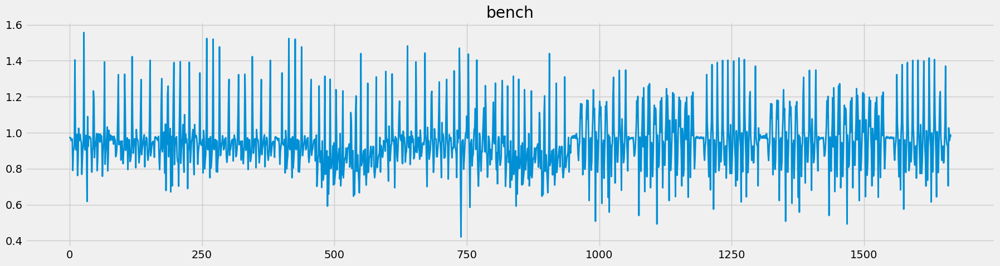

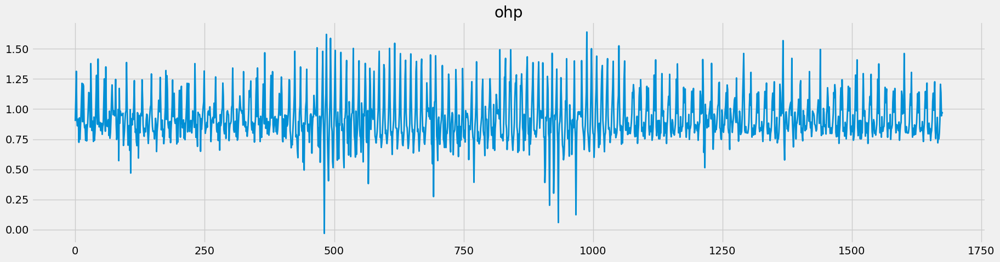

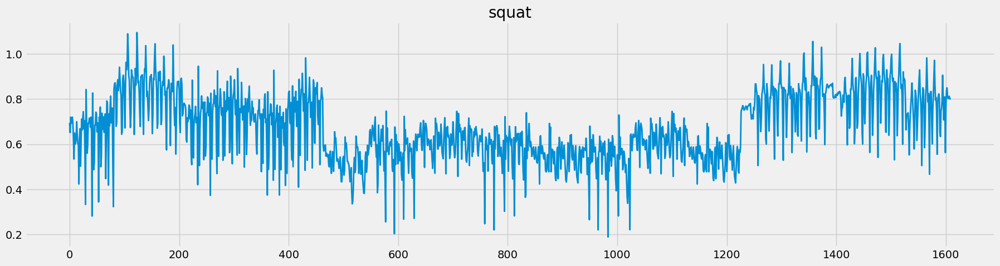

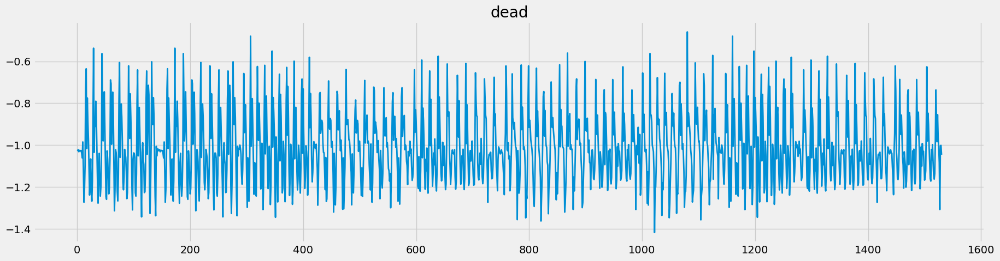

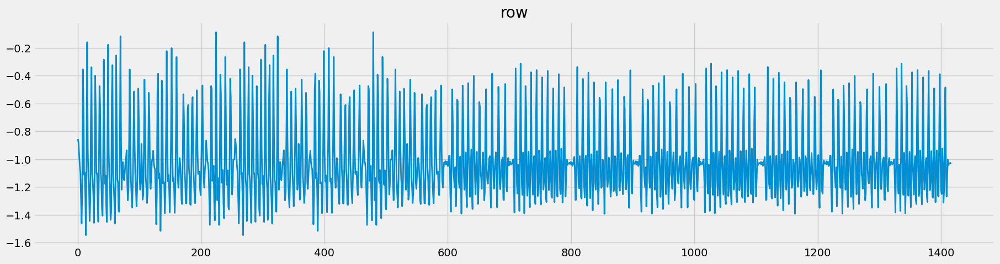

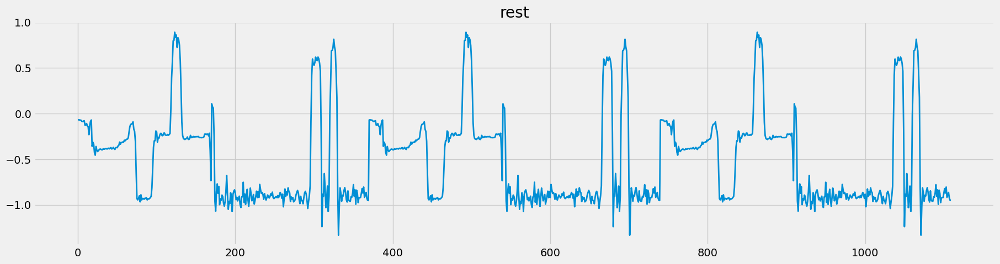

In [10]:
for label in df_label_unique:
    subset = df[df["Label"]==label]
    plt.plot(subset["Accelerometer_y"].reset_index(drop=True),label=label)
    plt.title(label=label)

    plt.show()

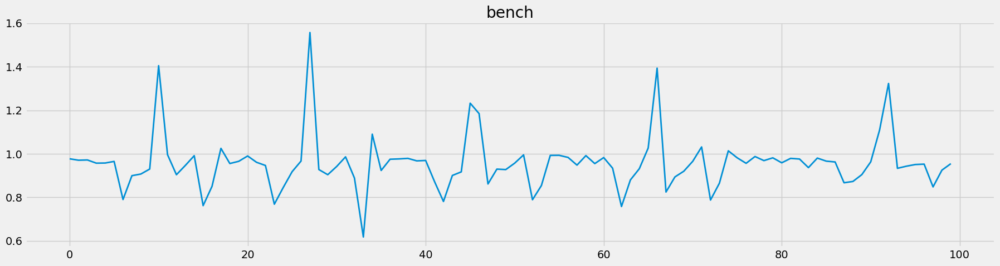

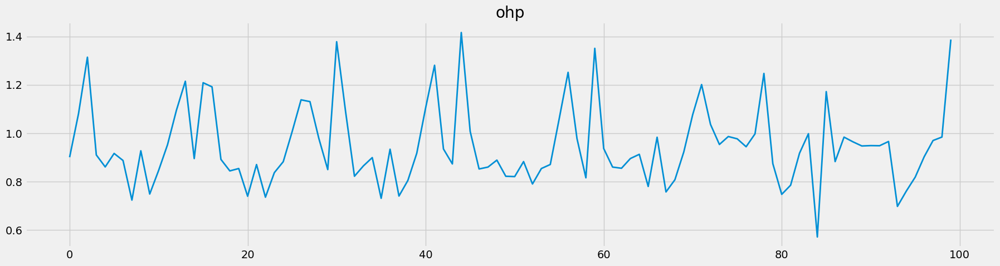

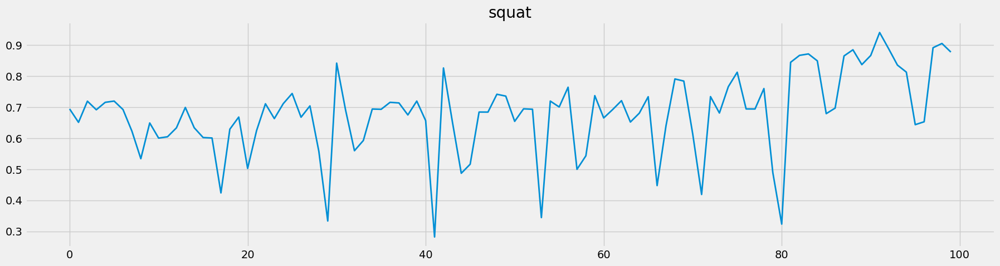

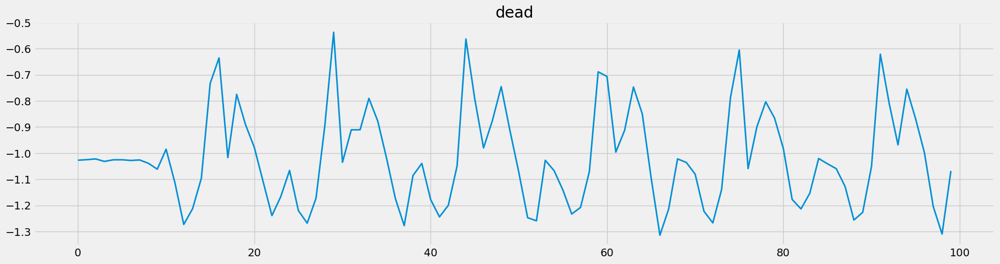

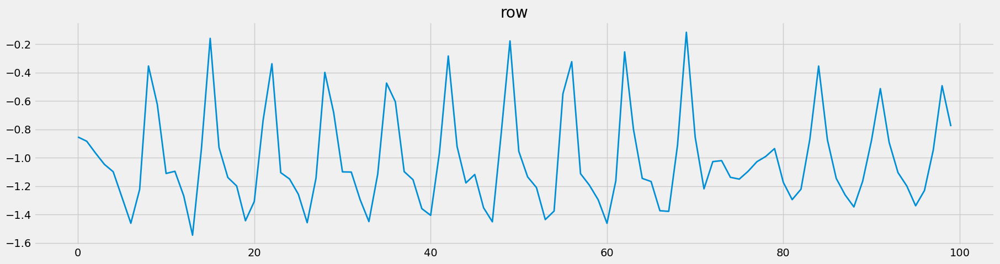

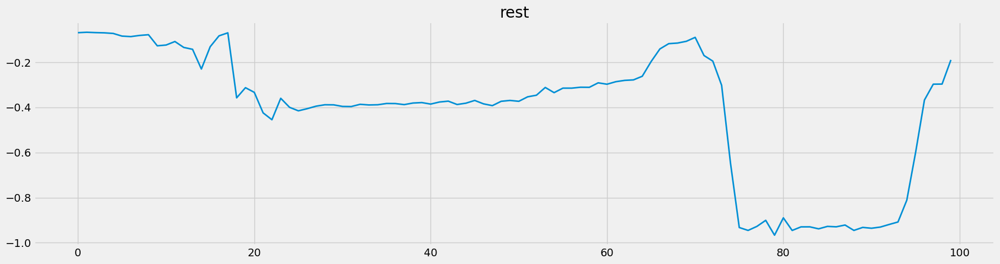

In [11]:
for label in df_label_unique:
    subset = df[df["Label"]==label]
    plt.title(label=label)
    plt.plot(subset[:100]["Accelerometer_y"].reset_index(drop=True),label=label)
    plt.show()

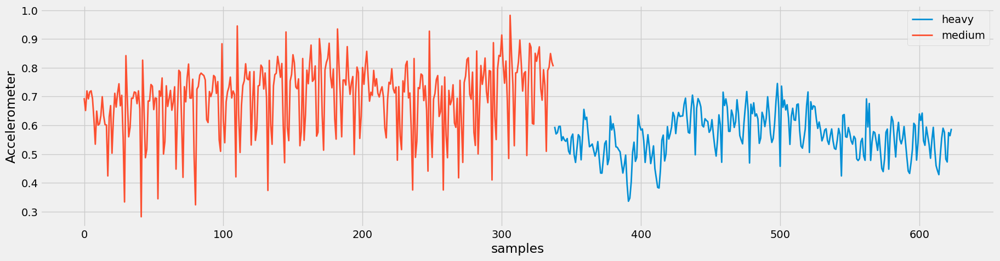

In [12]:
catogory_df=df.query("Label=='squat'").query("Participants=='A'").reset_index()

fig,ax=plt.subplots()
catogory_df.groupby(["Category"])["Accelerometer_y"].plot()
ax.set_ylabel("Accelerometer")
ax.set_xlabel("samples")
plt.legend()


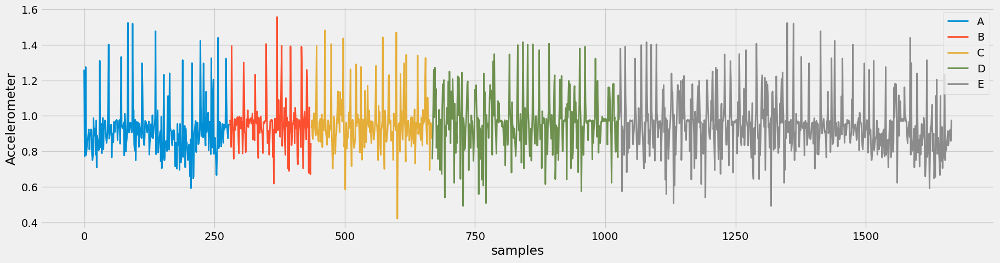

In [13]:
Participants_df=df.query("Label=='bench'").sort_values("Participants").reset_index()

fig,ax=plt.subplots()
Participants_df.groupby(["Participants"])["Accelerometer_y"].plot()
ax.set_ylabel("Accelerometer")
ax.set_xlabel("samples")
plt.legend()


C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\2291693333.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig,ax=plt.subplots()


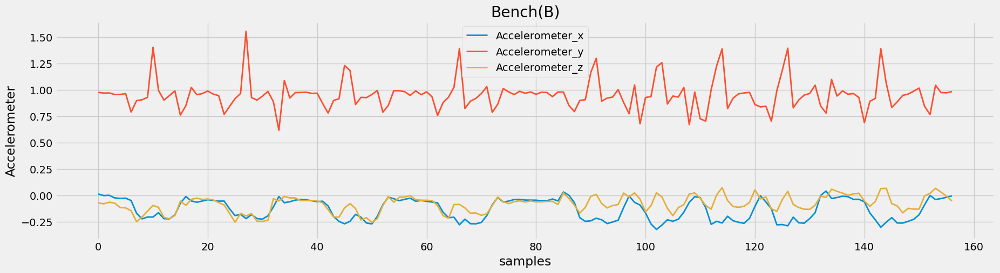

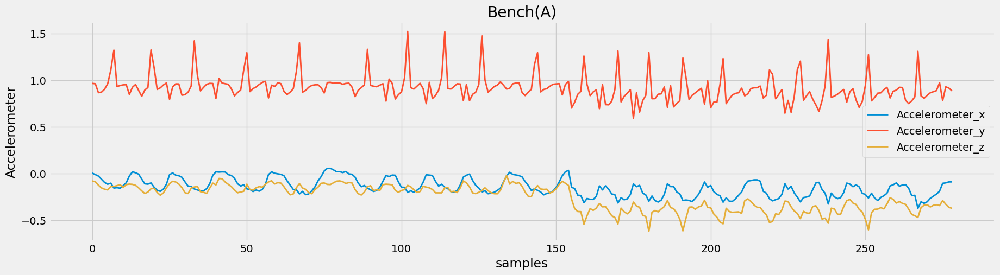

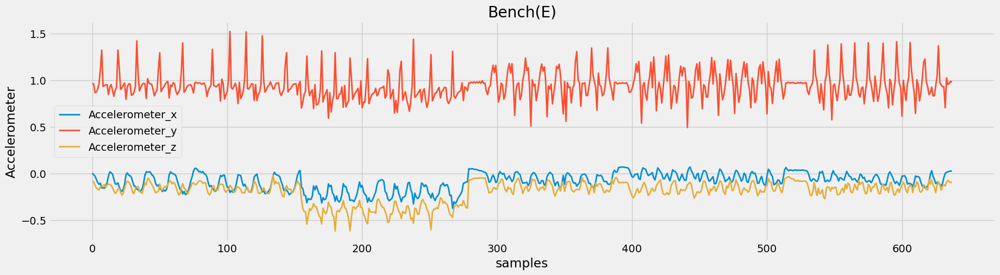

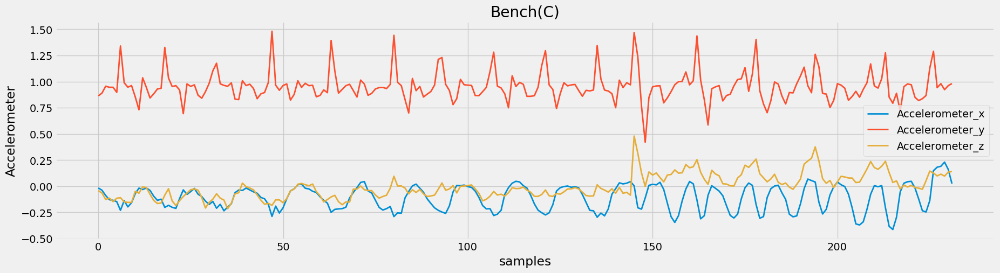

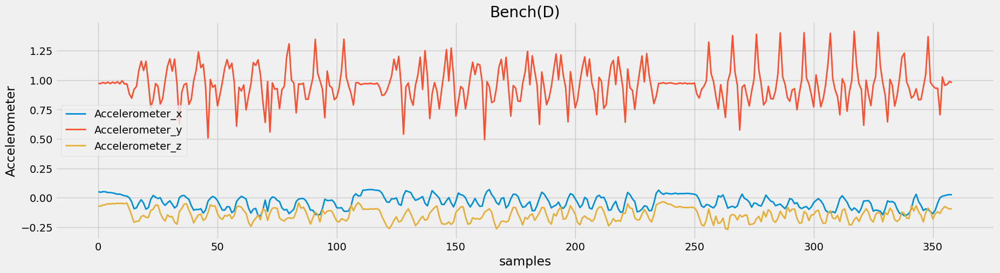

...

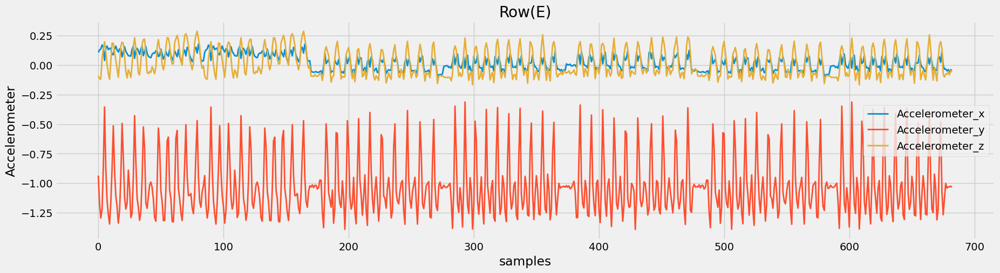

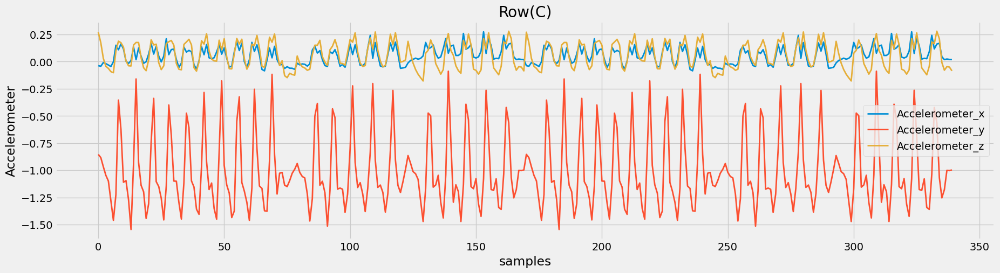

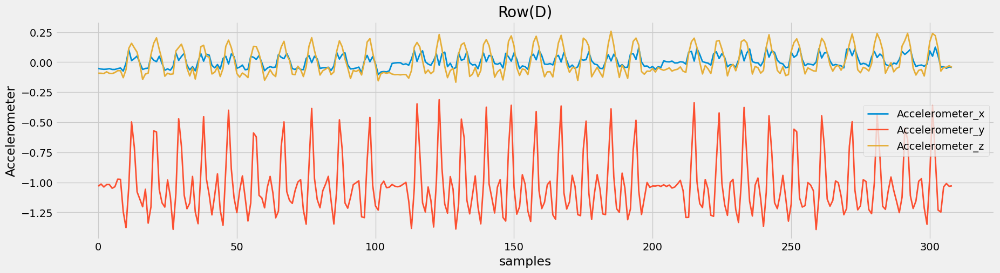

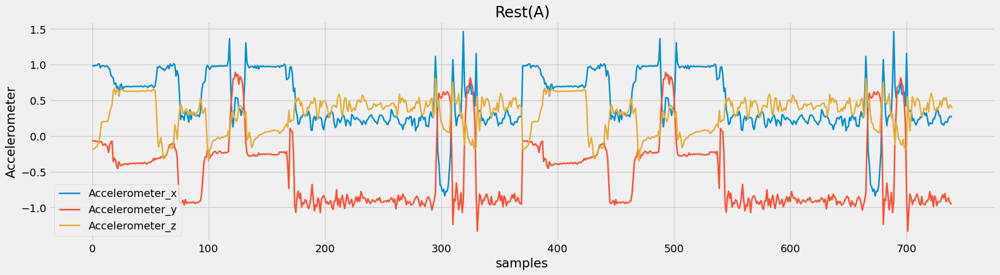

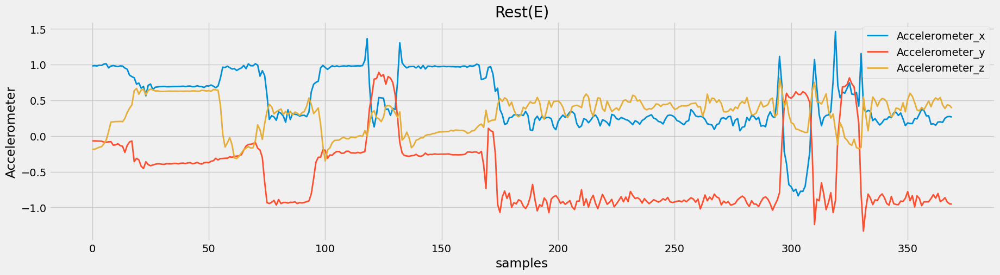

In [14]:
labels=df["Label"].unique()
participants=df["Participants"].unique()

for label in labels:
    for participant in participants:
        all_axis_df=df.query(f"Label=='{label}'").query(f"Participants=='{participant}'").reset_index()


        if len(all_axis_df)!=0:
            fig,ax=plt.subplots()
            all_axis_df[["Accelerometer_x","Accelerometer_y","Accelerometer_z"]].plot(ax=ax)
            ax.set_ylabel("Accelerometer")
            ax.set_xlabel("samples")
            plt.title(f"{label}({participant})".title())
            plt.legend()

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\3244391225.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig,ax=plt.subplots()


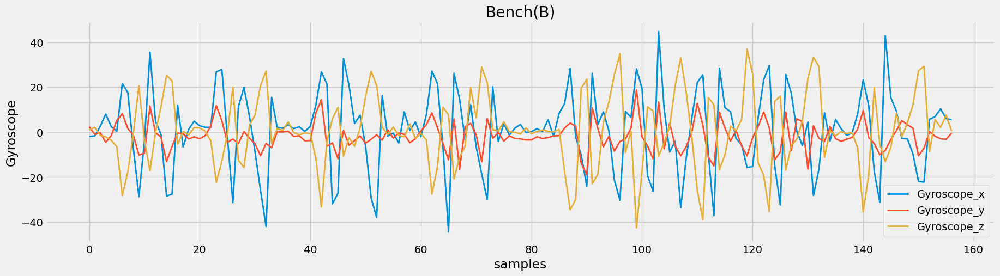

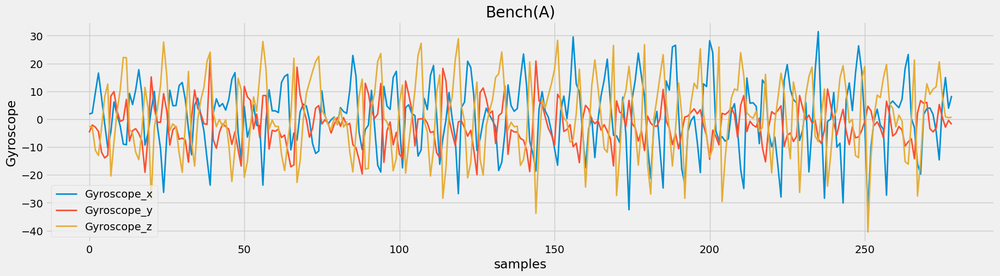

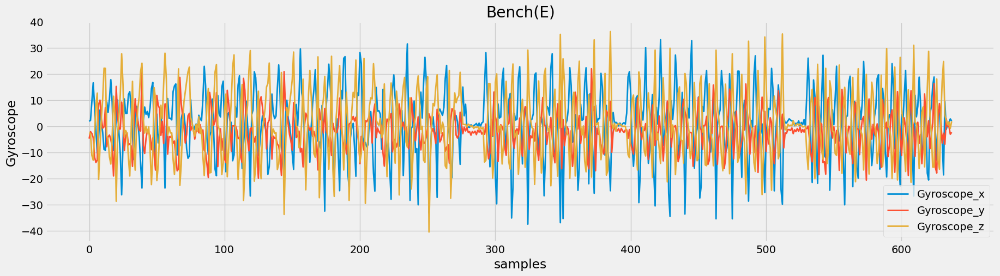

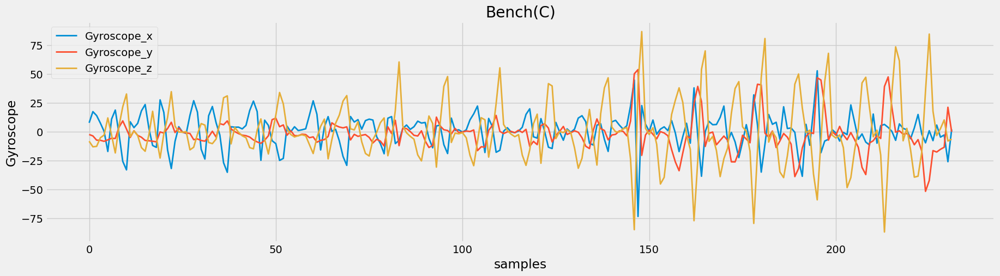

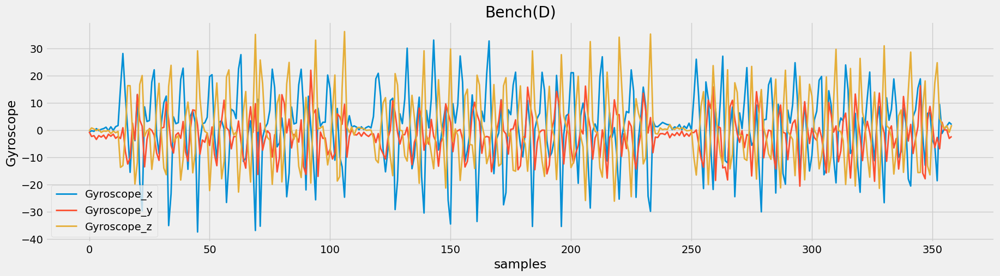

...

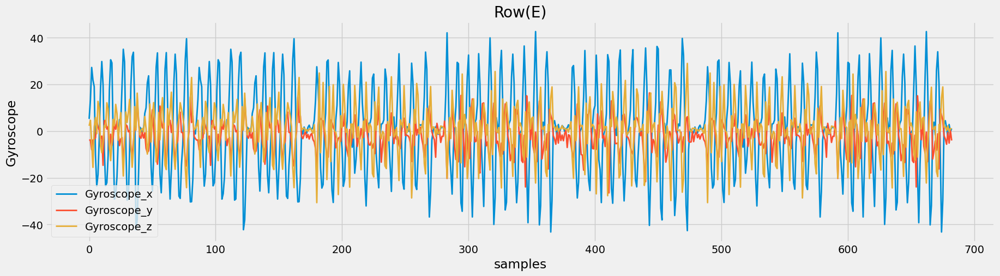

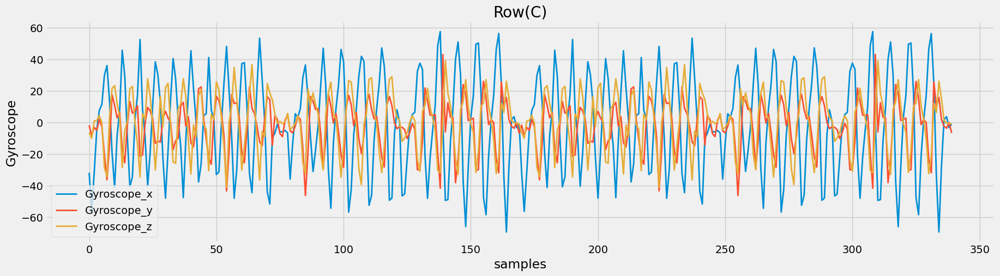

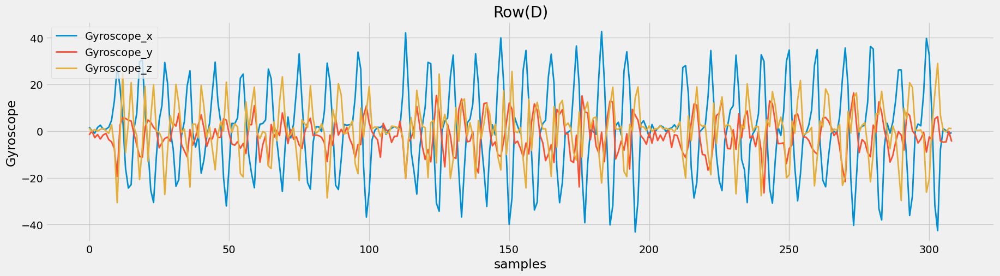

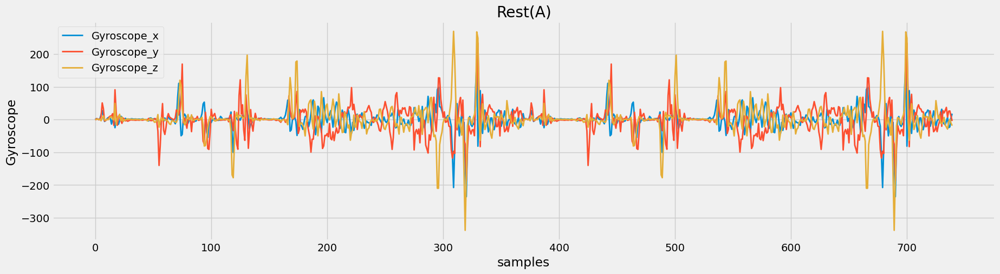

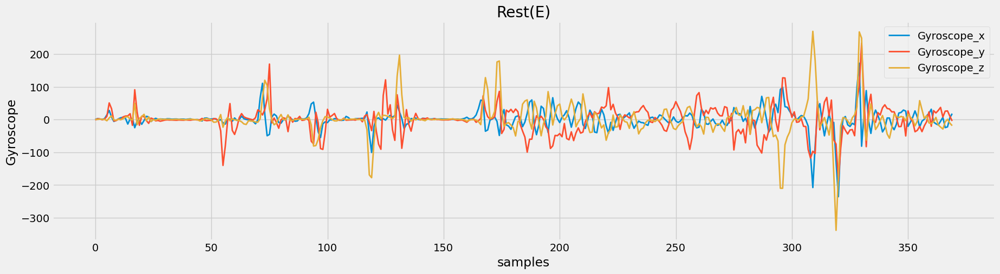

In [15]:
labels=df["Label"].unique()
participants=df["Participants"].unique()

for label in labels:
    for participant in participants:
        all_axis_df=df.query(f"Label=='{label}'").query(f"Participants=='{participant}'").reset_index()


        if len(all_axis_df)!=0:
            fig,ax=plt.subplots()
            all_axis_df[["Gyroscope_x","Gyroscope_y","Gyroscope_z"]].plot(ax=ax)
            ax.set_ylabel("Gyroscope")
            ax.set_xlabel("samples")
            plt.title(f"{label}({participant})".title())
            plt.legend()

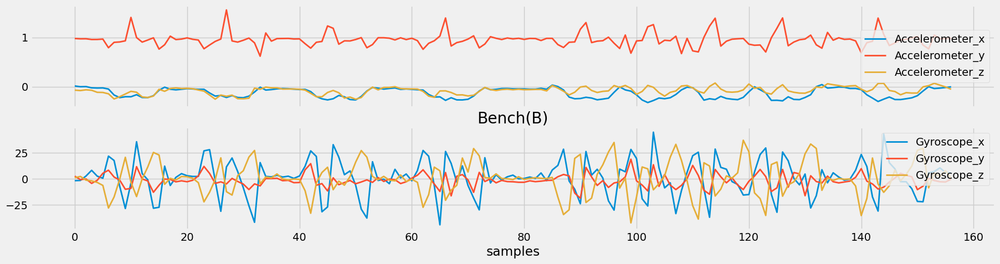

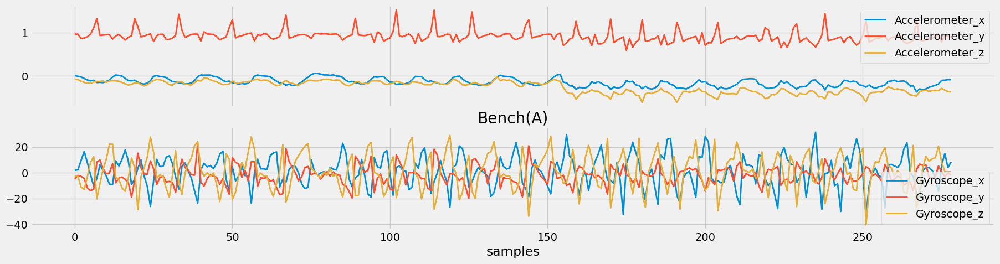

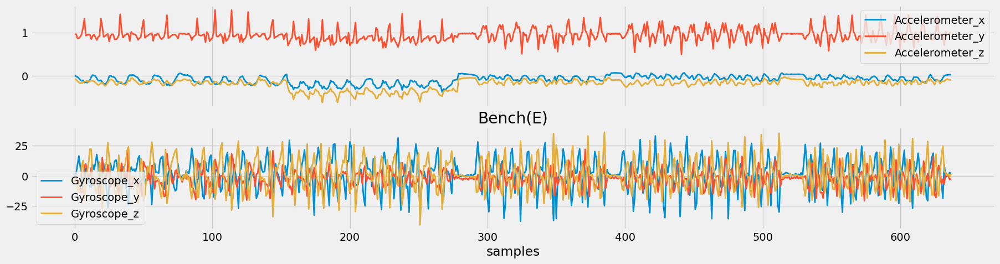

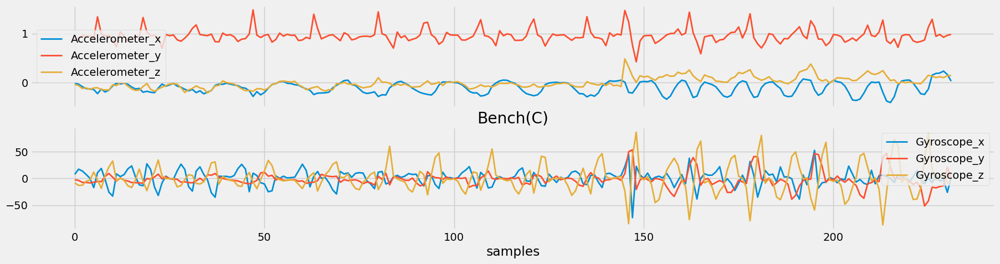

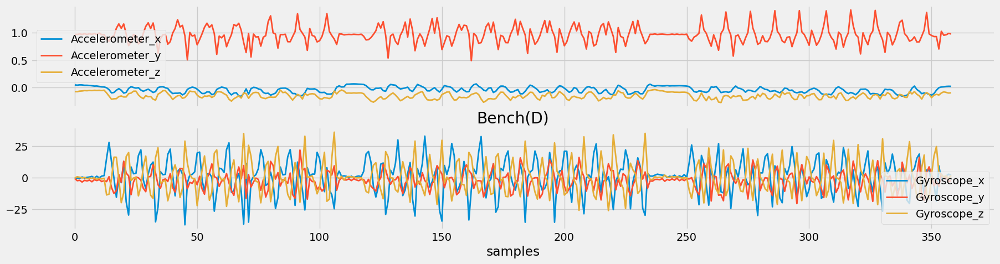

...

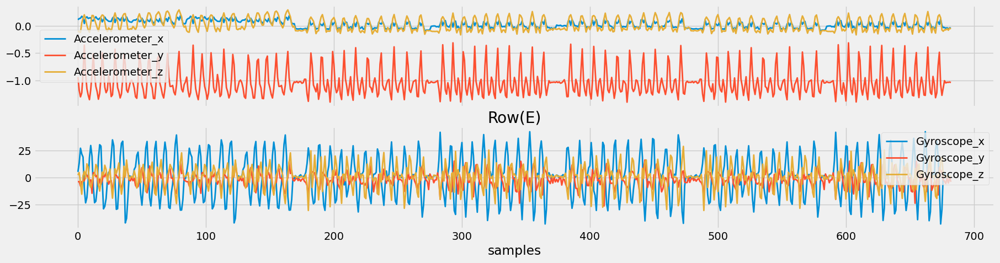

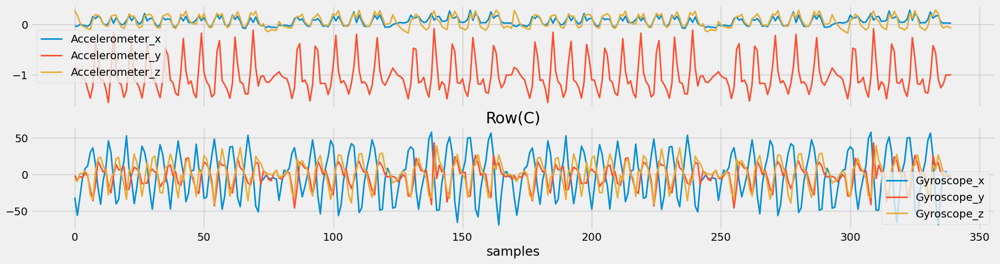

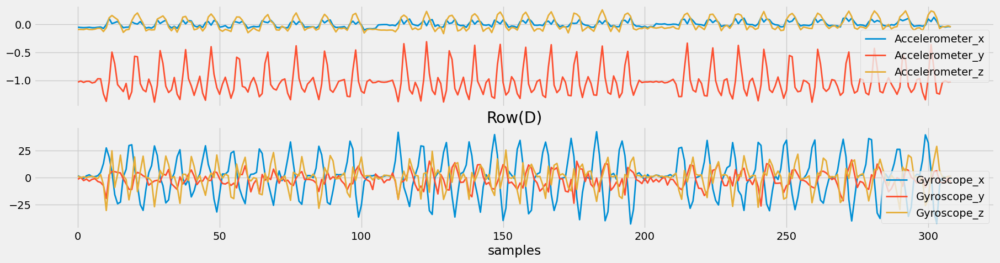

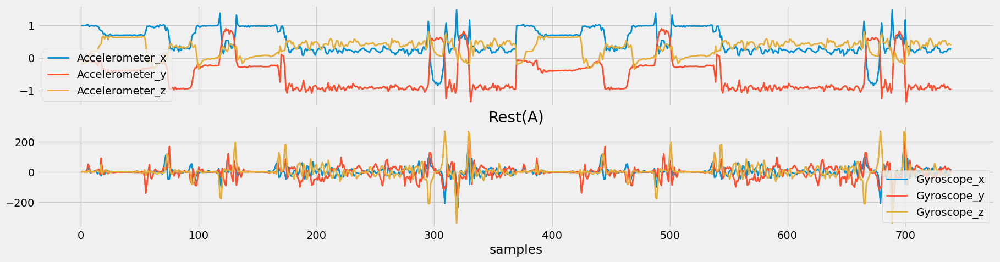

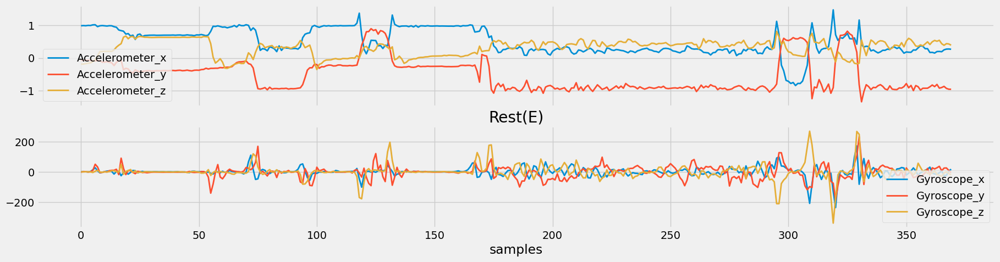

In [16]:
labels=df["Label"].unique()
participants=df["Participants"].unique()

for label in labels:
    for participant in participants:
        com_plot_df=df.query(f"Label=='{label}'").query(f"Participants=='{participant}'").reset_index()


        if len(com_plot_df)!=0:

            fig,ax=plt.subplots(nrows=2,sharex=True)
            com_plot_df[["Accelerometer_x","Accelerometer_y","Accelerometer_z"]].plot(ax=ax[0])
            com_plot_df[["Gyroscope_x","Gyroscope_y","Gyroscope_z"]].plot(ax=ax[1])
            ax[1].set_xlabel("samples")
            ax[0].legend()
            ax[1].legend()    
            plt.title(f"{label.title()}({participant})")
            plt.show()

# **Remove Outliers**

array([<Axes: title={'center': 'Gyroscope_x'}, xlabel='[Label]'>,
       <Axes: title={'center': 'Gyroscope_y'}, xlabel='[Label]'>,
       <Axes: title={'center': 'Gyroscope_z'}, xlabel='[Label]'>],
      dtype=object)

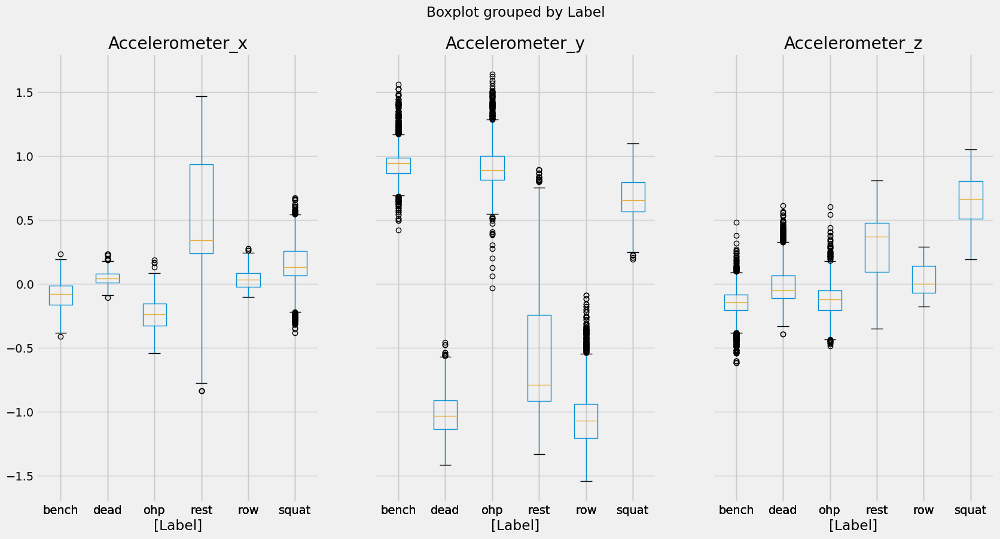

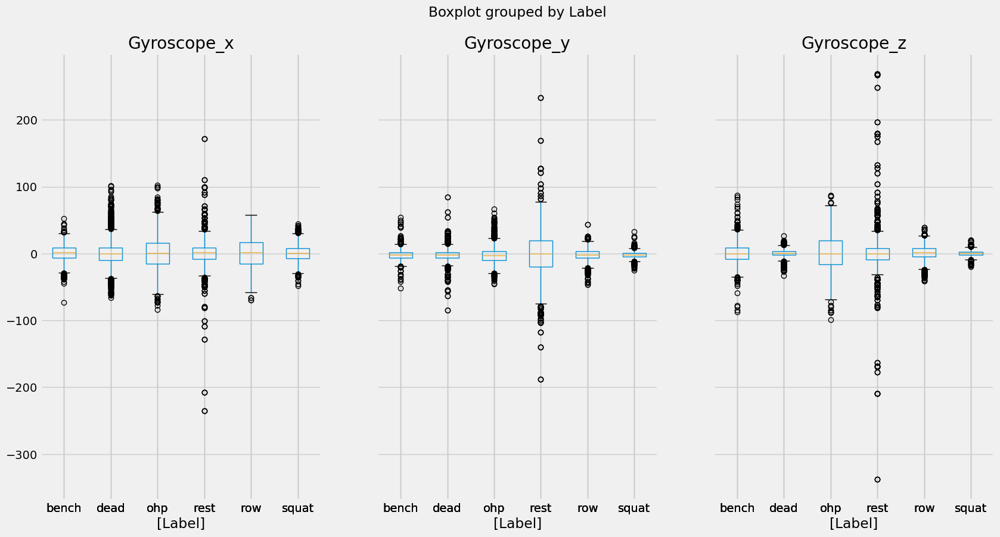

In [17]:
outlier_col=list(df.columns[:6])
df[outlier_col[:3]+["Label"]].boxplot(by="Label",figsize=(20,10),layout=(1,3))
df[outlier_col[3:6]+["Label"]].boxplot(by="Label",figsize=(20,10),layout=(1,3))

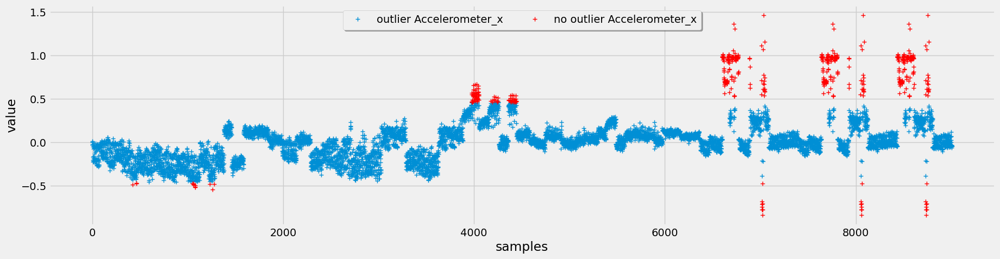

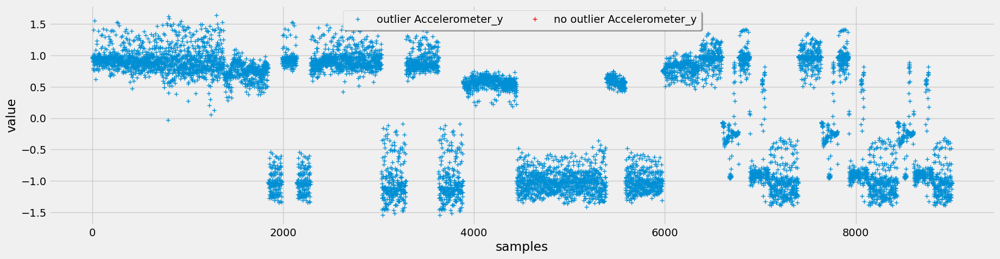

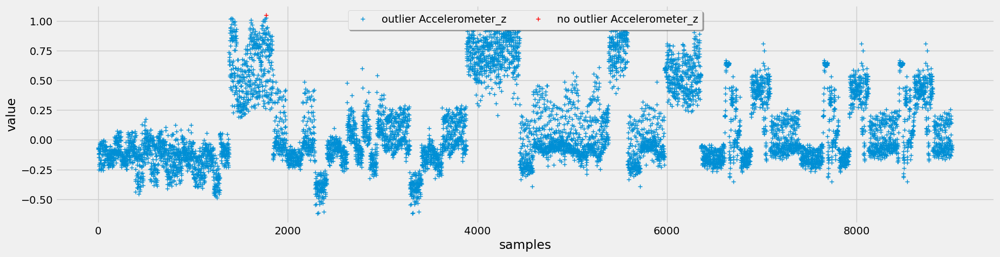

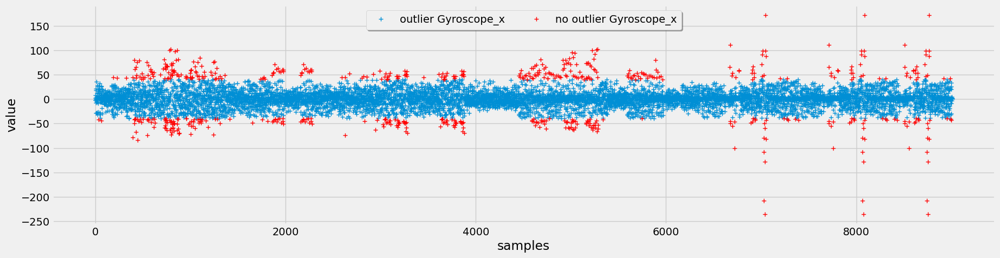

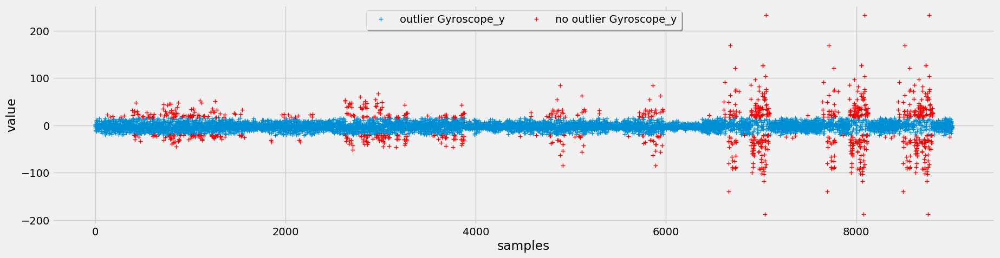

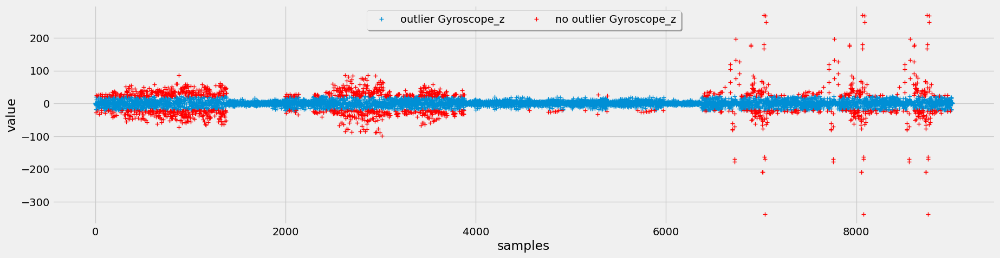

In [18]:
for col in outlier_col:
    dataset=mark_outliers_iqr(df,col)
    plot_binary_outliers(dataset,col,col+"_outlier",True)

array([[<Axes: title={'center': 'bench'}, ylabel='Frequency'>,
        <Axes: title={'center': 'dead'}, ylabel='Frequency'>,
        <Axes: title={'center': 'ohp'}, ylabel='Frequency'>],
       [<Axes: title={'center': 'rest'}, ylabel='Frequency'>,
        <Axes: title={'center': 'row'}, ylabel='Frequency'>,
        <Axes: title={'center': 'squat'}, ylabel='Frequency'>],
       [<Axes: ylabel='Frequency'>, <Axes: ylabel='Frequency'>,
        <Axes: ylabel='Frequency'>]], dtype=object)

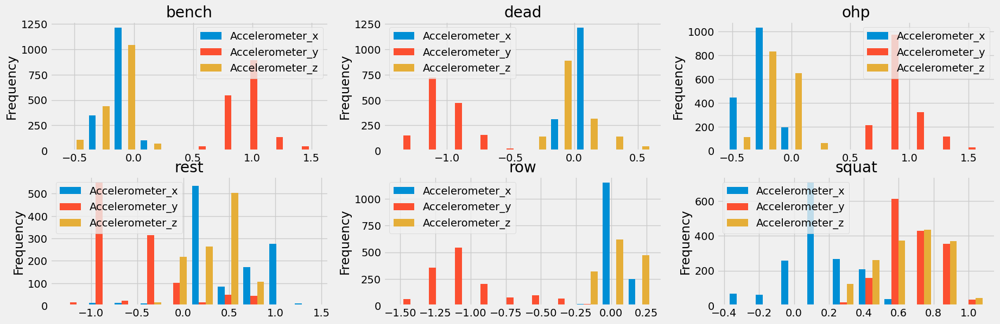

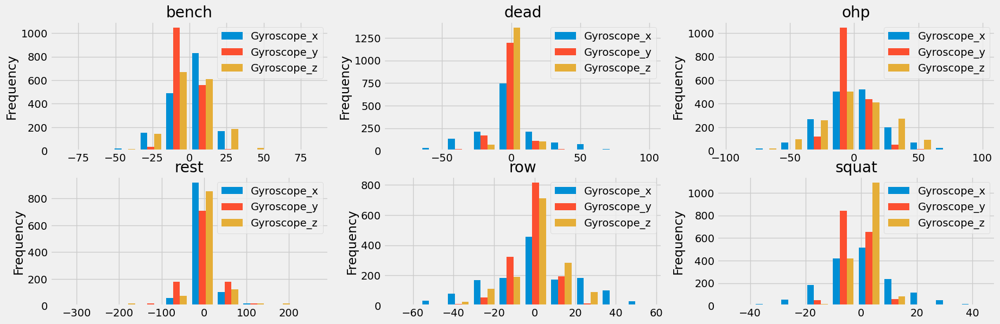

In [19]:
df[outlier_col[:3]+["Label"]].plot.hist(by="Label",figsize=(20,10),layout=(3,3))
df[outlier_col[3:6]+["Label"]].plot.hist(by="Label",figsize=(20,10),layout=(3,3))

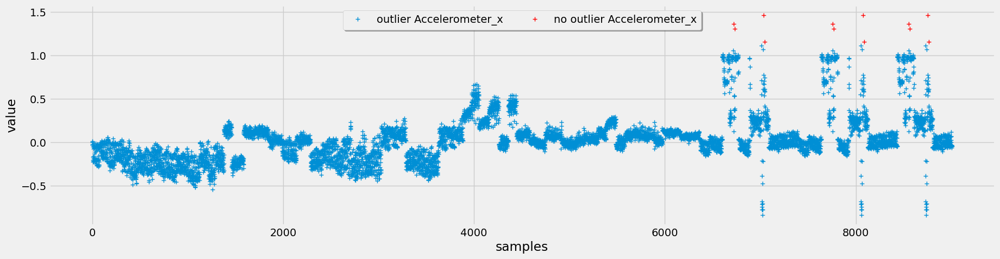

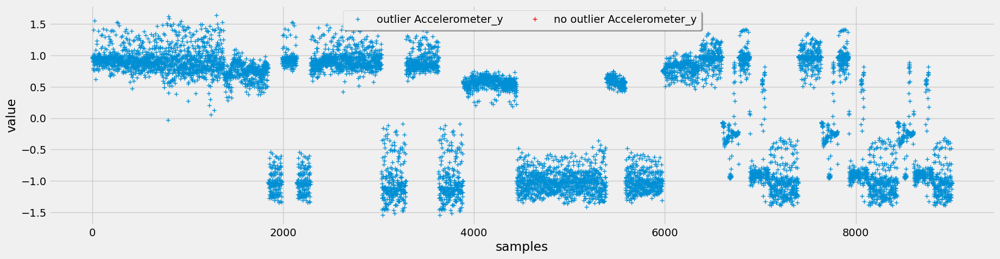

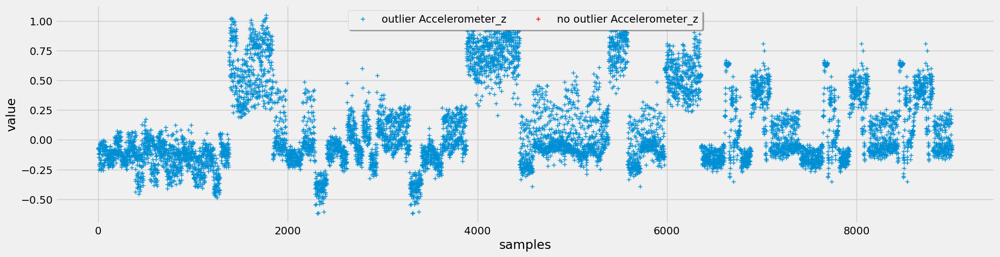

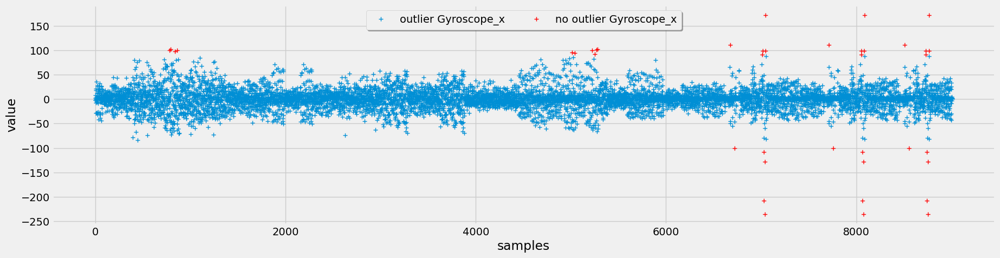

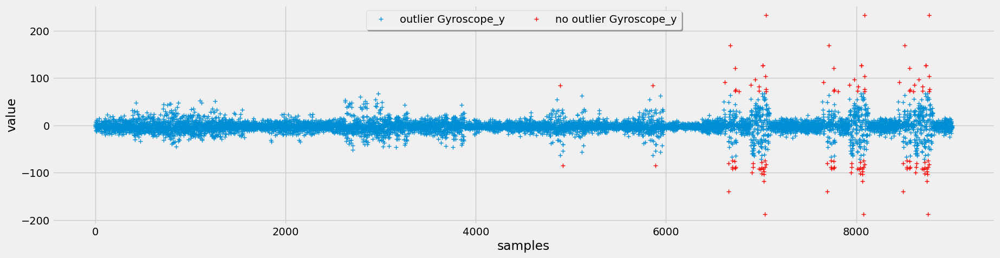

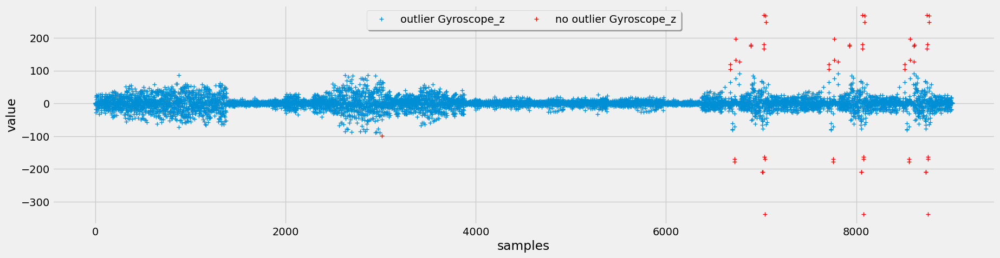

In [20]:
for col in outlier_col:
    dataset=mark_outliers_chauvenet(df,col)
    plot_binary_outliers(dataset,col,col+"_outlier",True)

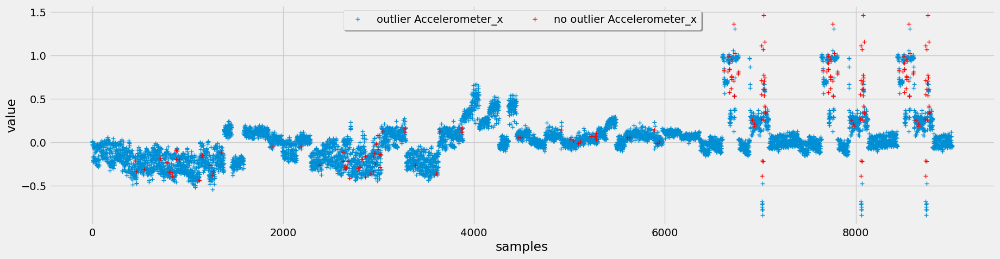

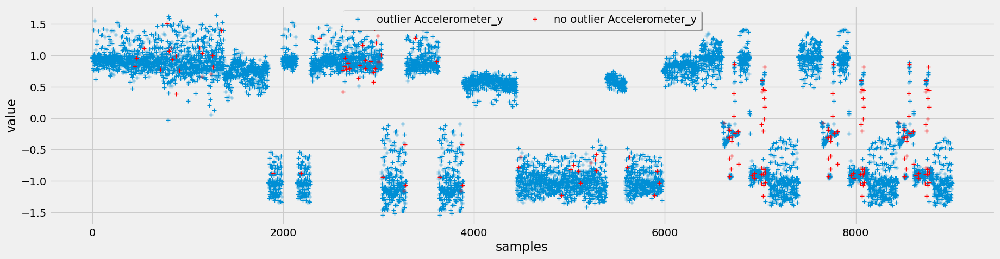

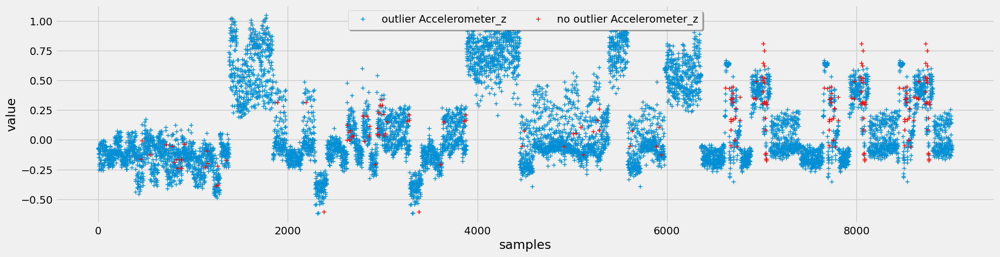

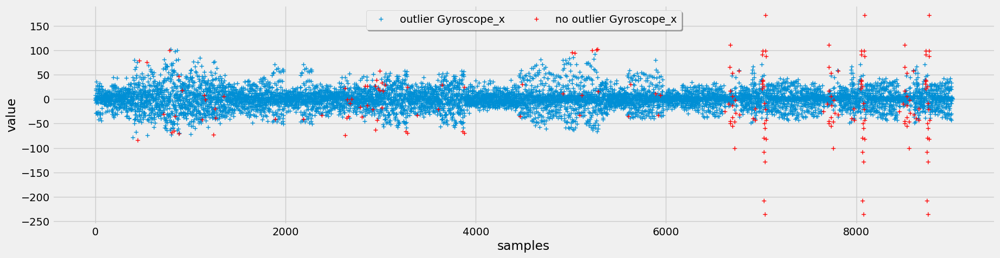

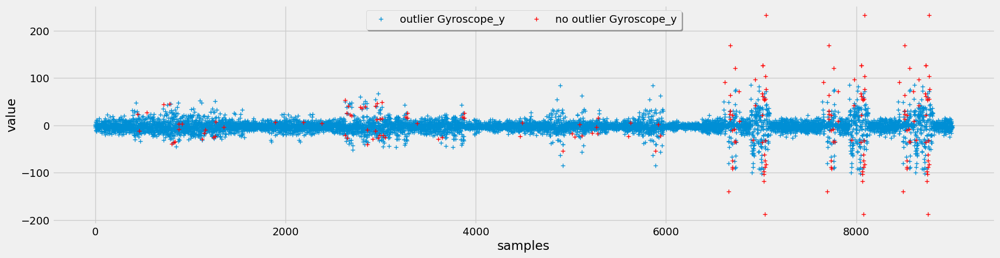

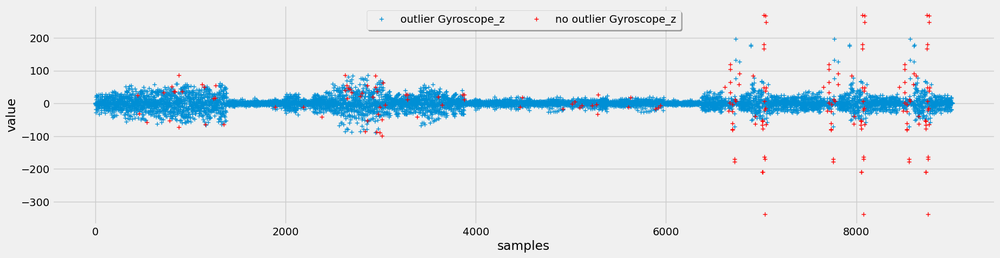

In [21]:
dataset,out,x=mark_outliers_lof(df,outlier_col)

for col in outlier_col:
    plot_binary_outliers(dataset,col,"outlier_lof",True)

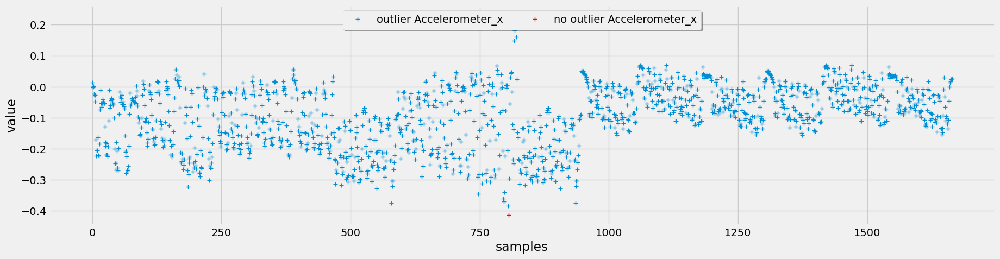

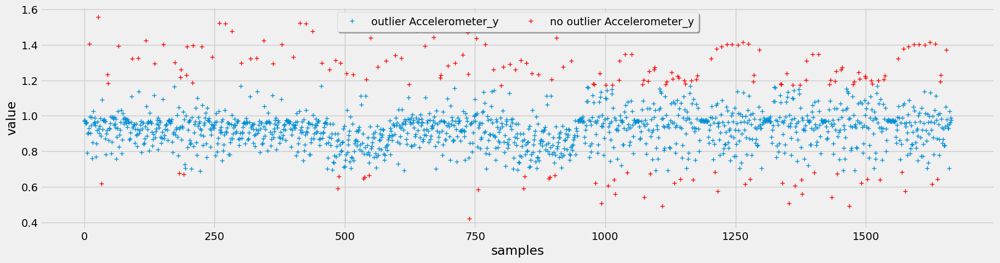

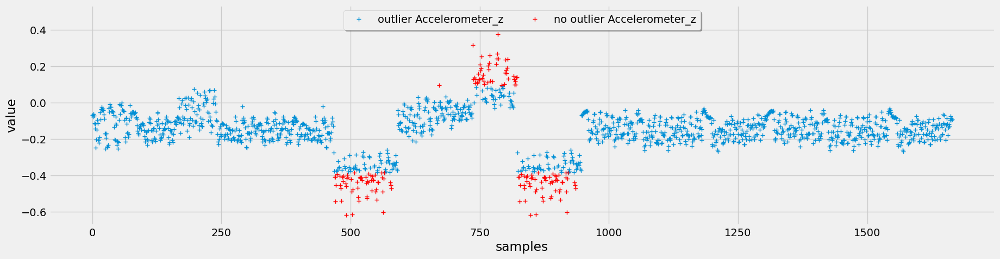

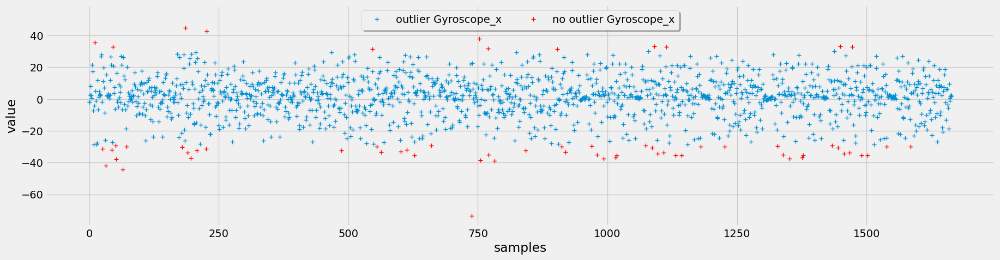

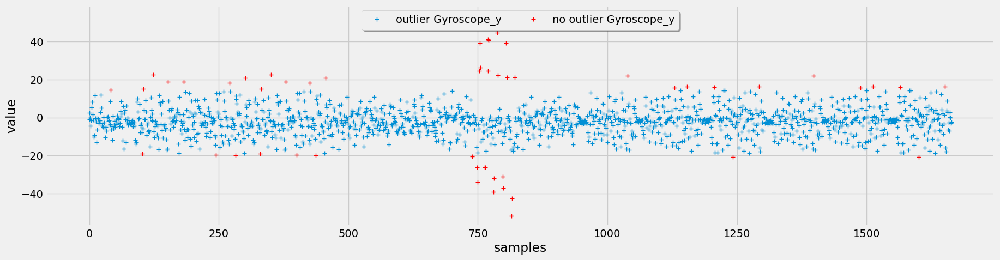

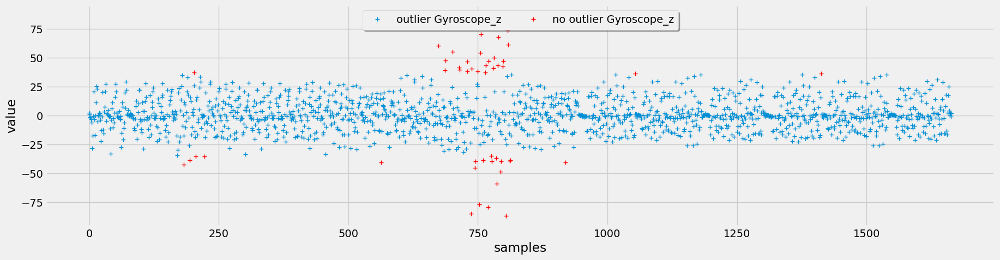

In [22]:
label="bench"
for col in outlier_col:
    dataset=mark_outliers_iqr(df[df["Label"]==label],col)
    plot_binary_outliers(dataset,col,col+"_outlier",True)

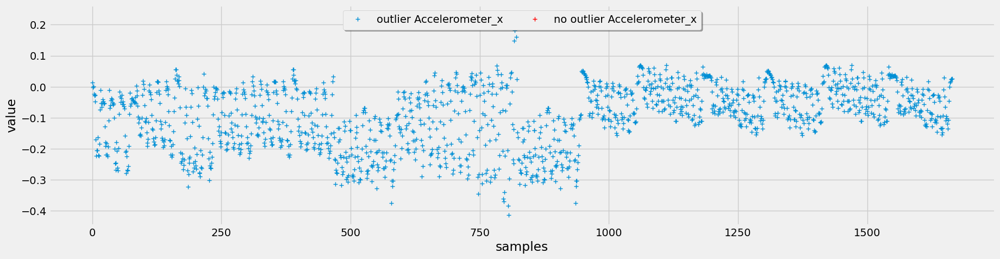

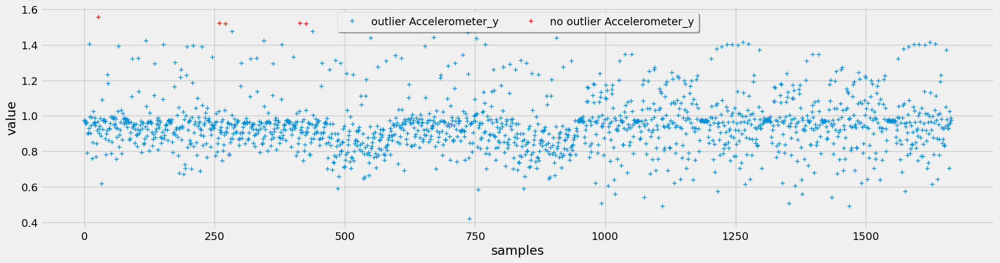

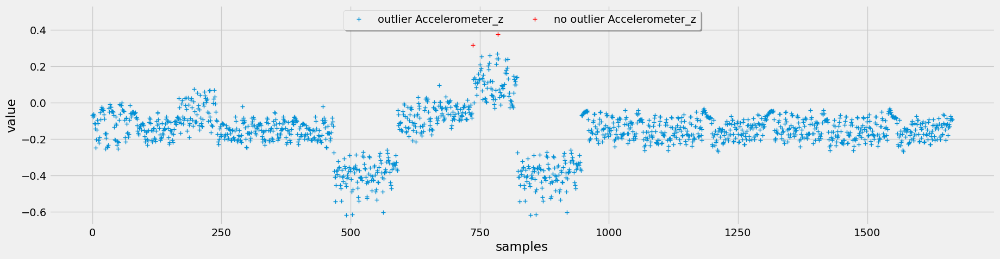

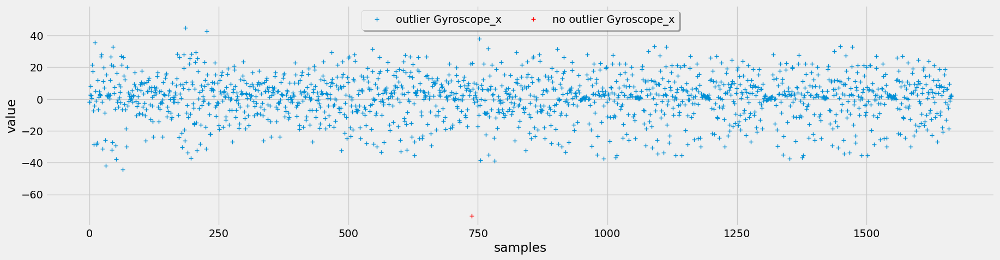

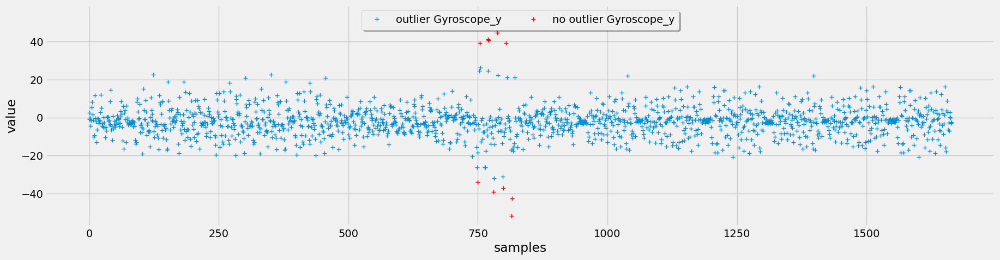

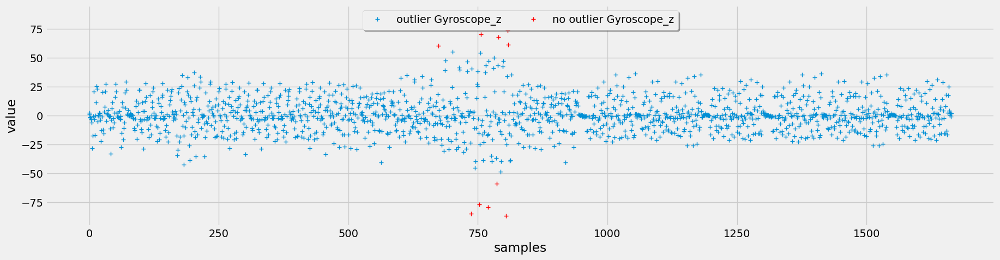

In [23]:
label="bench"
for col in outlier_col:
    dataset=mark_outliers_chauvenet(df[df["Label"]==label],col)
    plot_binary_outliers(dataset,col,col+"_outlier",True)

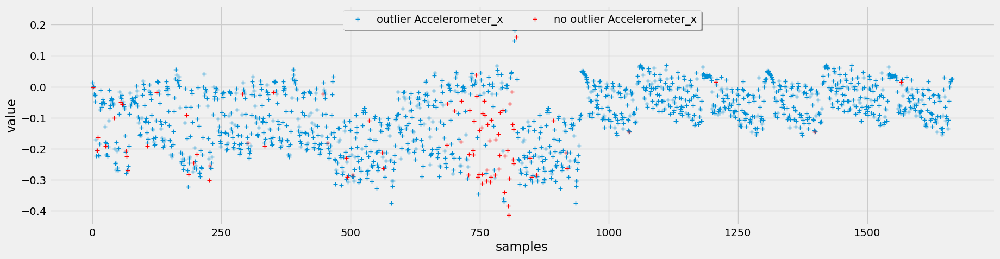

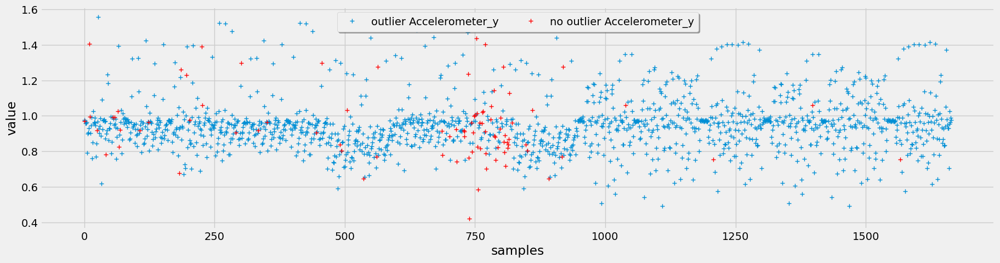

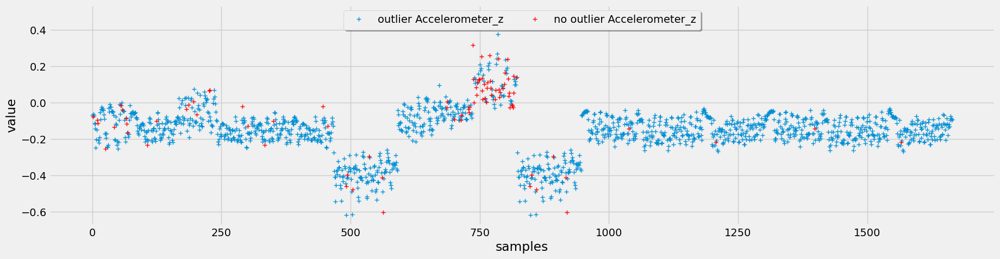

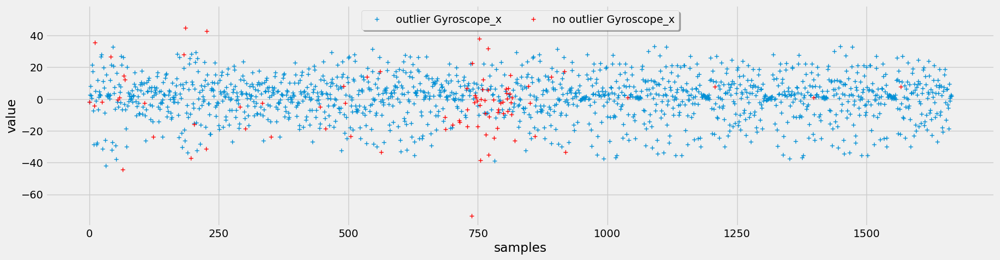

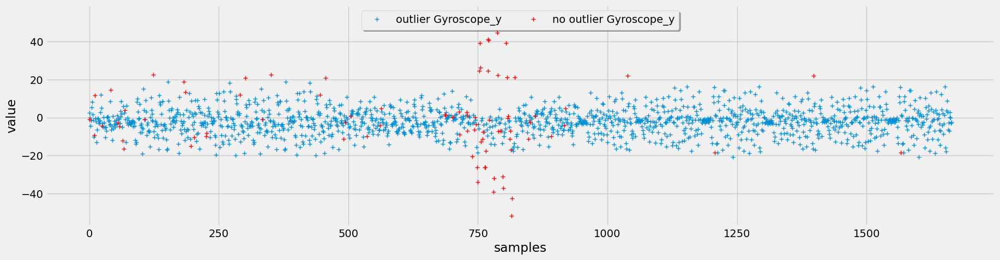

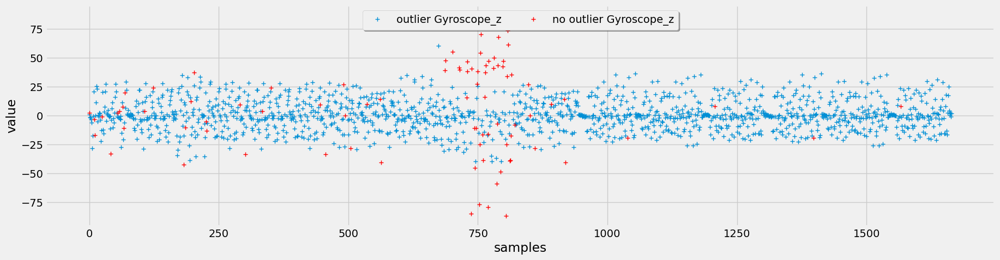

In [24]:
dataset,out,x=mark_outliers_lof(df[df["Label"]==label],outlier_col)

for col in outlier_col:
    plot_binary_outliers(dataset,col,"outlier_lof",True)

In [25]:
outlier_removed_df=df.copy()
for col in outlier_col:
    for label in df["Label"].unique():
        dataset=mark_outliers_chauvenet(df[df["Label"]==label],col)
        dataset.loc[dataset[col + "_outlier"],col]= np.nan
        outlier_removed_df.loc[(outlier_removed_df["Label"]==label),col]=dataset[col]
        n_outliers=len(df) - len(outlier_removed_df[col].dropna())
        print(f"Removed {n_outliers} from {col} for {label}")

Removed 0 from Accelerometer_x for bench
Removed 2 from Accelerometer_x for ohp
Removed 2 from Accelerometer_x for squat
Removed 4 from Accelerometer_x for dead
Removed 4 from Accelerometer_x for row
Removed 4 from Accelerometer_x for rest
Removed 5 from Accelerometer_y for bench
Removed 11 from Accelerometer_y for ohp
Removed 11 from Accelerometer_y for squat
Removed 11 from Accelerometer_y for dead
Removed 11 from Accelerometer_y for row
Removed 11 from Accelerometer_y for rest
Removed 3 from Accelerometer_z for bench
Removed 9 from Accelerometer_z for ohp
Removed 9 from Accelerometer_z for squat
Removed 10 from Accelerometer_z for dead
Removed 10 from Accelerometer_z for row
Removed 10 from Accelerometer_z for rest
Removed 2 from Gyroscope_x for bench
Removed 6 from Gyroscope_x for ohp
Removed 7 from Gyroscope_x for squat
Removed 13 from Gyroscope_x for dead
Removed 13 from Gyroscope_x for row
Removed 25 from Gyroscope_x for rest
Removed 14 from Gyroscope_y for bench
Removed 29 from

In [26]:
outlier_removed_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 9009 entries, 2019-01-11 15:08:05.200 to 2019-01-20 17:33:27.800
Data columns (total 10 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Accelerometer_x  9005 non-null   float64
 1   Accelerometer_y  8998 non-null   float64
 2   Accelerometer_z  8999 non-null   float64
 3   Gyroscope_x      8984 non-null   float64
 4   Gyroscope_y      8938 non-null   float64
 5   Gyroscope_z      8945 non-null   float64
 6   Participants     9009 non-null   object 
 7   Label            9009 non-null   object 
 8   Category         9009 non-null   object 
 9   Set              9009 non-null   int64  
dtypes: float64(6), int64(1), object(3)
memory usage: 774.2+ KB


In [27]:
df=outlier_removed_df
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 9009 entries, 2019-01-11 15:08:05.200 to 2019-01-20 17:33:27.800
Data columns (total 10 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Accelerometer_x  9005 non-null   float64
 1   Accelerometer_y  8998 non-null   float64
 2   Accelerometer_z  8999 non-null   float64
 3   Gyroscope_x      8984 non-null   float64
 4   Gyroscope_y      8938 non-null   float64
 5   Gyroscope_z      8945 non-null   float64
 6   Participants     9009 non-null   object 
 7   Label            9009 non-null   object 
 8   Category         9009 non-null   object 
 9   Set              9009 non-null   int64  
dtypes: float64(6), int64(1), object(3)
memory usage: 774.2+ KB


# **Feature Engineering**

In [28]:
pridictor_col=list(df.columns[:6])
for col in pridictor_col:
    df[col] = df[col].interpolate()

df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 9009 entries, 2019-01-11 15:08:05.200 to 2019-01-20 17:33:27.800
Data columns (total 10 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Accelerometer_x  9009 non-null   float64
 1   Accelerometer_y  9009 non-null   float64
 2   Accelerometer_z  9009 non-null   float64
 3   Gyroscope_x      9009 non-null   float64
 4   Gyroscope_y      9009 non-null   float64
 5   Gyroscope_z      9009 non-null   float64
 6   Participants     9009 non-null   object 
 7   Label            9009 non-null   object 
 8   Category         9009 non-null   object 
 9   Set              9009 non-null   int64  
dtypes: float64(6), int64(1), object(3)
memory usage: 774.2+ KB


In [29]:

# Step 1: Ensure the index is in datetime format
df.index = pd.to_datetime(df.index)

# Step 2: Calculate the duration for Set 1
if df[df["Set"] == 1].shape[0] > 0:  # Check if there are any entries for Set 1
    start_time = df[df["Set"] == 1].index[0]  # Start time for Set 1
    end_time = df[df["Set"] == 1].index[-1]   # End time for Set 1
    duration = end_time - start_time  # Calculate duration
    print(f"Duration in seconds: {duration.total_seconds()}")  # Print total seconds
else:
    print("No entries found for Set 1.")

Duration in seconds: 34.6


In [30]:
for s in df["Set"].unique():
    duration=df[df["Set"]==s].index[-1] - df[df["Set"]==s].index[0]
    df.loc[(df["Set"]==s),"Duration"]=duration.seconds

df

,Accelerometer_x,Accelerometer_y,Accelerometer_z,Gyroscope_x,Gyroscope_y,Gyroscope_z,Participants,Label,Category,Set,Duration
epoch (ms),,,,,,,,,,,
2019-01-11 15:08:05.200,0.013500,0.977000,-0.071000,-1.8904,2.4392,0.9388,B,bench,heavy,30,16.0
2019-01-11 15:08:05.400,-0.001500,0.970500,-0.079500,-1.6826,-0.8904,2.1708,B,bench,heavy,30,16.0
2019-01-11 15:08:05.600,0.001333,0.971667,-0.064333,2.5608,-0.2560,-1.4146,B,bench,heavy,30,16.0
2019-01-11 15:08:05.800,-0.024000,0.957000,-0.073500,8.0610,-4.5244,-2.0730,B,bench,heavy,30,16.0
2019-01-11 15:08:06.000,-0.028000,0.957667,-0.115000,2.4390,-1.5486,-3.6098,B,bench,heavy,30,16.0
...,...,...,...,...,...,...,...,...,...,...,...
2019-01-20 17:33:27.000,-0.048000,-1.041500,-0.076500,1.4146,-5.6218,0.2926,E,row,medium,40,19.0
2019-01-20 17:33:27.200,-0.037000,-1.030333,-0.053333,-2.7684,-0.5854,2.2440,E,row,medium,40,19.0
2019-01-20 17:33:27.400,-0.060000,-1.031000,-0.082000,2.8416,-5.1342,-0.1220,E,row,medium,40,19.0


In [31]:
duration_df=df.groupby(["Category"])["Duration"].mean()
duration_df

Category
heavy       14.743501
medium      24.942529
sitting     33.000000
standing    39.000000
Name: Duration, dtype: float64

,Accelerometer_x,Accelerometer_y,Accelerometer_z,Gyroscope_x,Gyroscope_y,Gyroscope_z,Participants,Label,Category,Set,Duration
epoch (ms),,,,,,,,,,,
2019-01-11 15:08:05.200,0.013494,0.977001,-0.070995,-1.896395,2.439080,0.939616,B,bench,heavy,30,16.0
2019-01-11 15:08:05.400,0.006869,0.970257,-0.067545,2.129685,0.528678,-1.248135,B,bench,heavy,30,16.0
2019-01-11 15:08:05.600,-0.009603,0.963589,-0.073447,4.151973,-2.092258,-0.929804,B,bench,heavy,30,16.0
2019-01-11 15:08:05.800,-0.022998,0.965441,-0.083731,2.074477,-3.626288,0.880509,B,bench,heavy,30,16.0
2019-01-11 15:08:06.000,-0.020032,0.966784,-0.093783,1.041930,-1.219897,-2.260590,B,bench,heavy,30,16.0
...,...,...,...,...,...,...,...,...,...,...,...
2019-01-20 17:33:27.000,-0.045056,-0.974791,-0.061752,3.273522,-4.487268,0.133850,E,row,medium,40,19.0
2019-01-20 17:33:27.200,-0.042806,-1.020916,-0.057715,-2.514546,-2.449224,1.255524,E,row,medium,40,19.0
2019-01-20 17:33:27.400,-0.047074,-1.051656,-0.066326,-0.673530,-1.799975,1.193779,E,row,medium,40,19.0


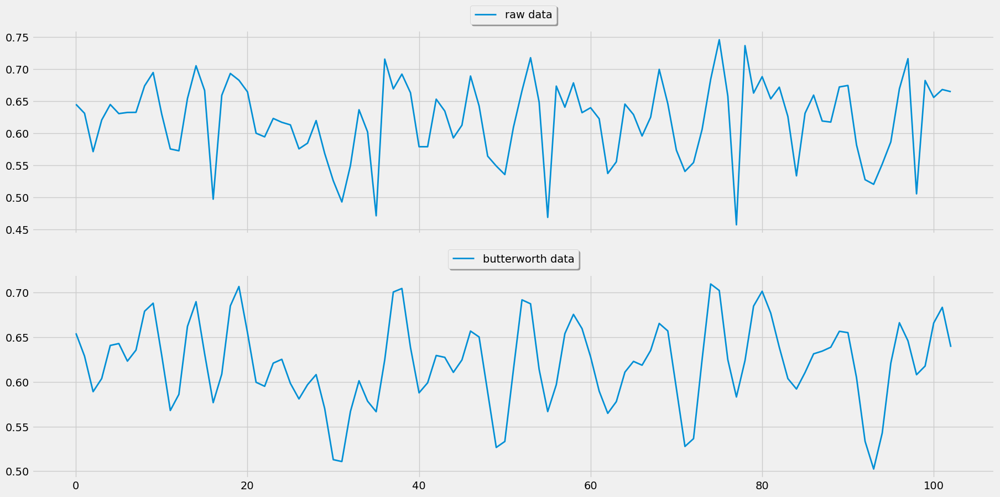

In [32]:
df_lowpass=df.copy()

LowPass=LowPassFilter()
fs=1000/200
cutoff=1.2


df_lowpass=LowPass.low_pass_filter(df_lowpass,"Accelerometer_y",fs,cutoff,order=5)
subset=df_lowpass[df_lowpass["Set"]==45]
fig,ax=plt.subplots(nrows=2,sharex=True,figsize=(20,10))
ax[0].plot(subset["Accelerometer_y"].reset_index(drop=True),label="raw data")
ax[1].plot(subset["Accelerometer_y_lowpass"].reset_index(drop=True),label="butterworth data") 
ax[0].legend(loc="upper center",bbox_to_anchor=(0.5,1.15),fancybox=True,shadow=True)
ax[1].legend(loc="upper center",bbox_to_anchor=(0.5,1.15),fancybox=True,shadow=True)  


# Make smooth graph at all col
for col in pridictor_col:
    df_lowpass=LowPass.low_pass_filter(df_lowpass,col,fs,cutoff)
    df_lowpass[col]=df_lowpass[col+"_lowpass"]
    del df_lowpass[col+"_lowpass"]

df_lowpass

In [33]:
df_pca=df_lowpass.copy()
PCA1=PrincipalComponentAnalysis()
pc_values1=PCA1.determine_pc_explained_variance(df_pca,pridictor_col)
df_pca=PCA1.apply_pca(df_pca,pridictor_col,3)
df_pca

,Accelerometer_x,Accelerometer_y,Accelerometer_z,Gyroscope_x,Gyroscope_y,Gyroscope_z,Participants,Label,Category,Set,Duration,pca_1,pca_2,pca_3
epoch (ms),,,,,,,,,,,,,,
2019-01-11 15:08:05.200,0.013494,0.977001,-0.070995,-1.896395,2.439080,0.939616,B,bench,heavy,30,16.0,-0.317491,-0.075816,0.070520
2019-01-11 15:08:05.400,0.006869,0.970257,-0.067545,2.129685,0.528678,-1.248135,B,bench,heavy,30,16.0,-0.315555,-0.075282,0.070565
2019-01-11 15:08:05.600,-0.009603,0.963589,-0.073447,4.151973,-2.092258,-0.929804,B,bench,heavy,30,16.0,-0.314780,-0.081915,0.065980
2019-01-11 15:08:05.800,-0.022998,0.965441,-0.083731,2.074477,-3.626288,0.880509,B,bench,heavy,30,16.0,-0.316880,-0.090205,0.060065
2019-01-11 15:08:06.000,-0.020032,0.966784,-0.093783,1.041930,-1.219897,-2.260590,B,bench,heavy,30,16.0,-0.317350,-0.095463,0.063173
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-01-20 17:33:27.000,-0.045056,-0.974791,-0.061752,3.273522,-4.487268,0.133850,E,row,medium,40,19.0,0.346775,-0.147540,-0.051285
2019-01-20 17:33:27.200,-0.042806,-1.020916,-0.057715,-2.514546,-2.449224,1.255524,E,row,medium,40,19.0,0.362725,-0.146231,-0.059154
2019-01-20 17:33:27.400,-0.047074,-1.051656,-0.066326,-0.673530,-1.799975,1.193779,E,row,medium,40,19.0,0.372734,-0.153069,-0.058939


<Axes: xlabel='epoch (ms)'>

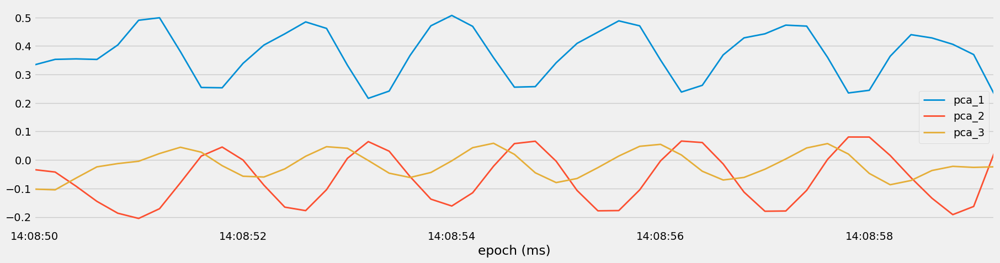

In [34]:
subset=df_pca[df_pca["Set"]==35]
subset[["pca_1","pca_2","pca_3"]].plot()

In [35]:
df_squared=df_pca.copy()
acc_r=df_squared["Accelerometer_x"]**2+df_squared["Accelerometer_y"]**2+df_squared["Accelerometer_z"]**2
gyro_r=df_squared["Gyroscope_x"]**2+df_squared["Gyroscope_y"]**2+df_squared["Gyroscope_z"]**2
df_squared["Accelerometer_r"]=np.sqrt(acc_r)
df_squared["Gyroscope_r"]=np.sqrt(gyro_r)
df_squared=df_squared.drop(columns=["Duration"])
df_squared

,Accelerometer_x,Accelerometer_y,Accelerometer_z,Gyroscope_x,Gyroscope_y,Gyroscope_z,Participants,Label,Category,Set,pca_1,pca_2,pca_3,Accelerometer_r,Gyroscope_r
epoch (ms),,,,,,,,,,,,,,,
2019-01-11 15:08:05.200,0.013494,0.977001,-0.070995,-1.896395,2.439080,0.939616,B,bench,heavy,30,-0.317491,-0.075816,0.070520,0.979670,3.229288
2019-01-11 15:08:05.400,0.006869,0.970257,-0.067545,2.129685,0.528678,-1.248135,B,bench,heavy,30,-0.315555,-0.075282,0.070565,0.972630,2.524460
2019-01-11 15:08:05.600,-0.009603,0.963589,-0.073447,4.151973,-2.092258,-0.929804,B,bench,heavy,30,-0.314780,-0.081915,0.065980,0.966432,4.741409
2019-01-11 15:08:05.800,-0.022998,0.965441,-0.083731,2.074477,-3.626288,0.880509,B,bench,heavy,30,-0.316880,-0.090205,0.060065,0.969338,4.269510
2019-01-11 15:08:06.000,-0.020032,0.966784,-0.093783,1.041930,-1.219897,-2.260590,B,bench,heavy,30,-0.317350,-0.095463,0.063173,0.971528,2.772009
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-01-20 17:33:27.000,-0.045056,-0.974791,-0.061752,3.273522,-4.487268,0.133850,E,row,medium,40,0.346775,-0.147540,-0.051285,0.977783,5.556027
2019-01-20 17:33:27.200,-0.042806,-1.020916,-0.057715,-2.514546,-2.449224,1.255524,E,row,medium,40,0.362725,-0.146231,-0.059154,1.023441,3.727999
2019-01-20 17:33:27.400,-0.047074,-1.051656,-0.066326,-0.673530,-1.799975,1.193779,E,row,medium,40,0.372734,-0.153069,-0.058939,1.054796,2.262446


In [36]:
subset=df_squared[df_squared["Set"]==18]
subset

,Accelerometer_x,Accelerometer_y,Accelerometer_z,Gyroscope_x,Gyroscope_y,Gyroscope_z,Participants,Label,Category,Set,pca_1,pca_2,pca_3,Accelerometer_r,Gyroscope_r
epoch (ms),,,,,,,,,,,,,,,
2019-01-15 19:04:09.000,0.231483,0.146942,0.563789,0.900727,-5.782011,1.429212,A,squat,heavy,18,0.001440,0.305049,-0.011263,0.626925,6.023753
2019-01-15 19:04:09.200,0.306896,0.655466,0.813936,7.362703,-4.724756,0.213729,A,squat,heavy,18,-0.160000,0.481948,-0.000706,1.089179,8.750909
2019-01-15 19:04:09.400,0.301700,0.706809,0.810545,9.157017,-3.398556,-1.442984,A,squat,heavy,18,-0.178068,0.480829,0.002260,1.116954,9.873366
2019-01-15 19:04:09.600,0.269868,0.564737,0.696995,6.309976,-3.585901,-1.415419,A,squat,heavy,18,-0.134997,0.403985,0.003181,0.936780,7.394450
2019-01-15 19:04:09.800,0.260825,0.525272,0.636215,0.025551,-3.895389,0.409019,A,squat,heavy,18,-0.123929,0.365545,0.004308,0.865280,3.916887
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-01-15 19:04:25.000,0.306685,0.516997,0.615744,-6.472338,-2.464898,4.783879,A,squat,heavy,18,-0.117861,0.361341,0.022246,0.860514,8.417386
2019-01-15 19:04:25.200,0.351972,0.552237,0.697095,-3.014426,-3.730499,1.109863,A,squat,heavy,18,-0.123952,0.417939,0.030187,0.956448,4.922924
2019-01-15 19:04:25.400,0.369700,0.568794,0.753990,8.317781,-4.959873,-1.414131,A,squat,heavy,18,-0.126390,0.454715,0.037574,1.014251,9.787011


array([<Axes: xlabel='epoch (ms)'>, <Axes: xlabel='epoch (ms)'>],
      dtype=object)

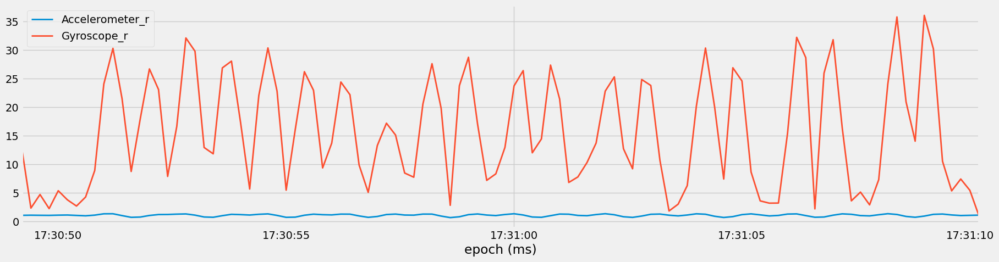

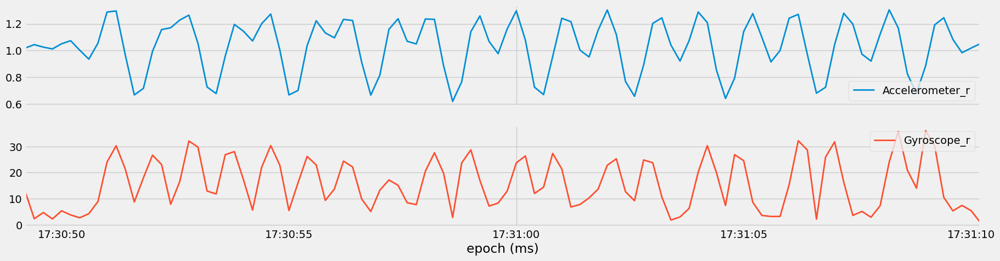

In [37]:
subset=df_squared[df_squared["Set"]==14]
subset[["Accelerometer_r","Gyroscope_r"]].plot()
subset[["Accelerometer_r","Gyroscope_r"]].plot(subplots=True)

In [38]:
df_temporal=df_squared.copy()
df_temporal

,Accelerometer_x,Accelerometer_y,Accelerometer_z,Gyroscope_x,Gyroscope_y,Gyroscope_z,Participants,Label,Category,Set,pca_1,pca_2,pca_3,Accelerometer_r,Gyroscope_r
epoch (ms),,,,,,,,,,,,,,,
2019-01-11 15:08:05.200,0.013494,0.977001,-0.070995,-1.896395,2.439080,0.939616,B,bench,heavy,30,-0.317491,-0.075816,0.070520,0.979670,3.229288
2019-01-11 15:08:05.400,0.006869,0.970257,-0.067545,2.129685,0.528678,-1.248135,B,bench,heavy,30,-0.315555,-0.075282,0.070565,0.972630,2.524460
2019-01-11 15:08:05.600,-0.009603,0.963589,-0.073447,4.151973,-2.092258,-0.929804,B,bench,heavy,30,-0.314780,-0.081915,0.065980,0.966432,4.741409
2019-01-11 15:08:05.800,-0.022998,0.965441,-0.083731,2.074477,-3.626288,0.880509,B,bench,heavy,30,-0.316880,-0.090205,0.060065,0.969338,4.269510
2019-01-11 15:08:06.000,-0.020032,0.966784,-0.093783,1.041930,-1.219897,-2.260590,B,bench,heavy,30,-0.317350,-0.095463,0.063173,0.971528,2.772009
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-01-20 17:33:27.000,-0.045056,-0.974791,-0.061752,3.273522,-4.487268,0.133850,E,row,medium,40,0.346775,-0.147540,-0.051285,0.977783,5.556027
2019-01-20 17:33:27.200,-0.042806,-1.020916,-0.057715,-2.514546,-2.449224,1.255524,E,row,medium,40,0.362725,-0.146231,-0.059154,1.023441,3.727999
2019-01-20 17:33:27.400,-0.047074,-1.051656,-0.066326,-0.673530,-1.799975,1.193779,E,row,medium,40,0.372734,-0.153069,-0.058939,1.054796,2.262446


In [39]:
df_temporal=df_squared.copy()
NumAbs=NumericalValueAbstraction()

pridictor_col=pridictor_col+["Accelerometer_r","Gyroscope_r"]

ws=int(1000/200)
for col in pridictor_col:
    df_temporal=NumAbs.abstract_numeric_value(df_temporal,[col],ws,"mean")
    df_temporal=NumAbs.abstract_numeric_value(df_temporal,[col],ws,"std")
df_temporal_list=[]
for s in df_temporal["Set"].unique():
    subset=df_temporal[df_temporal["Set"]==s].copy()
    for col in pridictor_col:
        subset=NumAbs.abstract_numeric_value(subset,[col],ws,"mean")
        subset=NumAbs.abstract_numeric_value(subset,[col],ws,"std")
    df_temporal_list.append(subset)

df_temporal=pd.concat(df_temporal_list)

df_temporal.info()


<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 9009 entries, 2019-01-11 15:08:05.200000 to 2019-01-20 17:33:27.800000
Data columns (total 31 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Accelerometer_x                 9009 non-null   float64
 1   Accelerometer_y                 9009 non-null   float64
 2   Accelerometer_z                 9009 non-null   float64
 3   Gyroscope_x                     9009 non-null   float64
 4   Gyroscope_y                     9009 non-null   float64
 5   Gyroscope_z                     9009 non-null   float64
 6   Participants                    9009 non-null   object 
 7   Label                           9009 non-null   object 
 8   Category                        9009 non-null   object 
 9   Set                             9009 non-null   int64  
 10  pca_1                           9009 non-null   float64
 11  pca_2                           9009 non-null

<Axes: xlabel='epoch (ms)'>

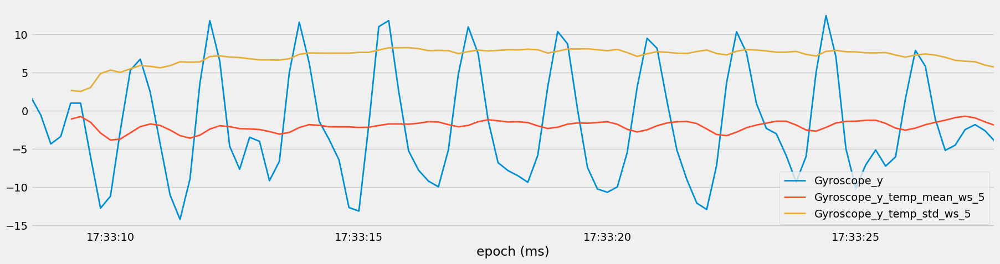

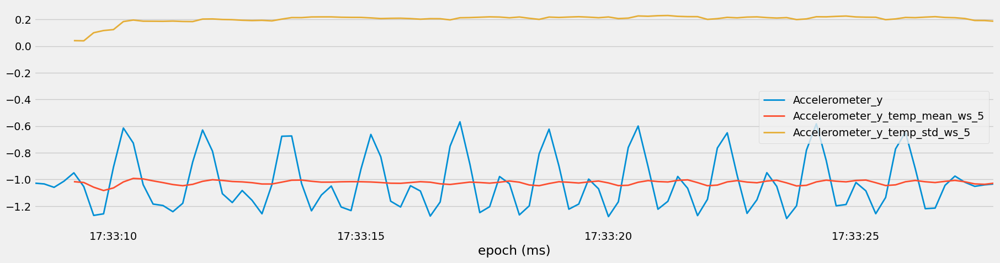

In [40]:
subset[["Gyroscope_y","Gyroscope_y_temp_mean_ws_5","Gyroscope_y_temp_std_ws_5"]].plot()
subset[["Accelerometer_y","Accelerometer_y_temp_mean_ws_5","Accelerometer_y_temp_std_ws_5"]].plot()

In [41]:
df_frq=df_temporal.copy().reset_index()
df_frq

,epoch (ms),Accelerometer_x,Accelerometer_y,Accelerometer_z,Gyroscope_x,Gyroscope_y,Gyroscope_z,Participants,Label,Category,...,Gyroscope_x_temp_mean_ws_5,Gyroscope_x_temp_std_ws_5,Gyroscope_y_temp_mean_ws_5,Gyroscope_y_temp_std_ws_5,Gyroscope_z_temp_mean_ws_5,Gyroscope_z_temp_std_ws_5,Accelerometer_r_temp_mean_ws_5,Accelerometer_r_temp_std_ws_5,Gyroscope_r_temp_mean_ws_5,Gyroscope_r_temp_std_ws_5
0,2019-01-11 15:08:05.200,0.013494,0.977001,-0.070995,-1.896395,2.439080,0.939616,B,bench,heavy,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2019-01-11 15:08:05.400,0.006869,0.970257,-0.067545,2.129685,0.528678,-1.248135,B,bench,heavy,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2019-01-11 15:08:05.600,-0.009603,0.963589,-0.073447,4.151973,-2.092258,-0.929804,B,bench,heavy,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2019-01-11 15:08:05.800,-0.022998,0.965441,-0.083731,2.074477,-3.626288,0.880509,B,bench,heavy,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2019-01-11 15:08:06.000,-0.020032,0.966784,-0.093783,1.041930,-1.219897,-2.260590,B,bench,heavy,...,1.500334,2.208213,-0.794137,2.350053,-0.523681,1.398179,0.971920,0.004937,3.507335,0.960196
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9004,2019-01-20 17:33:27.000,-0.045056,-0.974791,-0.061752,3.273522,-4.487268,0.133850,E,row,medium,...,-1.363297,21.733237,-0.885026,6.614624,1.083092,9.081930,1.017141,0.201486,20.860282,12.217182
9005,2019-01-20 17:33:27.200,-0.042806,-1.020916,-0.057715,-2.514546,-2.449224,1.255524,E,row,medium,...,-2.113004,21.422167,-0.699098,6.497006,1.297288,9.017528,1.026779,0.195467,20.282182,12.682349
9006,2019-01-20 17:33:27.400,-0.047074,-1.051656,-0.066326,-0.673530,-1.799975,1.193779,E,row,medium,...,-1.462549,21.199084,-0.919617,6.434270,1.296122,9.017540,1.041611,0.181976,19.677470,13.177246
9007,2019-01-20 17:33:27.600,-0.049361,-1.040440,-0.066542,2.411744,-2.591221,0.659428,E,row,medium,...,-0.082986,20.223536,-1.437413,5.995137,1.114079,8.981090,1.044406,0.181427,18.457213,13.197807


In [42]:
FrqAbs=FourierTransformation()

fs= int(1000/200)
ws=int(2800/200)


df_frq_list=[]
for s in df_frq["Set"].unique():
    subset=df_frq[df_frq["Set"]==s].reset_index(drop=True).copy()
    subset=FrqAbs.abstract_frequency(subset,pridictor_col,ws,fs)
    df_frq_list.append(subset)

df_frq=pd.concat(df_frq_list).set_index("epoch (ms)",drop=True)
df_frq

,Accelerometer_x,Accelerometer_y,Accelerometer_z,Gyroscope_x,Gyroscope_y,Gyroscope_z,Participants,Label,Category,Set,...,Gyroscope_r_freq_weighted,Gyroscope_r_pse,Gyroscope_r_freq_0.0_Hz_ws_14,Gyroscope_r_freq_0.357_Hz_ws_14,Gyroscope_r_freq_0.714_Hz_ws_14,Gyroscope_r_freq_1.071_Hz_ws_14,Gyroscope_r_freq_1.429_Hz_ws_14,Gyroscope_r_freq_1.786_Hz_ws_14,Gyroscope_r_freq_2.143_Hz_ws_14,Gyroscope_r_freq_2.5_Hz_ws_14
epoch (ms),,,,,,,,,,,,,,,,,,,,,
2019-01-11 15:08:05.200,0.013494,0.977001,-0.070995,-1.896395,2.439080,0.939616,B,bench,heavy,30,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2019-01-11 15:08:05.400,0.006869,0.970257,-0.067545,2.129685,0.528678,-1.248135,B,bench,heavy,30,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2019-01-11 15:08:05.600,-0.009603,0.963589,-0.073447,4.151973,-2.092258,-0.929804,B,bench,heavy,30,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2019-01-11 15:08:05.800,-0.022998,0.965441,-0.083731,2.074477,-3.626288,0.880509,B,bench,heavy,30,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2019-01-11 15:08:06.000,-0.020032,0.966784,-0.093783,1.041930,-1.219897,-2.260590,B,bench,heavy,30,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-01-20 17:33:27.000,-0.045056,-0.974791,-0.061752,3.273522,-4.487268,0.133850,E,row,medium,40,...,-0.289293,0.0,315.378553,-32.966667,25.312515,9.456436,-2.814943,-48.443419,-0.900828,-0.225067
2019-01-20 17:33:27.200,-0.042806,-1.020916,-0.057715,-2.514546,-2.449224,1.255524,E,row,medium,40,...,0.509833,0.0,304.825579,-41.572736,57.022041,78.579281,-21.898935,55.881245,14.102476,9.598016
2019-01-20 17:33:27.400,-0.047074,-1.051656,-0.066326,-0.673530,-1.799975,1.193779,E,row,medium,40,...,0.625087,0.0,266.538134,-67.414847,35.931545,37.829734,21.948169,22.258871,19.610711,29.452260


In [43]:
df_frq=df_frq.dropna()
df_frq=df_frq.iloc[::2]

In [44]:
df_cluster=df_frq.copy()
cluster_col=["Accelerometer_x","Accelerometer_y","Accelerometer_z"]
k_values=range(2,10)
inertias=[]

for k in k_values:
    subset=df_cluster[cluster_col]
    kmeans=KMeans(n_clusters=k,n_init=20,random_state=0)
    cluster_label=kmeans.fit_predict(subset)
    inertias.append(kmeans.inertia_)



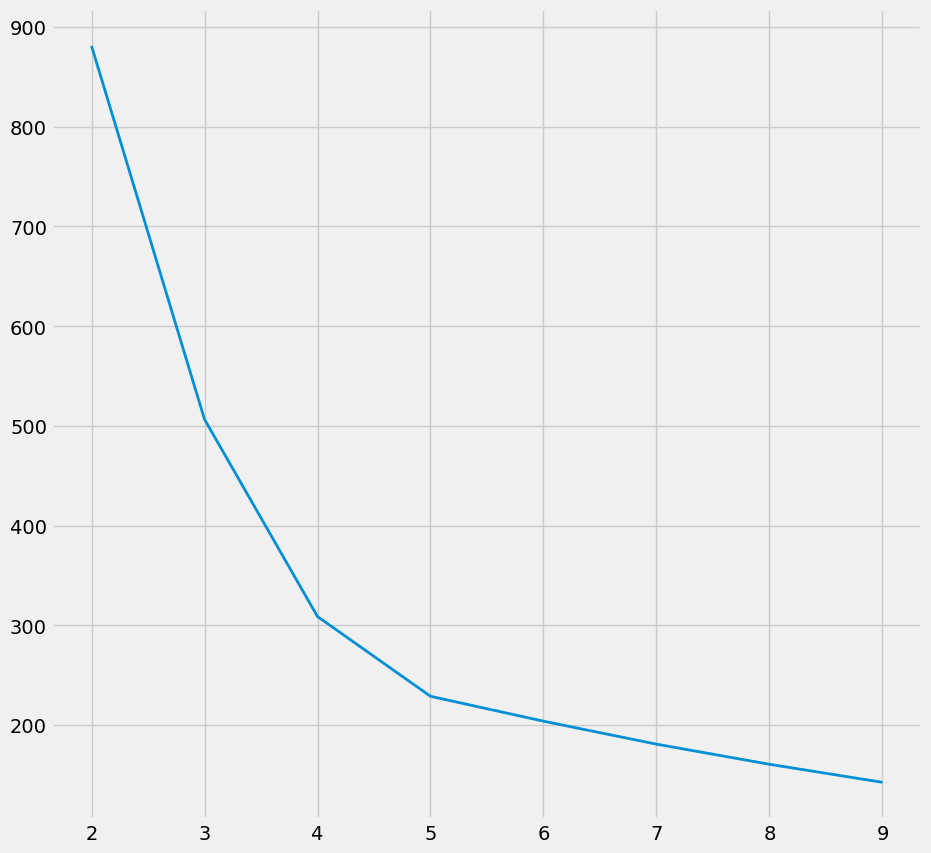

In [45]:
plt.figure(figsize=(10,10))
plt.plot(k_values,inertias)

In [46]:
kmeans=KMeans(n_clusters=5,n_init=20,random_state=0)
subset=df_cluster[cluster_col]
df_cluster["Cluster"]=kmeans.fit_predict(subset)

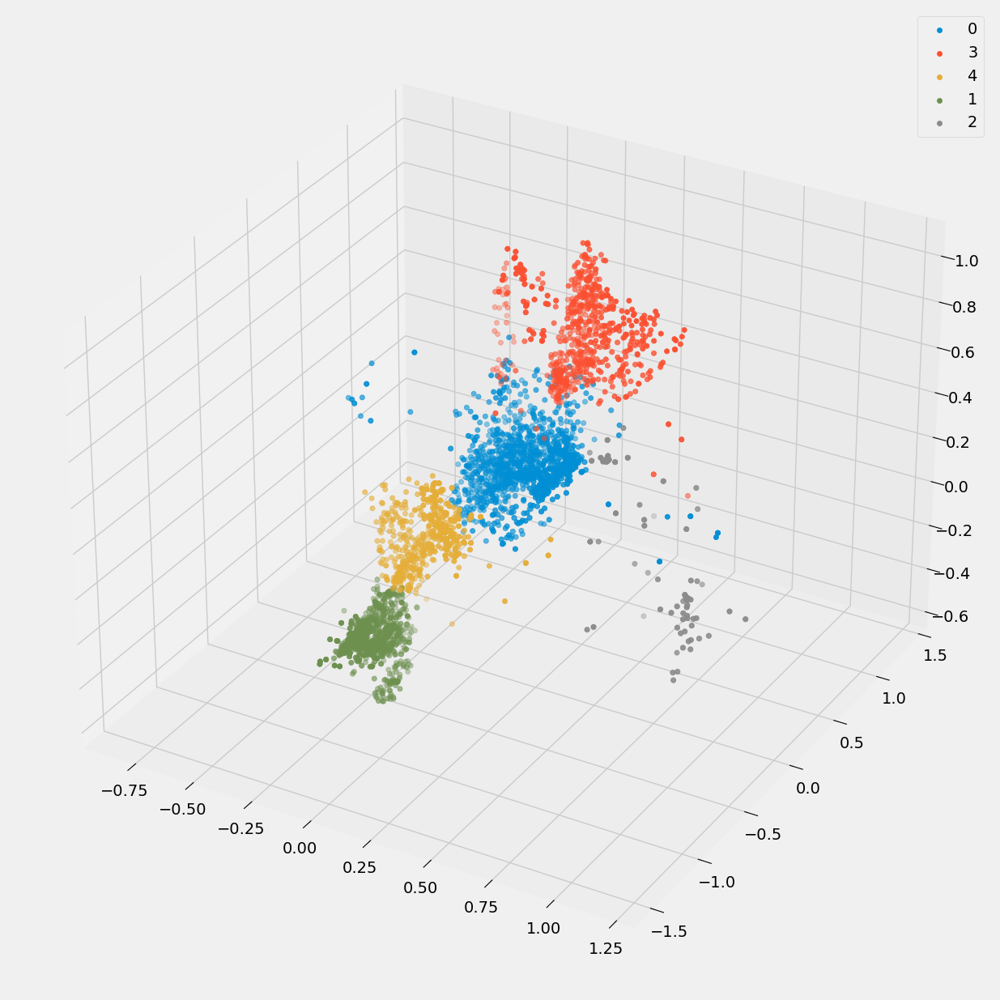

In [47]:
fig=plt.figure(figsize=(15,15))
ax=fig.add_subplot(projection="3d")
for c in df_cluster["Cluster"].unique():
    subset=df_cluster[df_cluster["Cluster"]==c]
    ax.scatter(subset["Accelerometer_x"],subset["Accelerometer_y"],subset["Accelerometer_z"],label=c)
plt.legend()
plt.show()

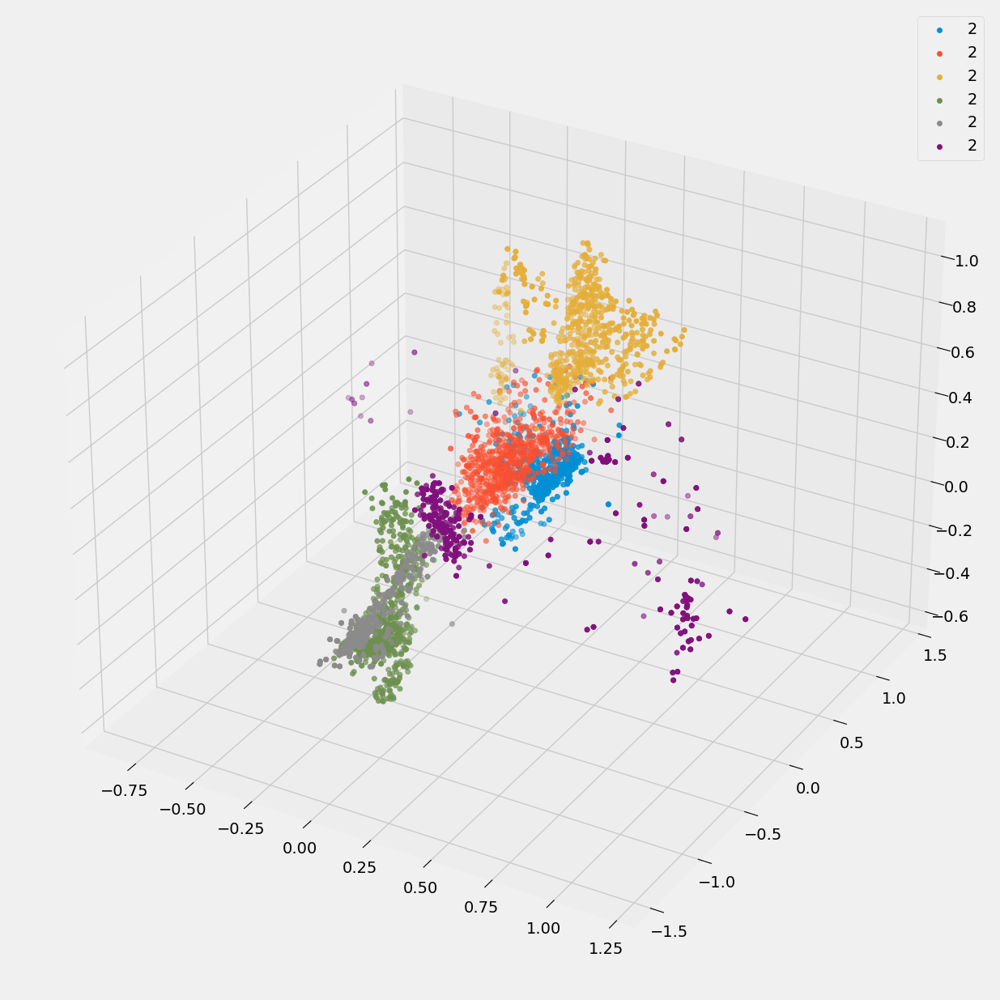

In [48]:
fig=plt.figure(figsize=(15,15))
ax=fig.add_subplot(projection="3d")
for i in df_cluster["Label"].unique():
    subset=df_cluster[df_cluster["Label"]==i]
    ax.scatter(subset["Accelerometer_x"],subset["Accelerometer_y"],subset["Accelerometer_z"],label=c)
plt.legend()
plt.show()

In [49]:
df=df_cluster
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 3868 entries, 2019-01-11 15:08:08 to 2019-01-20 17:33:27.800000
Columns: 120 entries, Accelerometer_x to Cluster
dtypes: float64(115), int32(1), int64(1), object(3)
memory usage: 3.6+ MB


# **Model Evalution**

In [50]:
df_train=df.drop(["Participants","Category","Set"],axis=1)
df_train

,Accelerometer_x,Accelerometer_y,Accelerometer_z,Gyroscope_x,Gyroscope_y,Gyroscope_z,Label,pca_1,pca_2,pca_3,...,Gyroscope_r_pse,Gyroscope_r_freq_0.0_Hz_ws_14,Gyroscope_r_freq_0.357_Hz_ws_14,Gyroscope_r_freq_0.714_Hz_ws_14,Gyroscope_r_freq_1.071_Hz_ws_14,Gyroscope_r_freq_1.429_Hz_ws_14,Gyroscope_r_freq_1.786_Hz_ws_14,Gyroscope_r_freq_2.143_Hz_ws_14,Gyroscope_r_freq_2.5_Hz_ws_14,Cluster
epoch (ms),,,,,,,,,,,,,,,,,,,,,
2019-01-11 15:08:08.000,-0.170494,0.888970,-0.172353,-25.990313,-10.162423,25.426906,bench,-0.306308,-0.170012,-0.020847,...,0.0,227.845540,-29.795388,18.195603,0.294594,-24.424951,11.515400,-51.920406,-13.567962,0
2019-01-11 15:08:08.400,-0.027634,0.878027,-0.056321,-4.311919,-1.963210,3.088785,bench,-0.286807,-0.077810,0.041118,...,0.0,255.346459,-32.701710,-65.942225,-18.156214,5.435095,16.330497,4.416252,-1.494355,0
2019-01-11 15:08:08.800,-0.060139,0.982341,-0.036019,3.691356,-1.273743,-2.492890,bench,-0.324602,-0.068072,0.035701,...,0.0,256.323480,-40.455694,-30.695845,3.361290,-10.888301,-51.138403,32.709146,-10.263861,0
2019-01-11 15:08:09.200,-0.048152,0.984179,-0.036625,-0.251944,-3.967927,4.930061,bench,-0.324352,-0.066294,0.036481,...,0.0,247.684640,-30.828083,63.975047,6.797325,14.220152,38.695272,24.992977,-4.795215,0
2019-01-11 15:08:09.600,-0.043981,0.900329,-0.056932,11.319237,5.163204,-10.174713,bench,-0.295388,-0.080264,0.051910,...,0.0,211.765064,-18.455294,21.941203,9.785602,10.100202,22.696284,-33.412821,-34.036843,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-01-20 17:33:26.200,0.061740,-0.921306,0.112441,-36.980345,7.916154,15.033379,row,0.340833,-0.024316,-0.079494,...,0.0,360.462098,25.374860,-48.513799,15.078979,-48.324601,-33.271836,-18.850747,-34.950958,4
2019-01-20 17:33:26.600,-0.022066,-1.214770,-0.111567,-4.451577,-1.081130,6.273530,row,0.429542,-0.180736,-0.050210,...,0.0,370.584934,34.584916,-17.726772,-16.241214,29.075325,73.198705,23.422109,10.144916,1
2019-01-20 17:33:27.000,-0.045056,-0.974791,-0.061752,3.273522,-4.487268,0.133850,row,0.346775,-0.147540,-0.051285,...,0.0,315.378553,-32.966667,25.312515,9.456436,-2.814943,-48.443419,-0.900828,-0.225067,1


In [51]:
X=df_train.drop("Label",axis=1)
y=df_train["Label"]

X_train,X_test,y_train,y_test=train_test_split(X,y,random_state=42,test_size=0.25,stratify=y)
X_test


,Accelerometer_x,Accelerometer_y,Accelerometer_z,Gyroscope_x,Gyroscope_y,Gyroscope_z,pca_1,pca_2,pca_3,Accelerometer_r,...,Gyroscope_r_pse,Gyroscope_r_freq_0.0_Hz_ws_14,Gyroscope_r_freq_0.357_Hz_ws_14,Gyroscope_r_freq_0.714_Hz_ws_14,Gyroscope_r_freq_1.071_Hz_ws_14,Gyroscope_r_freq_1.429_Hz_ws_14,Gyroscope_r_freq_1.786_Hz_ws_14,Gyroscope_r_freq_2.143_Hz_ws_14,Gyroscope_r_freq_2.5_Hz_ws_14,Cluster
epoch (ms),,,,,,,,,,,,,,,,,,,,,
2019-01-14 13:27:05.000,-0.096590,0.640300,-0.394175,22.351351,-7.330114,-5.056275,-0.218907,-0.296260,0.099440,0.758081,...,0.0,235.184174,40.152347,-8.881694,19.070057,-5.370766,-27.611375,-20.060007,12.610739,0
2019-01-14 13:57:35.600,-0.131711,0.916163,0.116533,-2.510891,-2.345862,-11.372367,-0.304402,0.006651,-0.038299,0.932890,...,0.0,486.536043,-73.737990,45.089713,-4.015153,-53.204131,11.594376,-1.507629,-7.365480,0
2019-01-11 16:24:37.800,0.046123,-1.079646,-0.053480,-13.050292,-6.116112,-6.235614,0.390272,-0.130372,-0.032142,1.081953,...,0.0,304.379457,-55.665318,14.578421,-75.498306,49.831060,12.112781,-21.380137,5.046672,1
2019-01-19 17:22:53.000,0.920264,-0.278027,-0.006213,-8.897143,-0.455310,-0.180389,0.191540,0.076093,0.394166,0.961365,...,0.0,878.031185,-93.136056,-143.507988,156.670907,13.756987,-73.462315,-10.258633,3.032286,2
2019-01-15 19:12:12.400,0.378047,0.633597,0.645276,4.650798,-3.875410,0.451335,-0.150687,0.394782,0.064902,0.980177,...,0.0,174.412675,-30.687595,20.488805,-8.053934,23.954891,1.481539,2.167062,2.834133,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-01-12 16:24:28.000,-0.015608,-0.738337,0.271413,23.989350,3.663078,5.823278,0.277117,0.060776,-0.080717,0.786797,...,0.0,213.265943,7.411804,25.612212,-61.979071,-13.828822,-4.292109,2.715965,6.385478,4
2019-01-14 13:57:33.600,-0.016574,0.978686,0.323584,-2.470581,-4.838477,17.048292,-0.310903,0.150001,-0.033121,1.030926,...,0.0,539.719992,69.996095,10.466205,-59.766423,53.395183,59.220532,38.585541,39.478630,3
2019-01-15 19:04:13.800,0.279690,0.563296,0.605349,-7.235989,-1.315629,1.769725,-0.136305,0.352197,0.014443,0.872913,...,0.0,120.277540,-37.956970,37.970055,-21.696367,5.425213,2.739522,-0.543247,-2.591478,3


In [52]:
basic_col=["Accelerometer_x","Accelerometer_y","Accelerometer_z","Gyroscope_x","Gyroscope_y","Gyroscope_z"]
square_col=["Accelerometer_r","Gyroscope_r"]
pca_col=["pca_1","pca_2","pca_3"]
time_col=[f for f in df_train.columns if "_temp_" in f]
freq_col=[f for f in df_train.columns if ("_freq" in f) or ("_pse" in f)]
cluster_col=["Cluster"]
print(len(basic_col))
print(len(square_col))
print(len(pca_col))
print(len(time_col))
print(len(freq_col))
print(len(cluster_col))

6
2
3
16
88
1


In [53]:
df_train.columns[30:]

Index(['Accelerometer_x_pse', 'Accelerometer_x_freq_0.0_Hz_ws_14',
       'Accelerometer_x_freq_0.357_Hz_ws_14',
       'Accelerometer_x_freq_0.714_Hz_ws_14',
       'Accelerometer_x_freq_1.071_Hz_ws_14',
       'Accelerometer_x_freq_1.429_Hz_ws_14',
       'Accelerometer_x_freq_1.786_Hz_ws_14',
       'Accelerometer_x_freq_2.143_Hz_ws_14',
       'Accelerometer_x_freq_2.5_Hz_ws_14', 'Accelerometer_y_maximum_freq',
       'Accelerometer_y_freq_weighted', 'Accelerometer_y_pse',
       'Accelerometer_y_freq_0.0_Hz_ws_14',
       'Accelerometer_y_freq_0.357_Hz_ws_14',
       'Accelerometer_y_freq_0.714_Hz_ws_14',
       'Accelerometer_y_freq_1.071_Hz_ws_14',
       'Accelerometer_y_freq_1.429_Hz_ws_14',
       'Accelerometer_y_freq_1.786_Hz_ws_14',
       'Accelerometer_y_freq_2.143_Hz_ws_14',
       'Accelerometer_y_freq_2.5_Hz_ws_14', 'Accelerometer_z_maximum_freq',
       'Accelerometer_z_freq_weighted', 'Accelerometer_z_pse',
       'Accelerometer_z_freq_0.0_Hz_ws_14',
       'Acceler

In [54]:
f_set_1=list(set(basic_col))
f_set_2=list(set(basic_col+square_col+pca_col))
f_set_3=list(set(f_set_2+time_col))
f_set_4=list(set(f_set_3+freq_col+cluster_col))

In [55]:
learner=AlgorithmClassification()
selected_col,ordered_col,orederd_scores=learner.forward_selection(10,X_train,y_train)

0
1
2
3
4
5
6
7
8
9


In [56]:
orederd_scores

[0.885556704584626,
 0.9944846604619096,
 0.9986211651154774,
 0.9993105825577387,
 0.9993105825577387,
 0.9996552912788693,
 0.9996552912788693,
 0.9996552912788693,
 1.0,
 1.0]

In [57]:
selected_col

['Accelerometer_z_freq_0.0_Hz_ws_14',
 'Gyroscope_z_temp_std_ws_5',
 'Accelerometer_x_freq_0.0_Hz_ws_14',
 'pca_1',
 'Gyroscope_r_pse',
 'Accelerometer_x_temp_mean_ws_5',
 'Gyroscope_z_freq_1.071_Hz_ws_14',
 'Accelerometer_y_temp_std_ws_5',
 'Accelerometer_y_pse',
 'Gyroscope_z']

In [58]:

iterations=1
score_df=pd.DataFrame()
possible_feature_sets=[
    f_set_1,f_set_2,f_set_3,f_set_4,selected_col
]
feature_names=[
    "f_col_1",
    "f_col_2",
    "f_col_3",
    "f_col_4",
    "selected_col",
]
for i, f in zip(range(len(possible_feature_sets)), feature_names):
    print("Feature set:", i)
    selected_train_X = X_train[possible_feature_sets[i]]
    selected_test_X = X_test[possible_feature_sets[i]]

    # First run non deterministic classifiers to average their score.
    performance_test_nn = 0
    performance_test_rf = 0

    for it in range(0, iterations):
        print("\tTraining neural network,", it)
        (
            class_train_y,
            class_test_y,
            class_train_prob_y,
            class_test_prob_y,
        ) = learner.feedforward_neural_network(
            selected_train_X,
            y_train,
            selected_test_X,
            gridsearch=False,
        )
        performance_test_nn += accuracy_score(y_test, class_test_y)

        print("\tTraining random forest,", it)
        (
            class_train_y,
            class_test_y,
            class_train_prob_y,
            class_test_prob_y,
        ) = learner.random_forest(
            selected_train_X, y_train, selected_test_X, gridsearch=True
        )
        performance_test_rf += accuracy_score(y_test, class_test_y)

    performance_test_nn = performance_test_nn / iterations
    performance_test_rf = performance_test_rf / iterations

    # And we run our deterministic classifiers:
    print("\tTraining KNN")
    (
        class_train_y,
        class_test_y,
        class_train_prob_y,
        class_test_prob_y,
    ) = learner.k_nearest_neighbor(
        selected_train_X, y_train, selected_test_X, gridsearch=True
    )
    performance_test_knn = accuracy_score(y_test, class_test_y)

    print("\tTraining decision tree")
    (
        class_train_y,
        class_test_y,
        class_train_prob_y,
        class_test_prob_y,
    ) = learner.decision_tree(
        selected_train_X, y_train, selected_test_X, gridsearch=True
    )
    performance_test_dt = accuracy_score(y_test, class_test_y)

    print("\tTraining naive bayes")
    (
        class_train_y,
        class_test_y,
        class_train_prob_y,
        class_test_prob_y,
    ) = learner.naive_bayes(selected_train_X, y_train, selected_test_X)

    performance_test_nb = accuracy_score(y_test, class_test_y)

    # Save results to dataframe
    models = ["NN", "RF", "KNN", "DT", "NB"]
    new_scores = pd.DataFrame(
        {
            "model": models,
            "feature_set": f,
            "accuracy": [
                performance_test_nn,
                performance_test_rf,
                performance_test_knn,
                performance_test_dt,
                performance_test_nb,
            ],
        }
    )
    score_df = pd.concat([score_df, new_scores])




Feature set: 0
	Training neural network, 0
	Training random forest, 0
	Training KNN
	Training decision tree
	Training naive bayes
Feature set: 1
	Training neural network, 0
	Training random forest, 0
	Training KNN
	Training decision tree
	Training naive bayes
Feature set: 2
	Training neural network, 0
	Training random forest, 0
	Training KNN
	Training decision tree
	Training naive bayes
Feature set: 3
	Training neural network, 0
	Training random forest, 0
	Training KNN
	Training decision tree
	Training naive bayes
Feature set: 4
	Training neural network, 0
	Training random forest, 0
	Training KNN
	Training decision tree
	Training naive bayes


In [59]:
score_list=score_df.sort_values(by="accuracy",ascending=False).head()
print(score_list)

  model   feature_set  accuracy
1    RF       f_col_3  1.000000
1    RF  selected_col  0.998966
3    DT       f_col_4  0.998966
1    RF       f_col_4  0.998966
0    NN       f_col_4  0.998966


In [60]:
class_train_y,class_test_y,class_train_prob_y,class_test_prob_y=learner.random_forest(
    X_train[f_set_4],y_train,X_test[f_set_4],gridsearch=True
)

In [61]:
accuracy=accuracy_score(y_test,class_test_y)
accuracy

1.0

In [62]:
classes=class_test_prob_y.columns
cm=confusion_matrix(y_test,class_test_y,labels=classes)

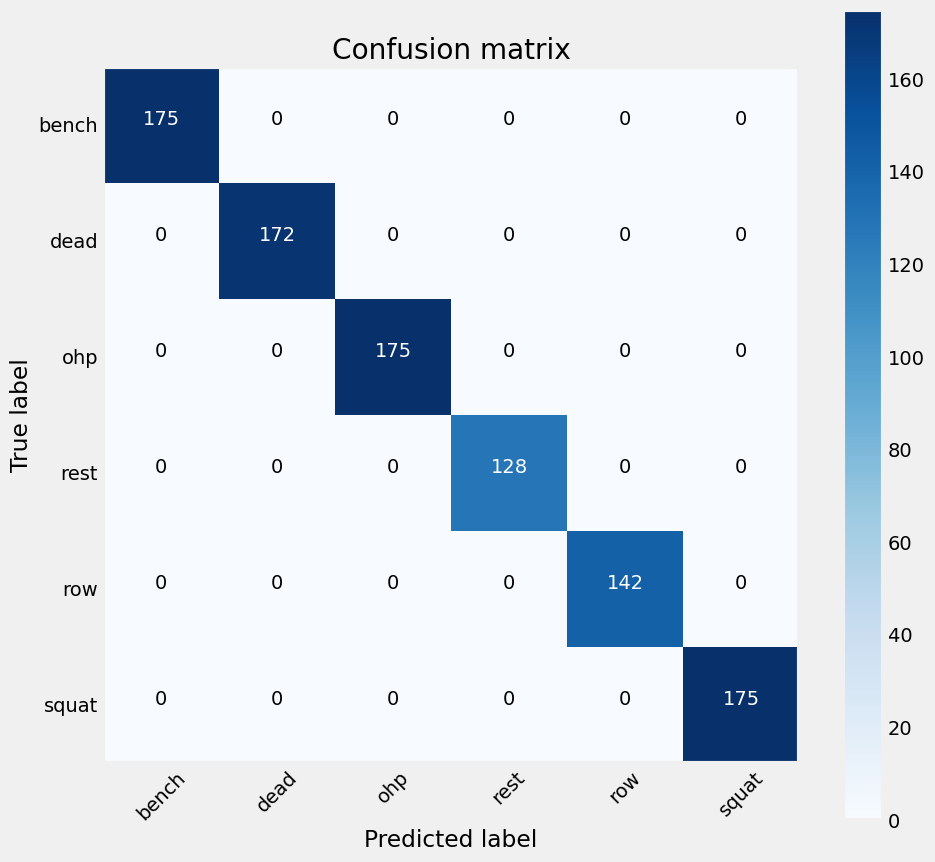

In [63]:
plt.figure(figsize=(10, 10))
plt.imshow(cm, interpolation="nearest", cmap=plt.cm.Blues)
plt.title("Confusion matrix")
plt.colorbar()
tick_marks = np.arange(len(classes))
plt.xticks(tick_marks, classes, rotation=45)
plt.yticks(tick_marks, classes)

thresh = cm.max() / 2.0
for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
    plt.text(
        j,
        i,
        format(cm[i, j]),
        horizontalalignment="center",
        color="white" if cm[i, j] > thresh else "black",
    )
plt.ylabel("True label")
plt.xlabel("Predicted label")
plt.grid(False)
plt.show()


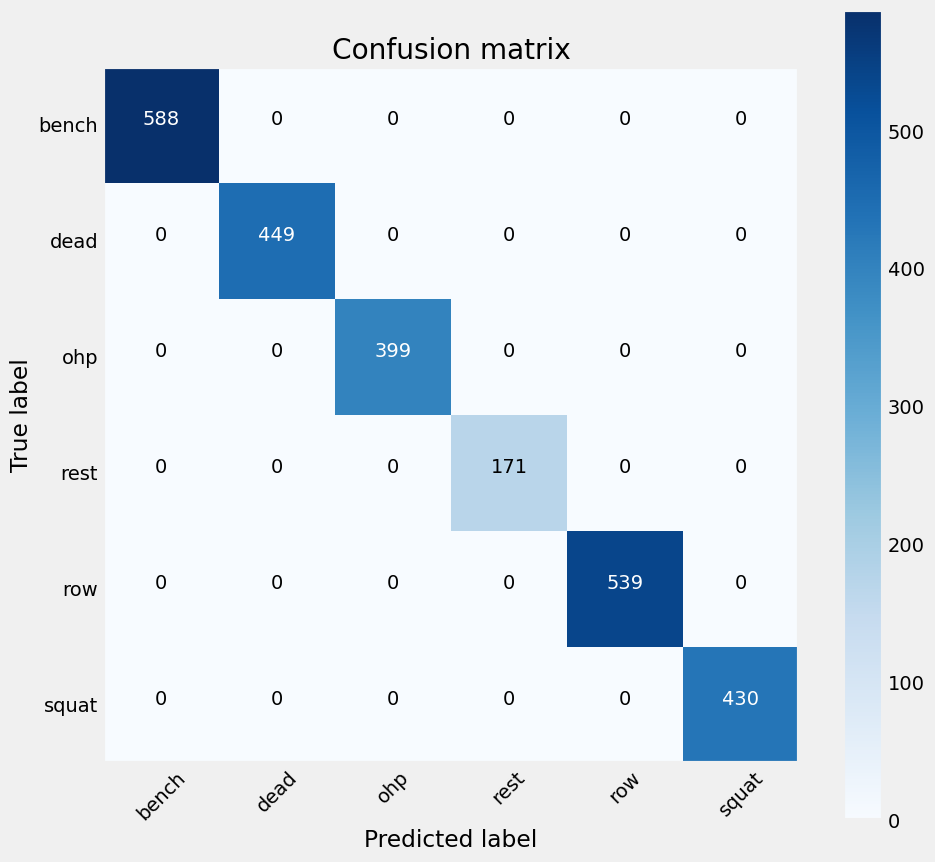

In [64]:
participant_df=df.drop(["Set","Category"],axis=1)
X_train=participant_df[participant_df["Participants"] !="A"].drop(["Label"],axis=1)
y_train=participant_df[participant_df["Participants"] !="A"]["Label"]

X_test=participant_df[participant_df["Participants"] !="A"].drop(["Label"],axis=1)
y_test=participant_df[participant_df["Participants"] !="A"]["Label"]

X_train=X_train.drop(["Participants"],axis=1)
X_test=X_test.drop(["Participants"],axis=1)


class_train_y,class_test_y,class_train_prob_y,class_test_prob_y=learner.random_forest(
    X_train[f_set_4],y_train,X_test[f_set_4],gridsearch=True
)

classes=class_test_prob_y.columns
cm=confusion_matrix(y_test,class_test_y,labels=classes)

plt.figure(figsize=(10, 10))
plt.imshow(cm, interpolation="nearest", cmap=plt.cm.Blues)
plt.title("Confusion matrix")
plt.colorbar()
tick_marks = np.arange(len(classes))
plt.xticks(tick_marks, classes, rotation=45)
plt.yticks(tick_marks, classes)

thresh = cm.max() / 2.0
for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
    plt.text(
        j,
        i,
        format(cm[i, j]),
        horizontalalignment="center",
        color="white" if cm[i, j] > thresh else "black",
    )
plt.ylabel("True label")
plt.xlabel("Predicted label")
plt.grid(False)
plt.show()

In [65]:
accuracy=accuracy_score(y_test,class_test_y)
accuracy

1.0

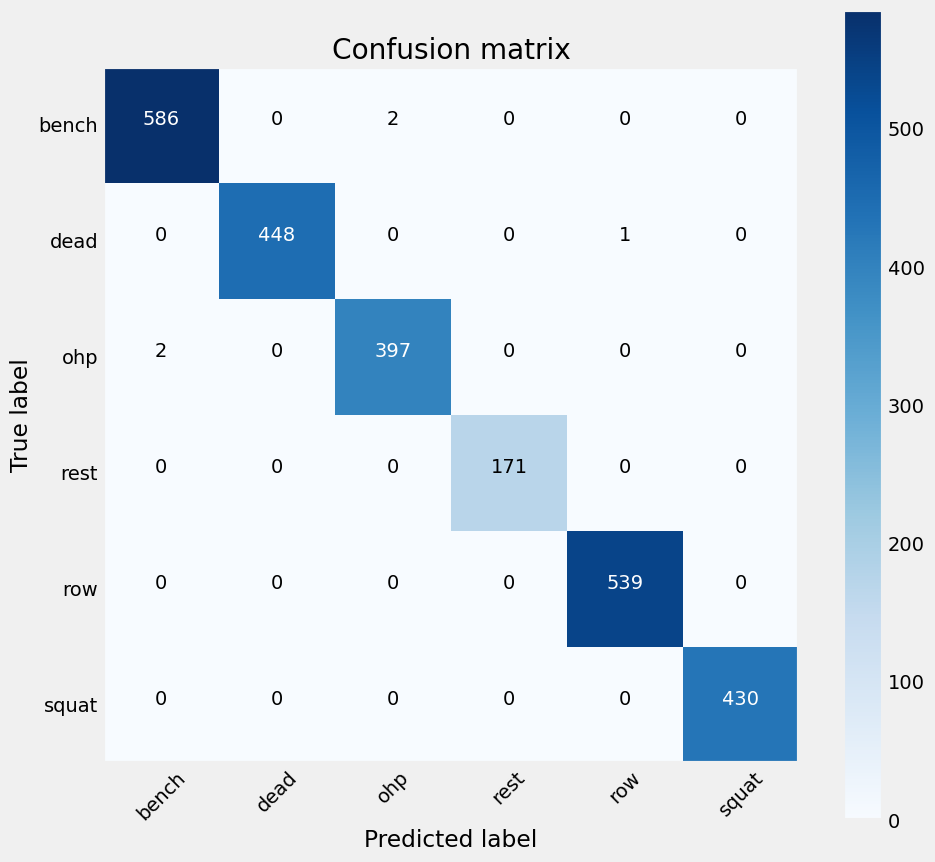

In [66]:

class_train_y,class_test_y,class_train_prob_y,class_test_prob_y=learner.feedforward_neural_network(
    X_train[selected_col],y_train,X_test[selected_col],gridsearch=False
)

classes=class_test_prob_y.columns
cm=confusion_matrix(y_test,class_test_y,labels=classes)

plt.figure(figsize=(10, 10))
plt.imshow(cm, interpolation="nearest", cmap=plt.cm.Blues)
plt.title("Confusion matrix")
plt.colorbar()
tick_marks = np.arange(len(classes))
plt.xticks(tick_marks, classes, rotation=45)
plt.yticks(tick_marks, classes)

thresh = cm.max() / 2.0
for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
    plt.text(
        j,
        i,
        format(cm[i, j]),
        horizontalalignment="center",
        color="white" if cm[i, j] > thresh else "black",
    )
plt.ylabel("True label")
plt.xlabel("Predicted label")
plt.grid(False)
plt.show()

In [67]:
accuracy=accuracy_score(y_test,class_test_y)
accuracy

0.9980590062111802

# **Counting**

In [69]:
df=pd.read_csv("https://raw.githubusercontent.com/manoj2005/FitnessTracker_ML/refs/heads/main/01_Data_Processed.csv")
df.set_index('epoch (ms)', inplace=True)

df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 9009 entries, 2019-01-11 15:08:05.200 to 2019-01-20 17:33:27.800
Data columns (total 10 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Accelerometer_x  9009 non-null   float64
 1   Accelerometer_y  9009 non-null   float64
 2   Accelerometer_z  9009 non-null   float64
 3   Gyroscope_x      9009 non-null   float64
 4   Gyroscope_y      9009 non-null   float64
 5   Gyroscope_z      9009 non-null   float64
 6   Participants     9009 non-null   object 
 7   Label            9009 non-null   object 
 8   Category         9009 non-null   object 
 9   Set              9009 non-null   int64  
dtypes: float64(6), int64(1), object(3)
memory usage: 774.2+ KB


In [70]:
df=df[df["Label"]!="rest"]
acc_r=df["Accelerometer_x"]**2+df["Accelerometer_y"]**2+df["Accelerometer_z"]**2
gyro_r=df["Gyroscope_x"]**2+df["Gyroscope_y"]**2+df["Gyroscope_z"]**2
df["Accelerometer_r"]=np.sqrt(acc_r)
df["Gyroscope_r"]=np.sqrt(gyro_r)


In [71]:
bench_df=df[df["Label"]=="bench"]
squat_df=df[df["Label"]=="squat"]
row_df=df[df["Label"]=="row"]
ohp_df=df[df["Label"]=="ohp"]
dead_df=df[df["Label"]=="dead"]


In [72]:
fs=1000/200
LowPass=LowPassFilter()

bench_set=bench_df[bench_df["Set"]==bench_df["Set"].unique()[0]]
squat_set=squat_df[squat_df["Set"]==squat_df["Set"].unique()[0]]
row_set=row_df[row_df["Set"]==row_df["Set"].unique()[0]]
ohp_set=ohp_df[ohp_df["Set"]==ohp_df["Set"].unique()[0]]
dead_set=dead_df[dead_df["Set"]==dead_df["Set"].unique()[0]]

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


<Axes: xlabel='epoch (ms)'>

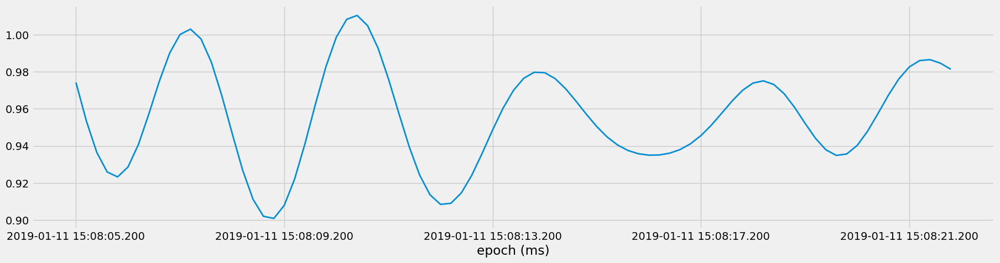

In [73]:
column="Accelerometer_y"
LowPass.low_pass_filter(bench_set,column,fs,0.4,10)[column+"_lowpass"].plot()

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


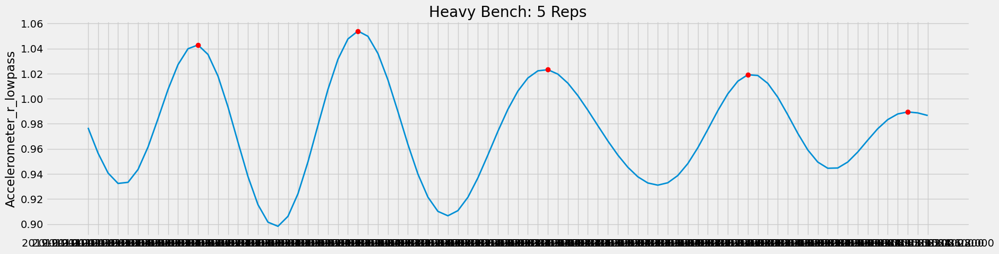

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


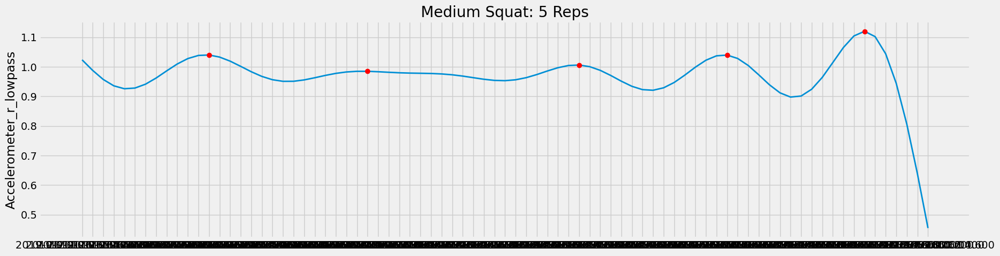

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


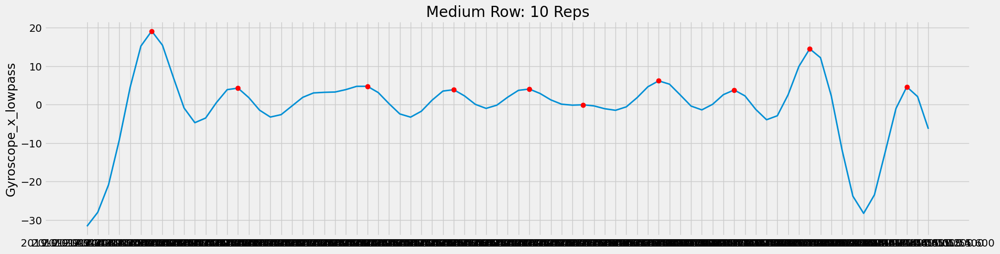

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


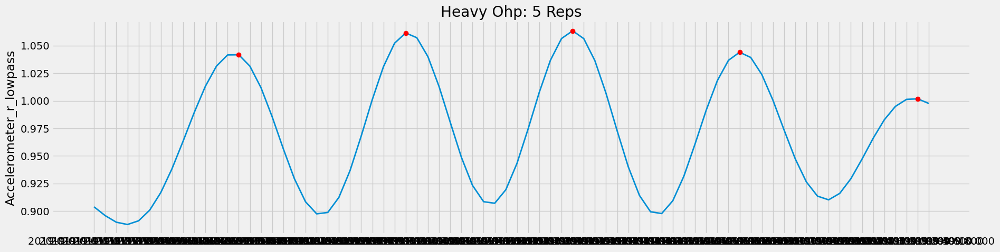

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


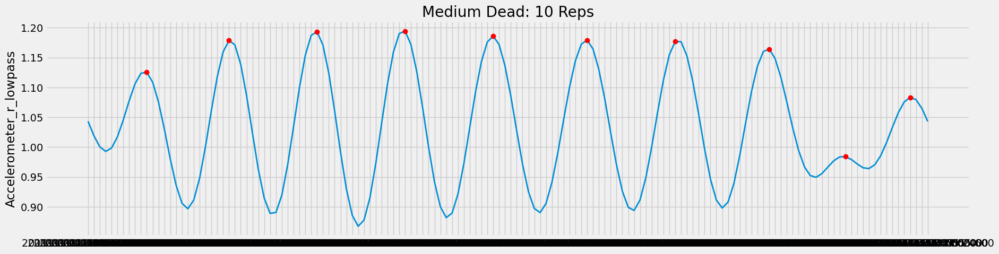

10

In [74]:
count(bench_set,cutoff=0.4)
count(squat_set,cutoff=0.35)
count(row_set,cutoff=0.65,column="Gyroscope_x")
count(ohp_set,cutoff=0.35)
count(dead_set,cutoff=0.4)

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


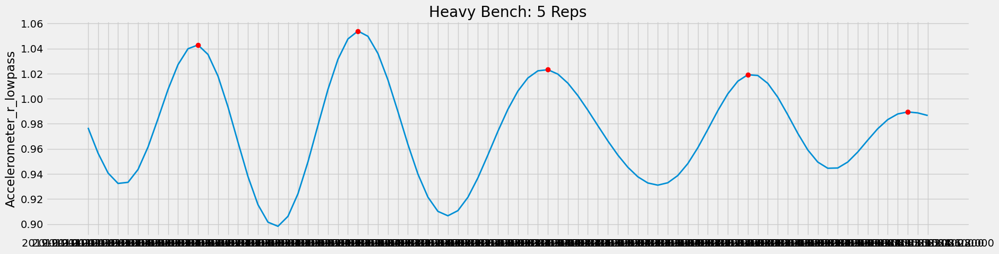

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


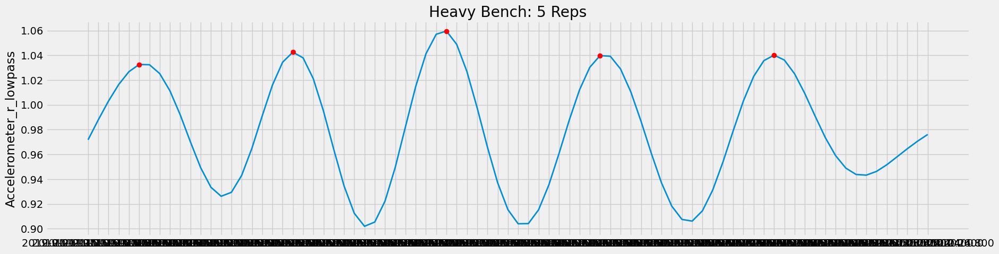

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


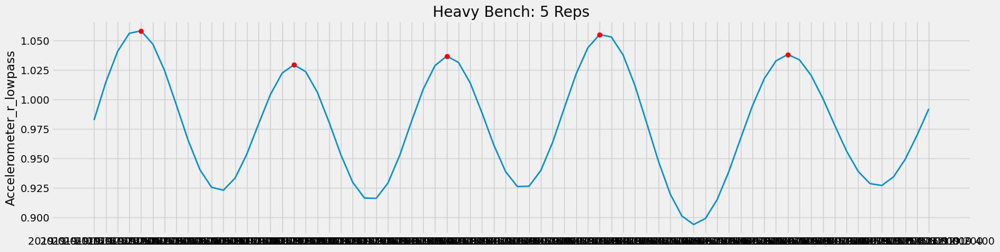

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


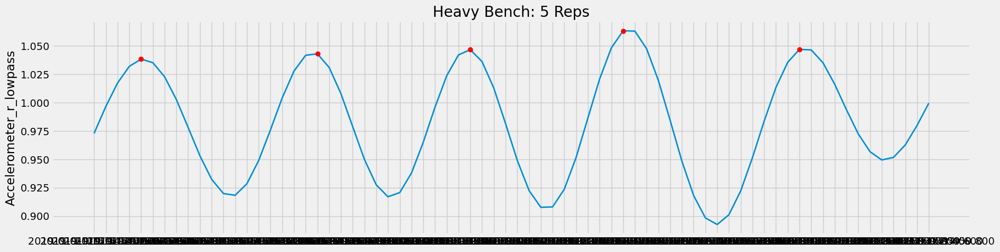

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


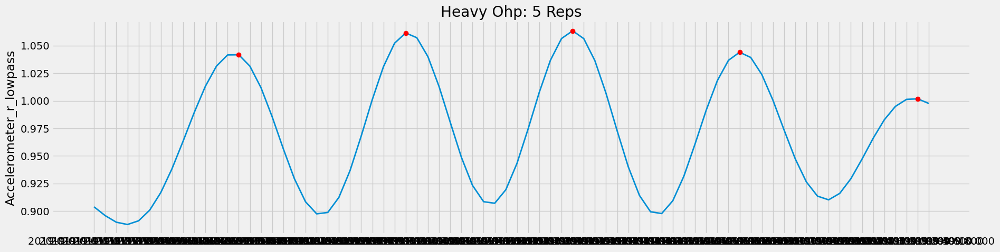

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


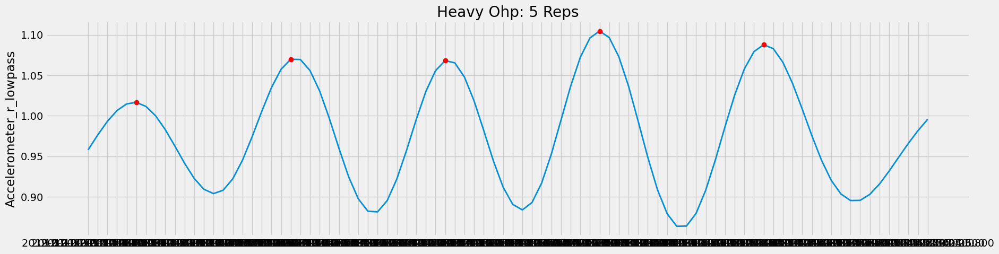

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


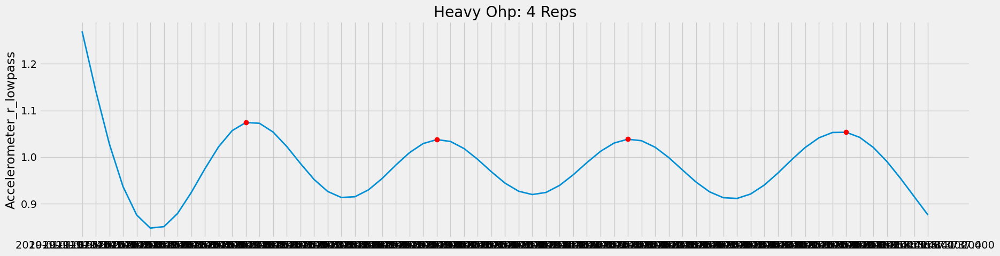

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


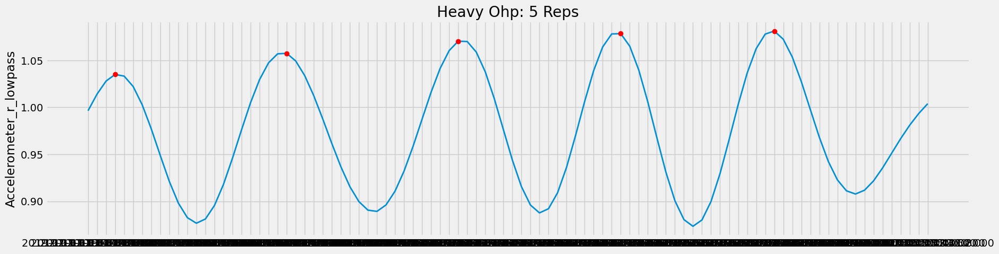

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


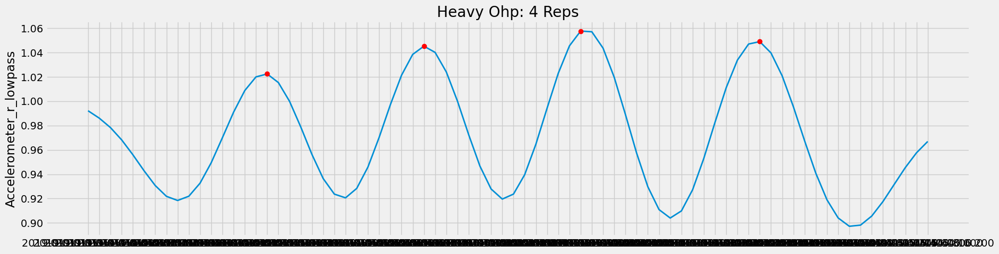

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


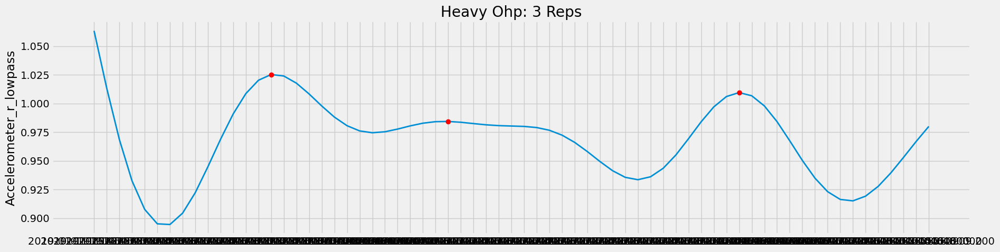

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


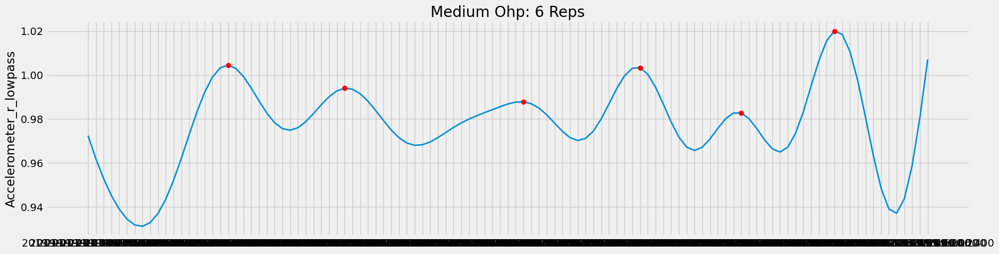

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


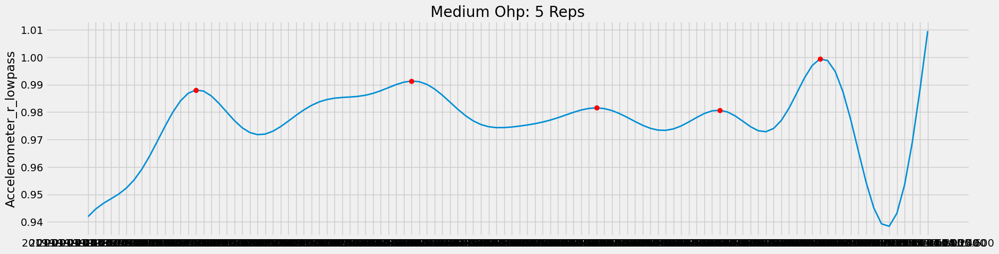

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


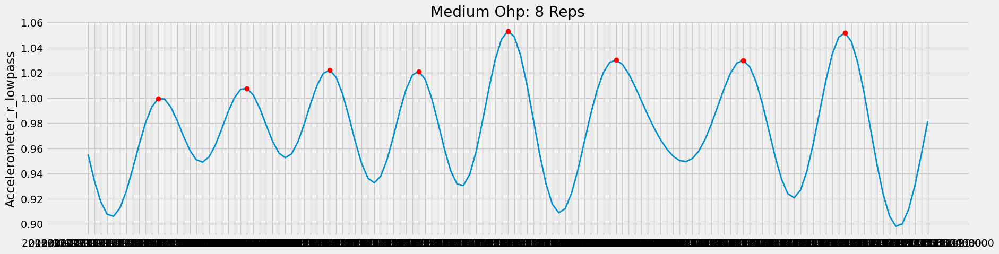

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


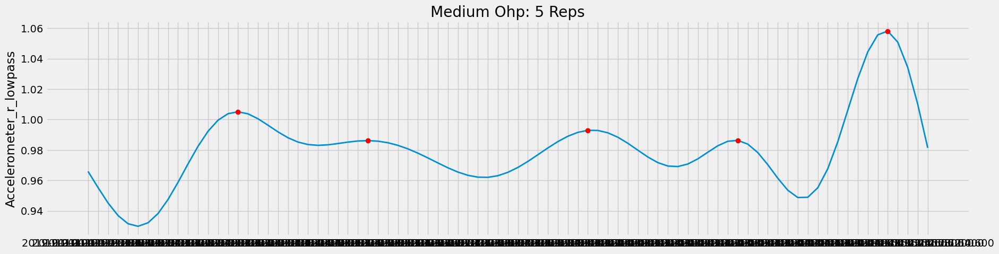

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


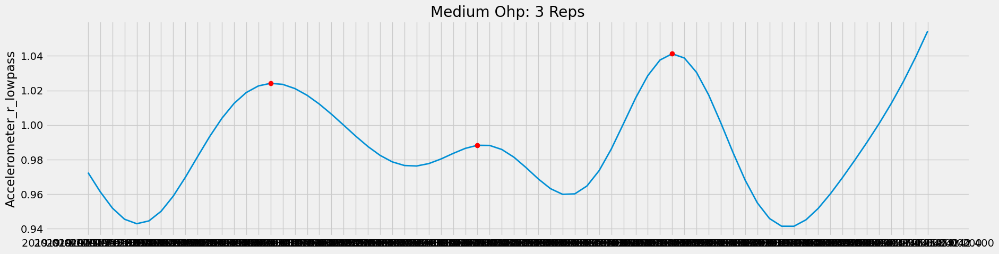

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


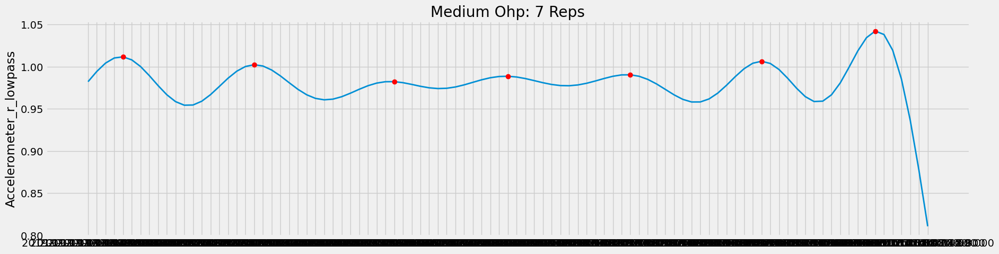

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


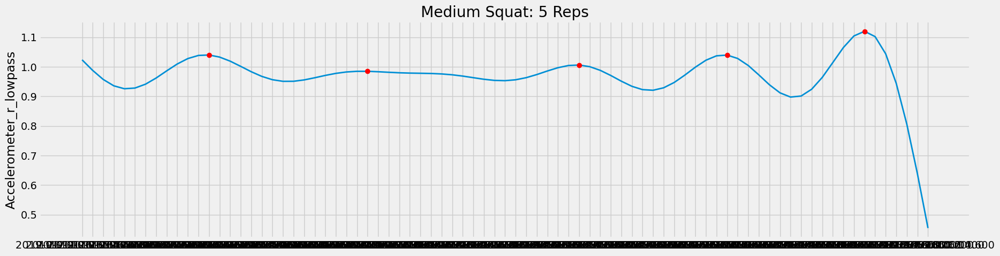

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


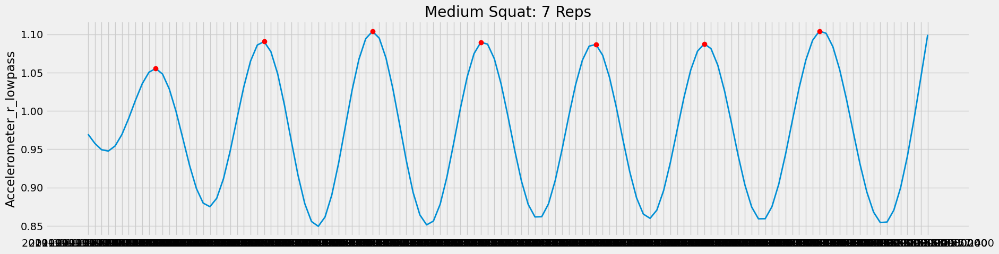

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


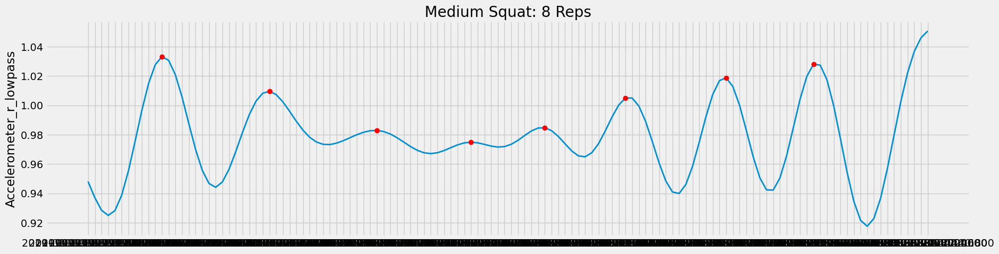

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


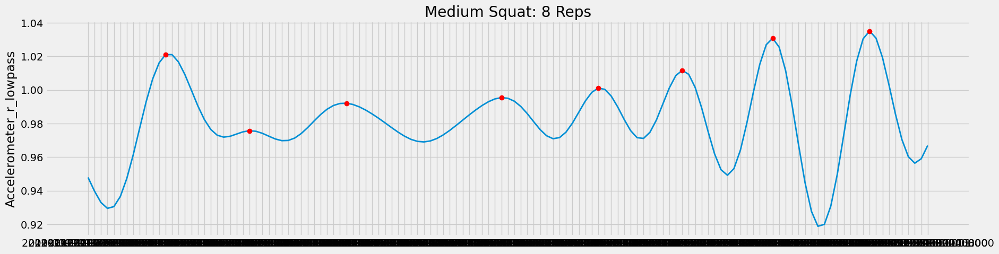

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


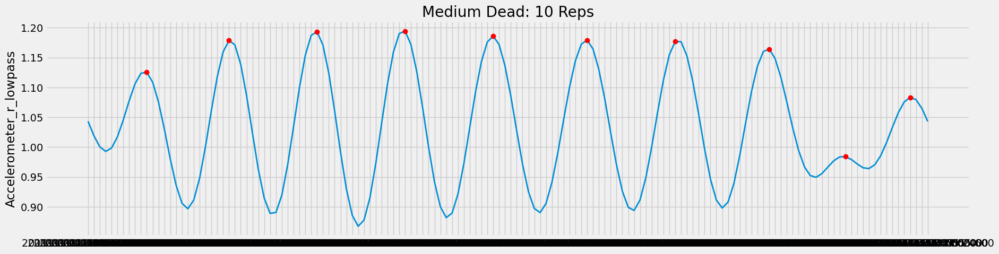

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


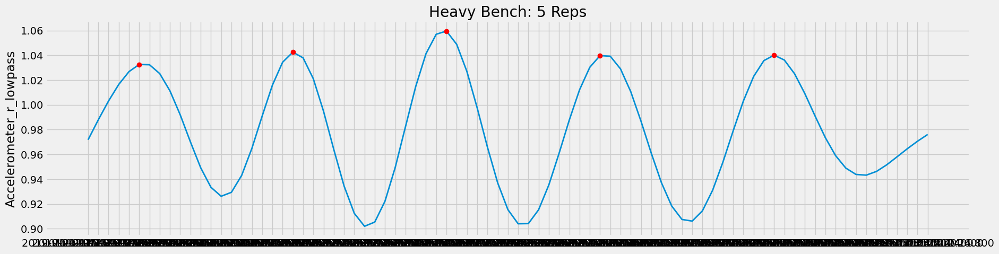

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


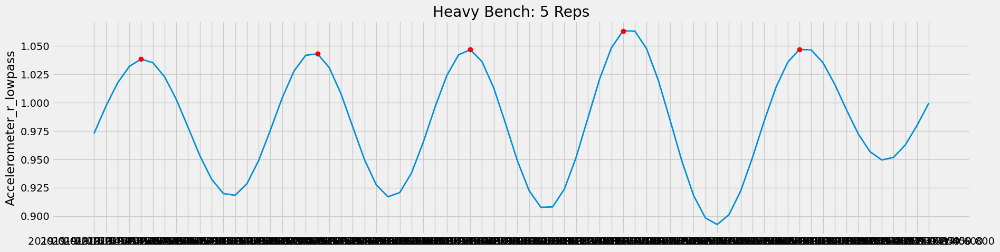

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


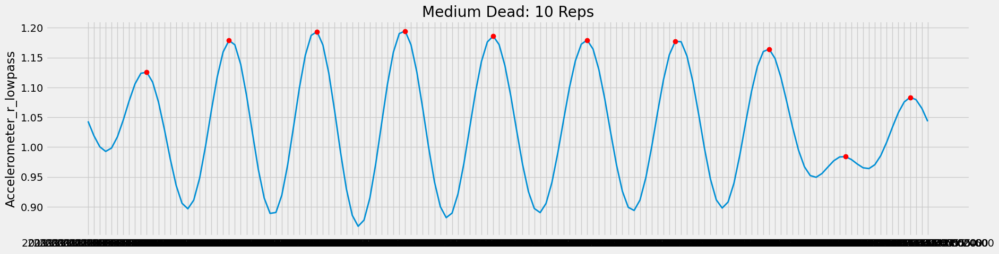

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


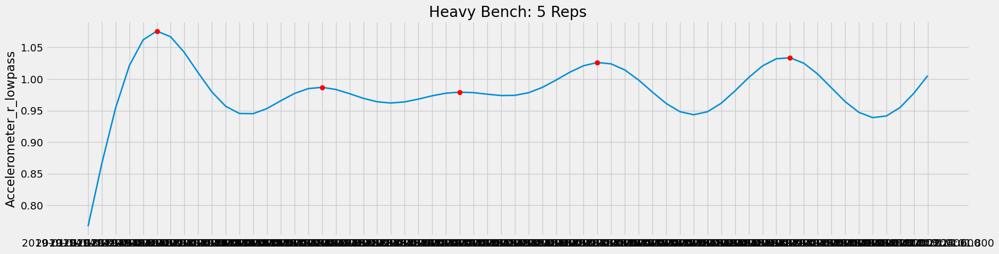

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


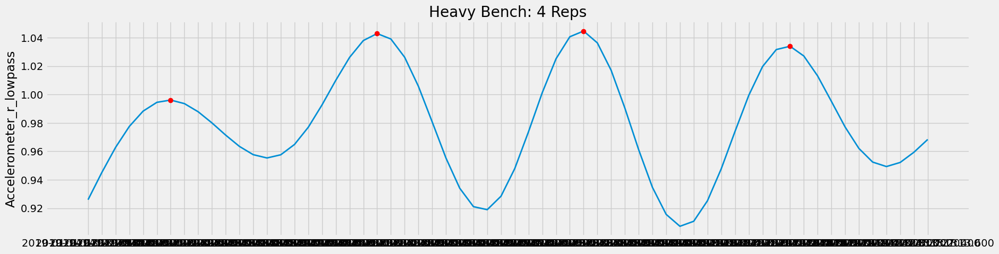

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


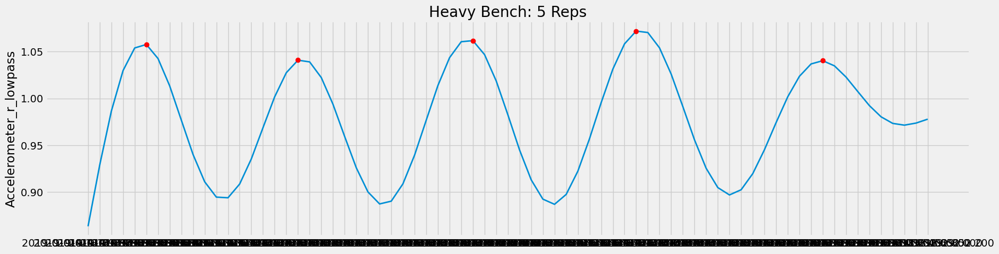

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


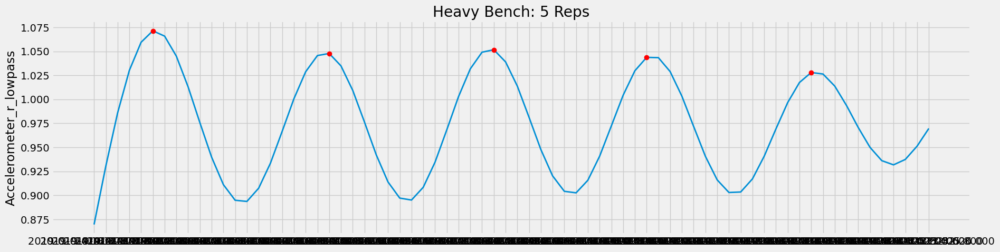

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


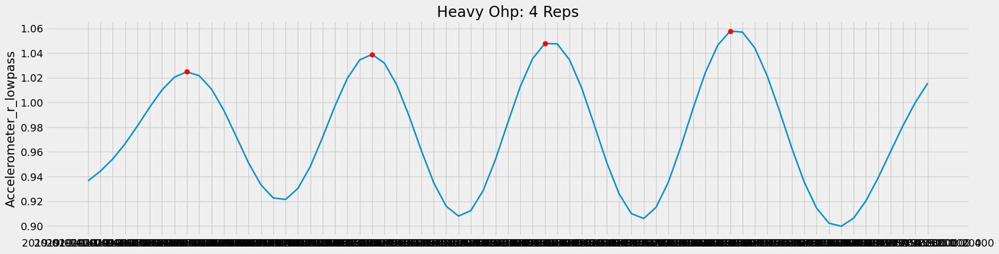

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


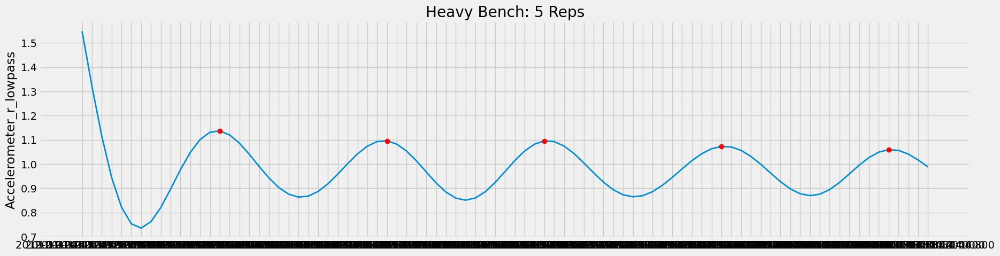

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


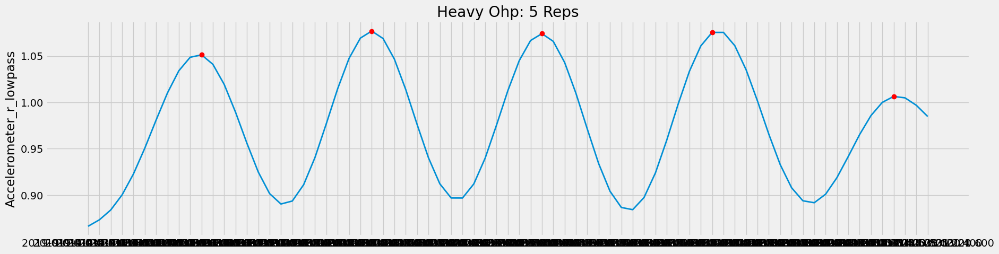

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


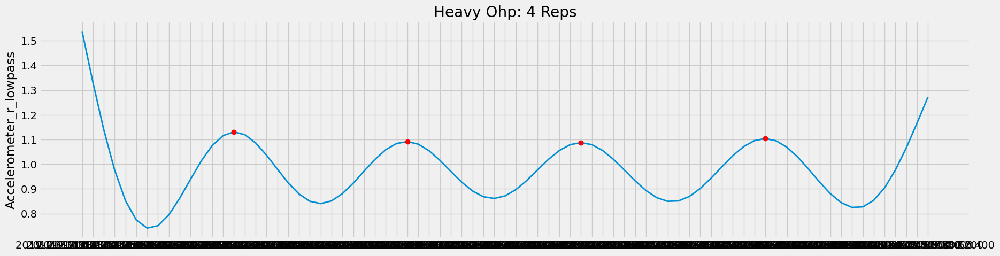

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


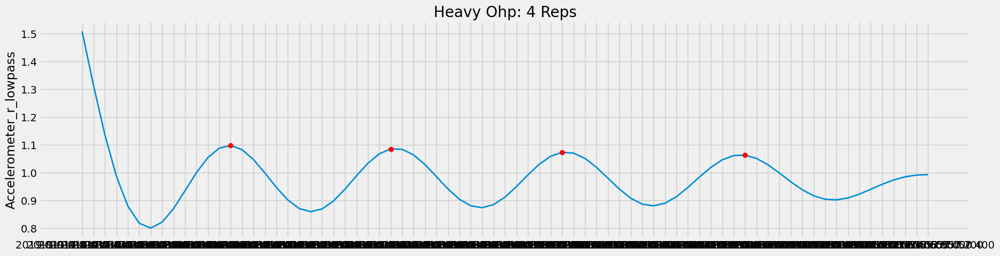

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


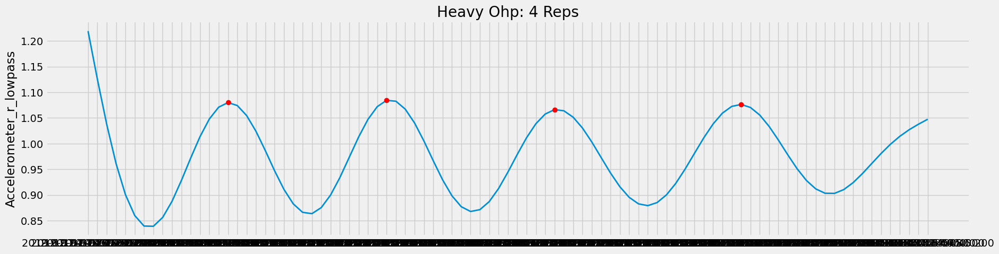

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


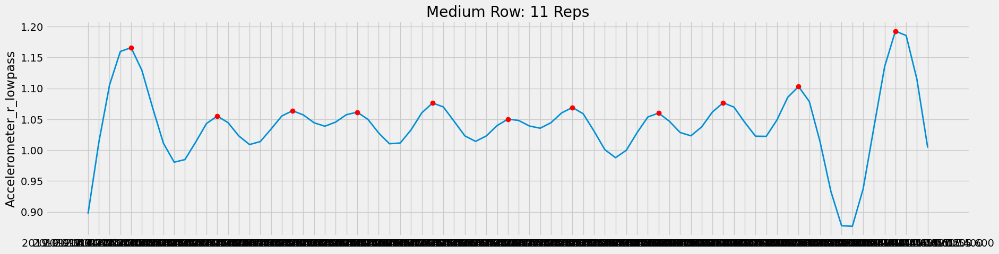

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


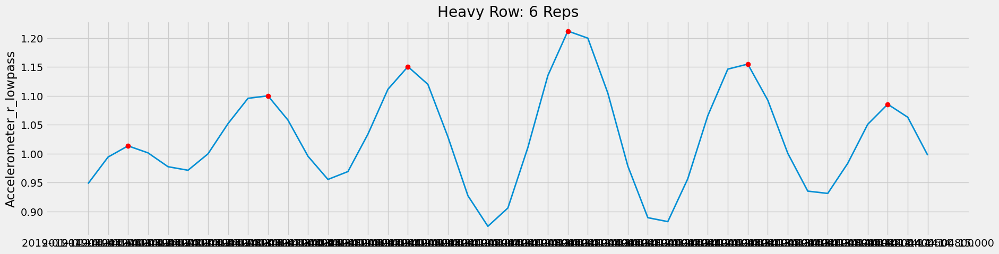

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


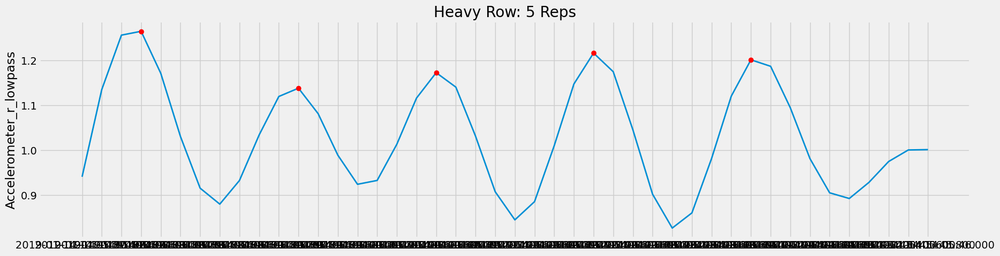

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


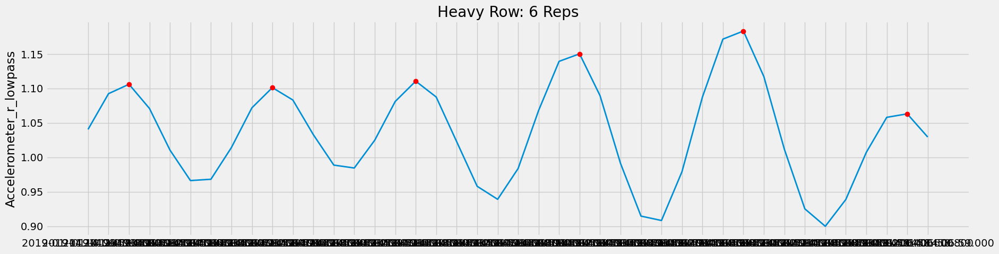

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


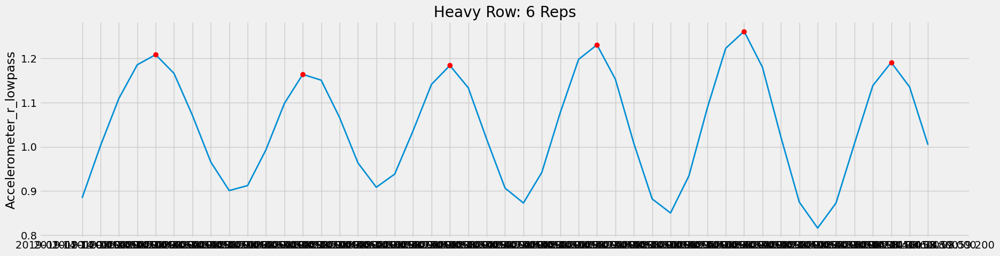

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


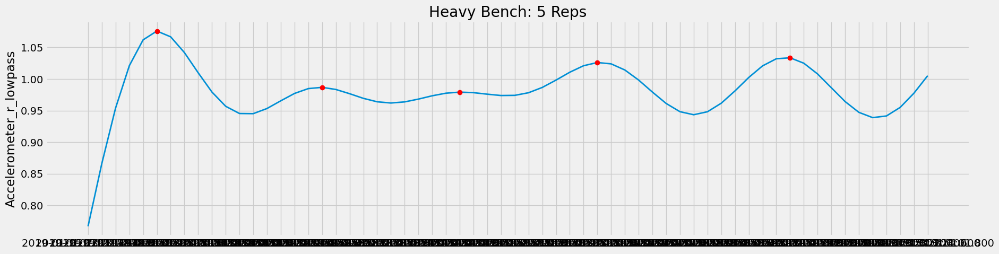

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


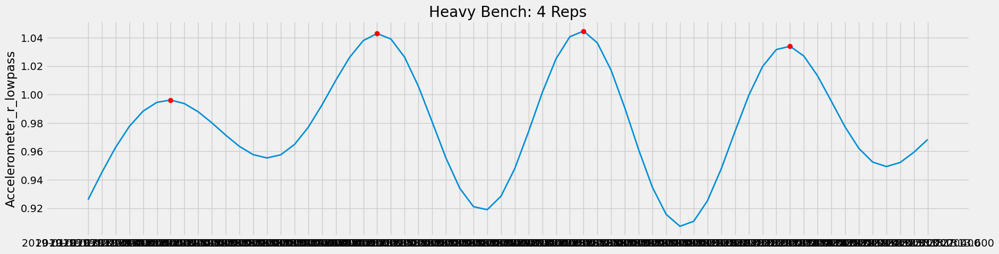

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


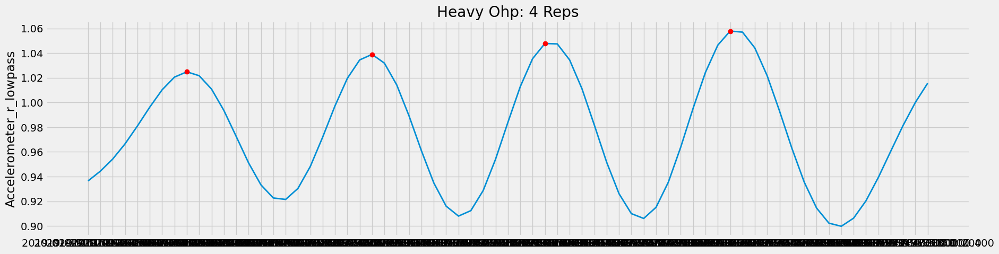

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


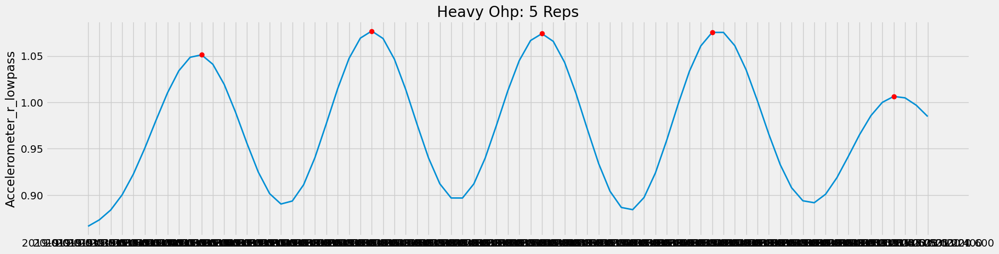

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


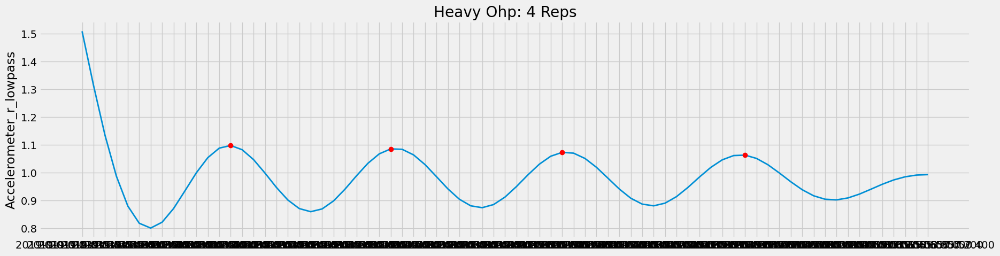

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


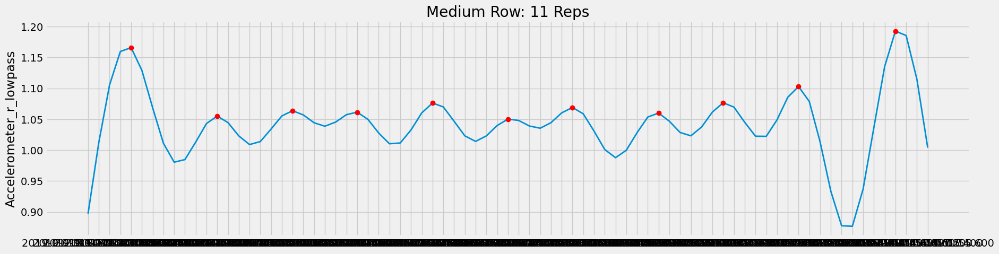

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


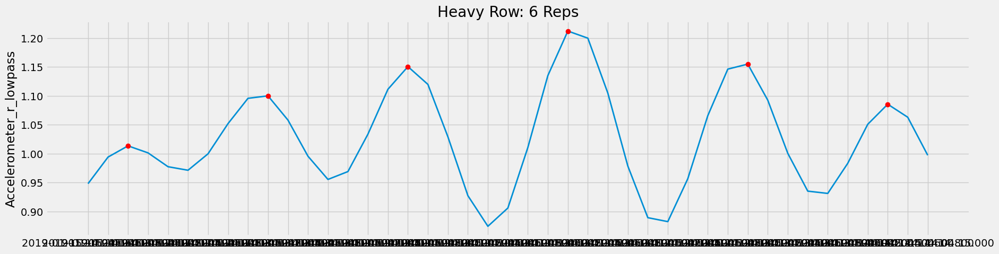

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


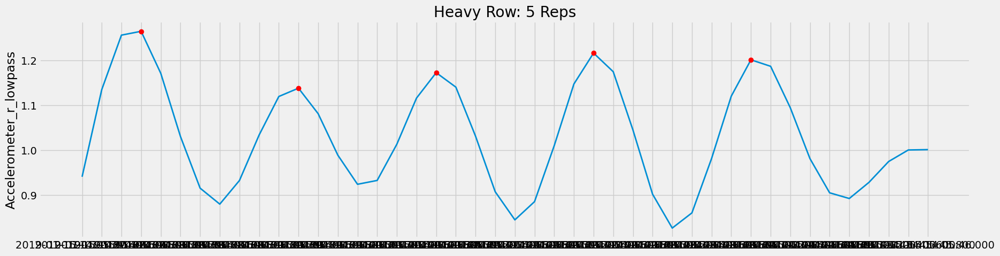

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


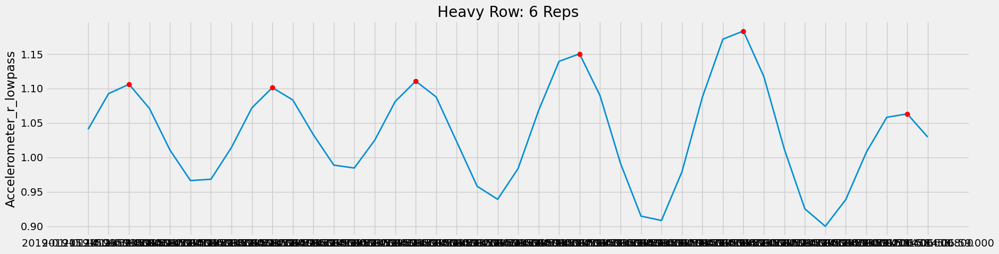

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


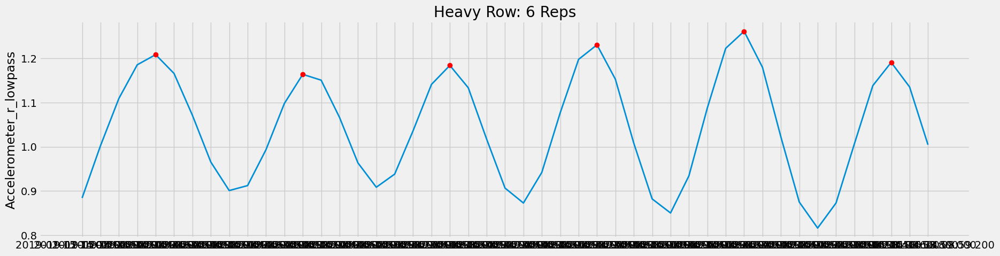

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


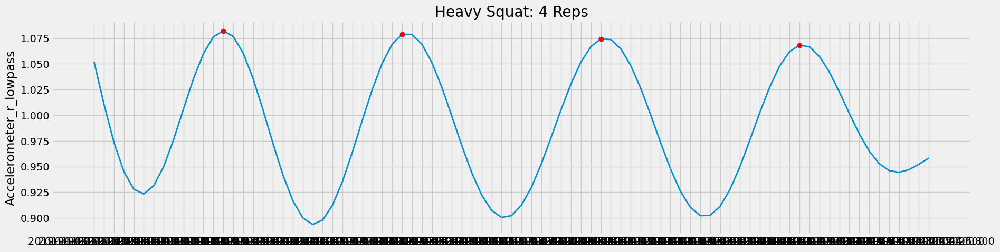

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


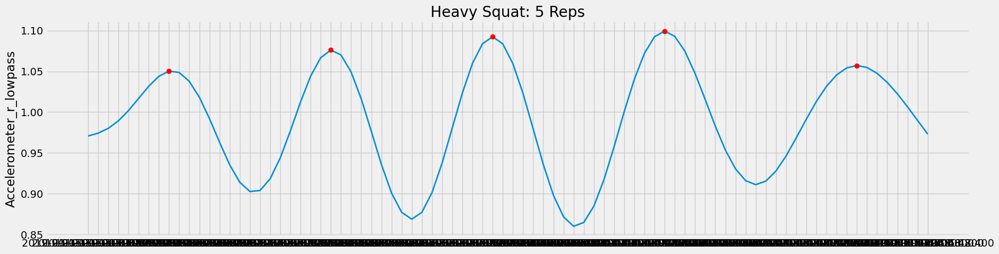

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


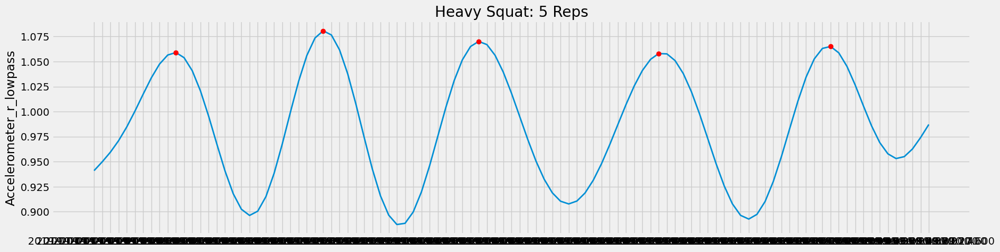

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


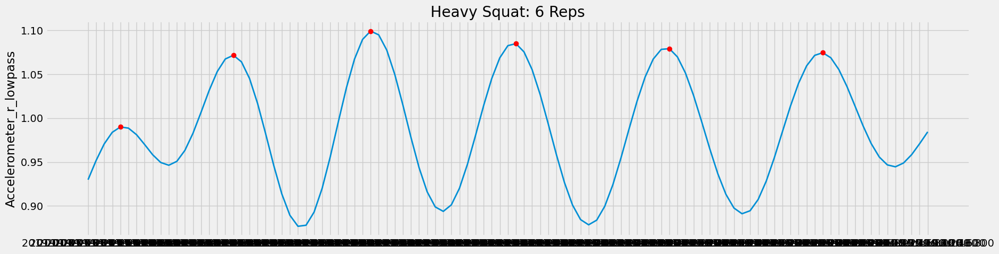

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


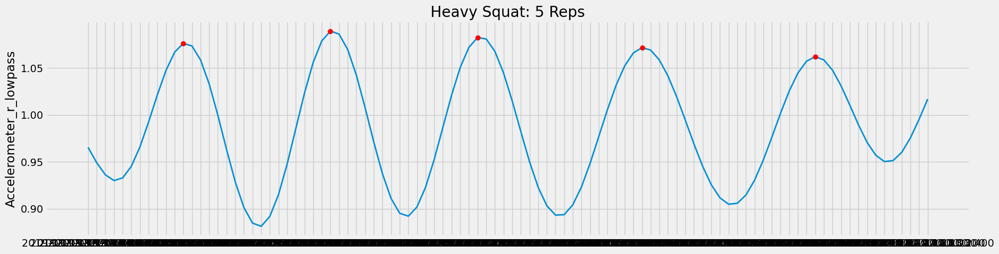

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


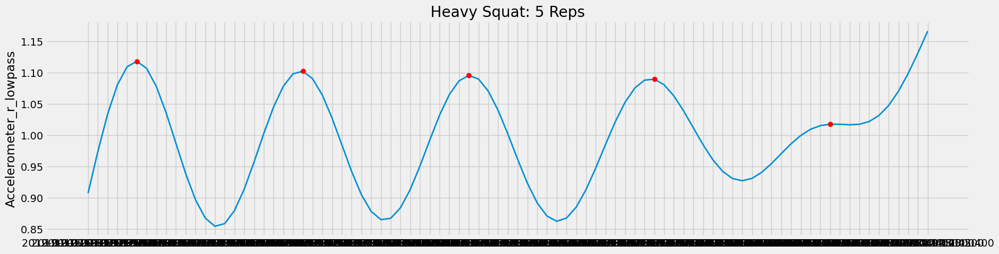

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


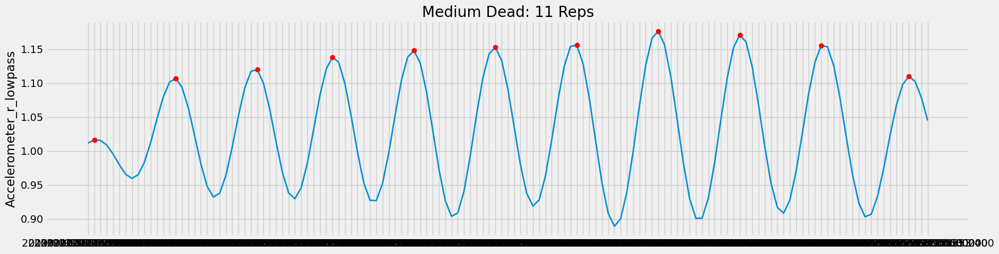

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


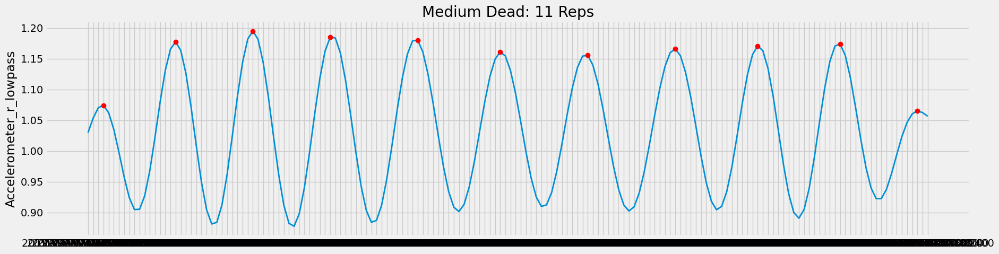

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


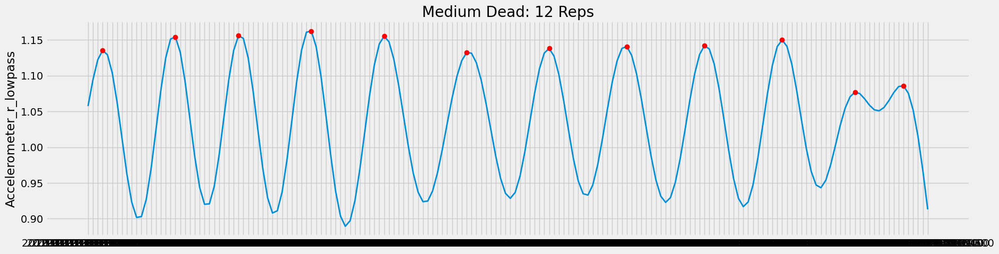

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


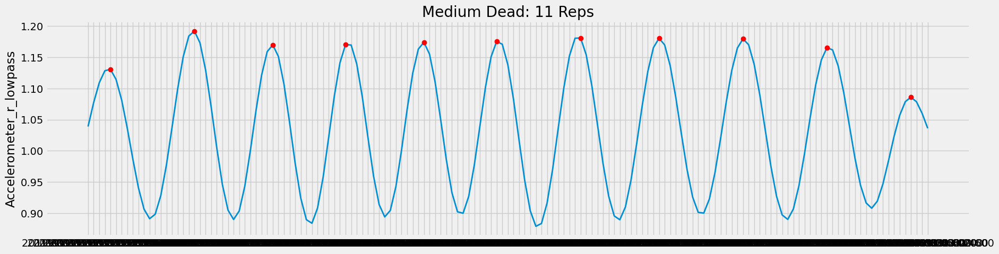

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


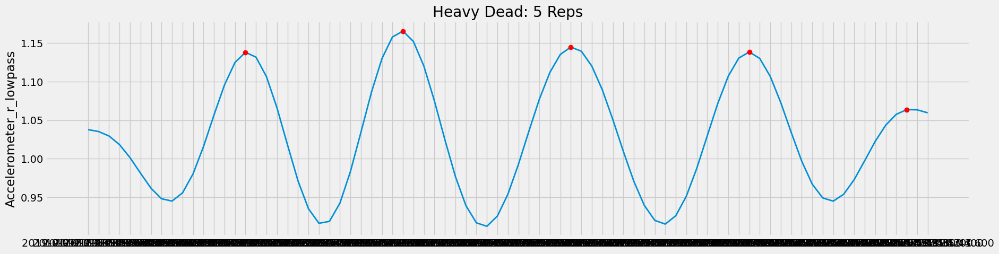

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


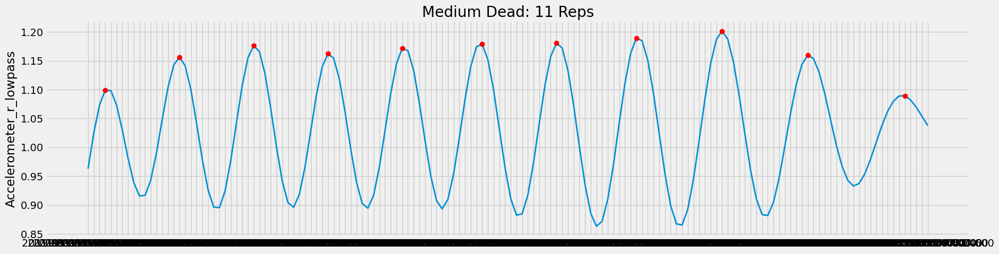

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


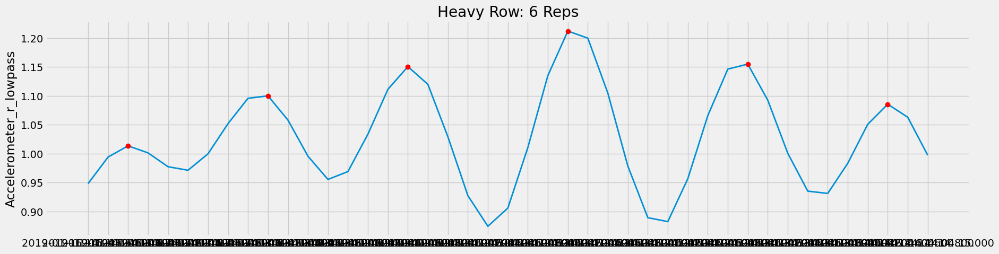

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


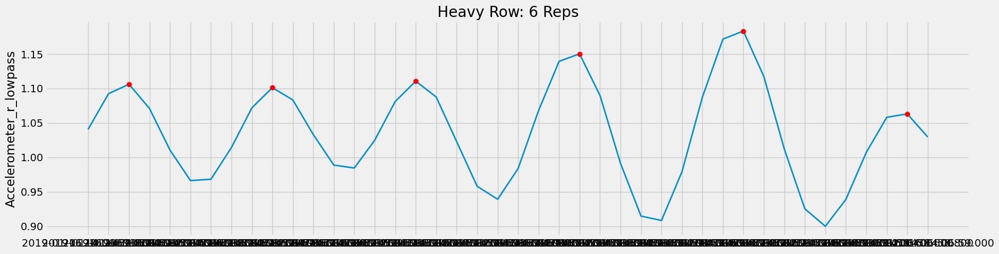

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


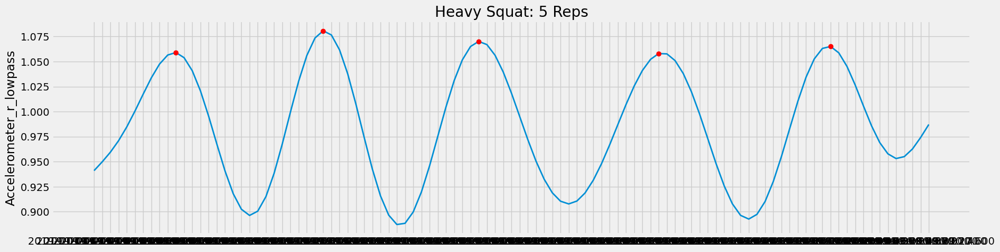

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


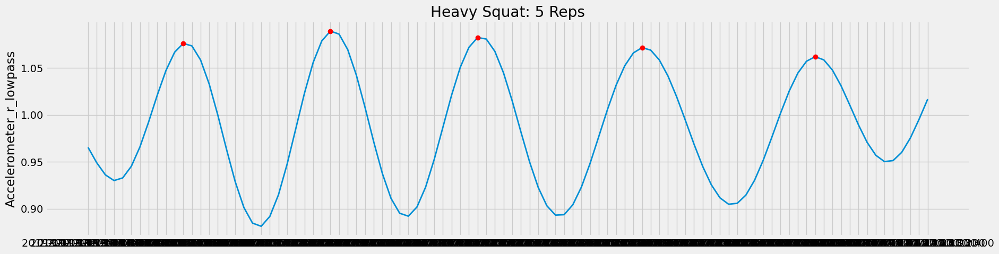

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


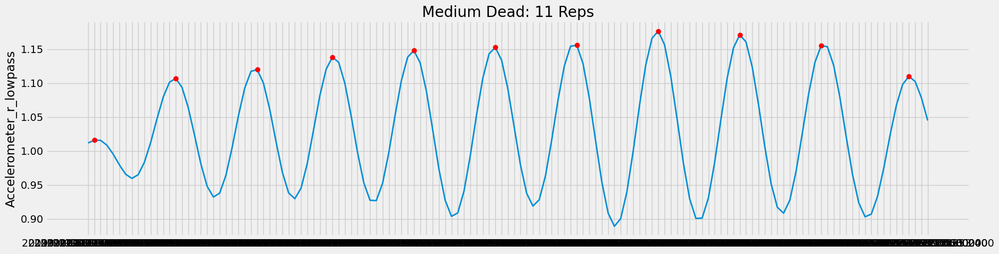

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


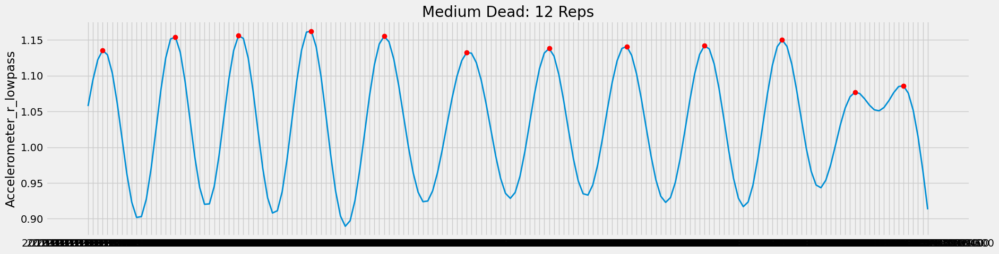

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


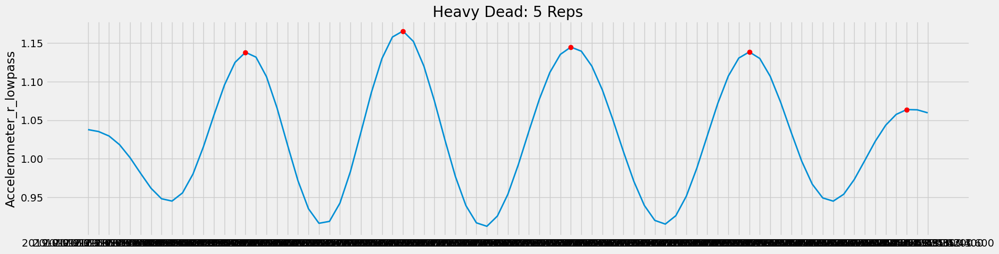

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


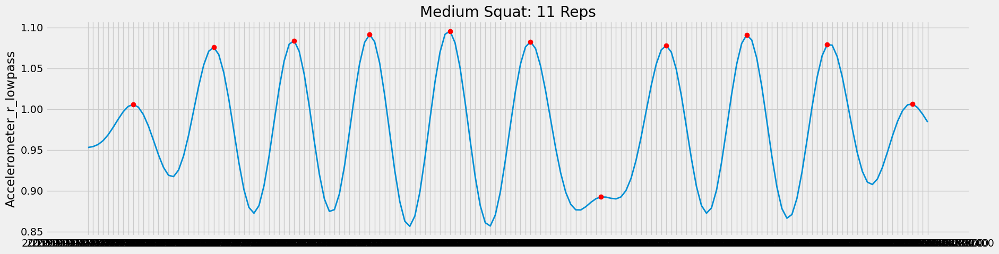

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


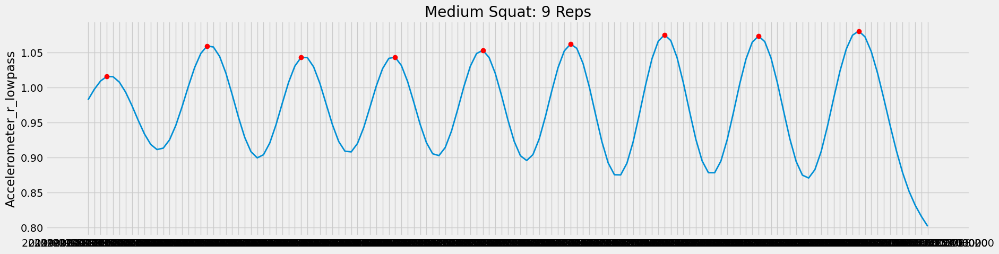

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


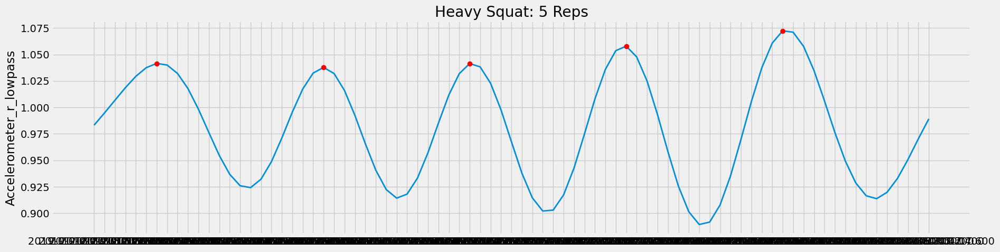

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


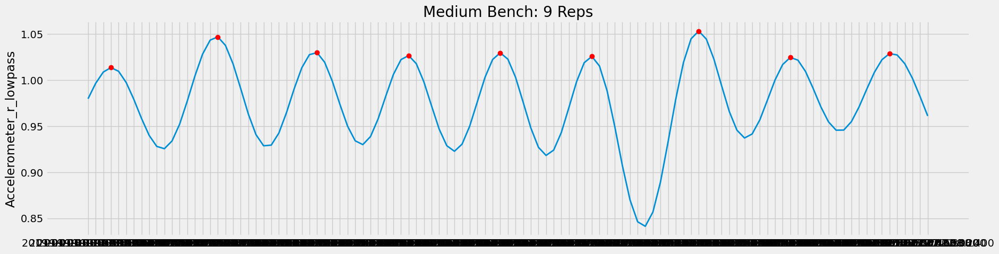

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


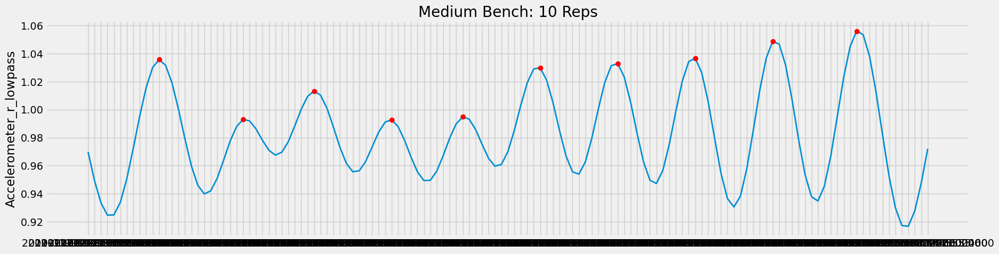

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


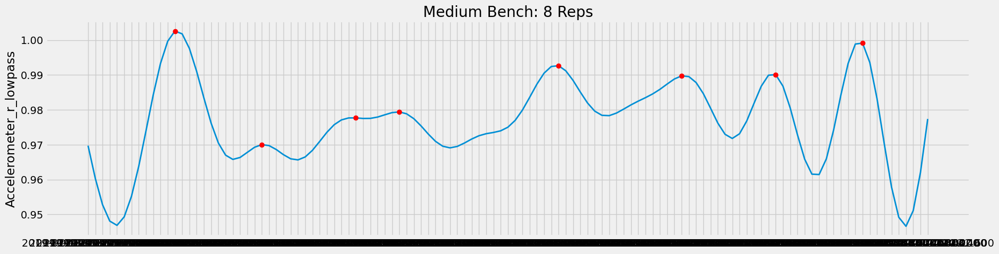

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


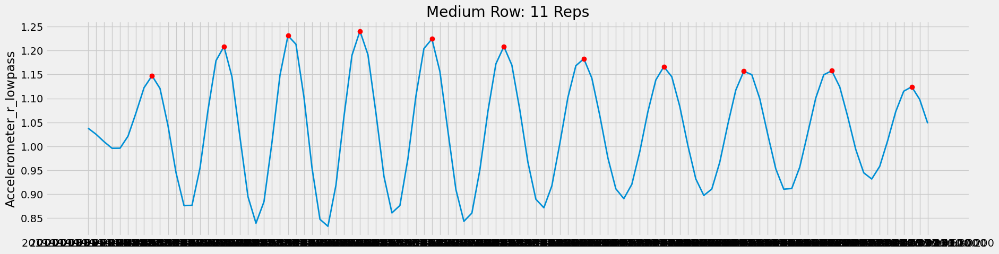

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


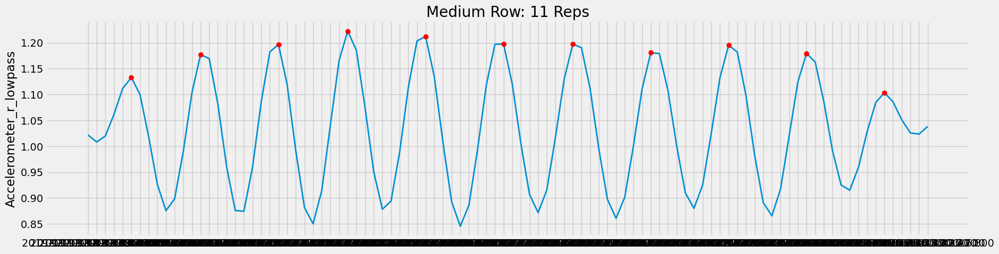

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


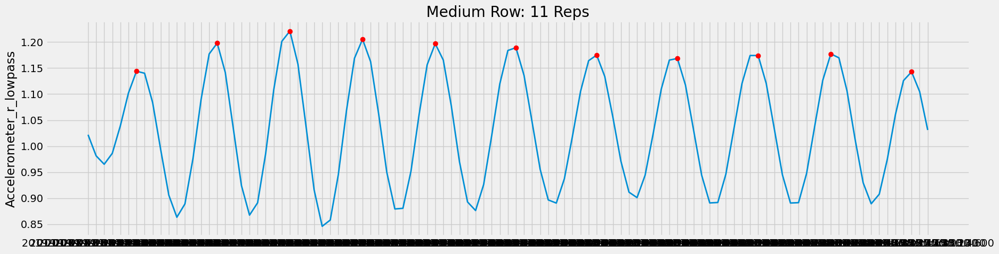

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


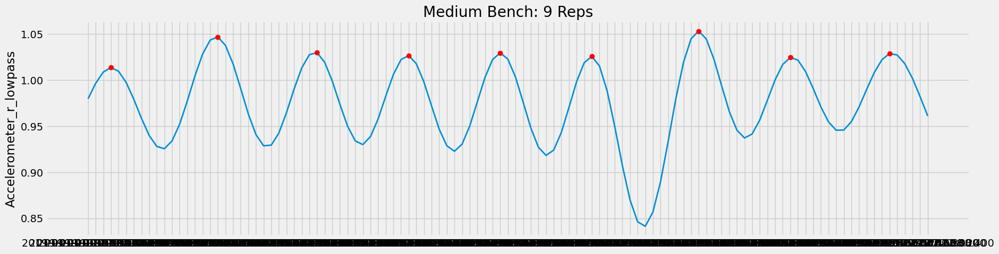

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


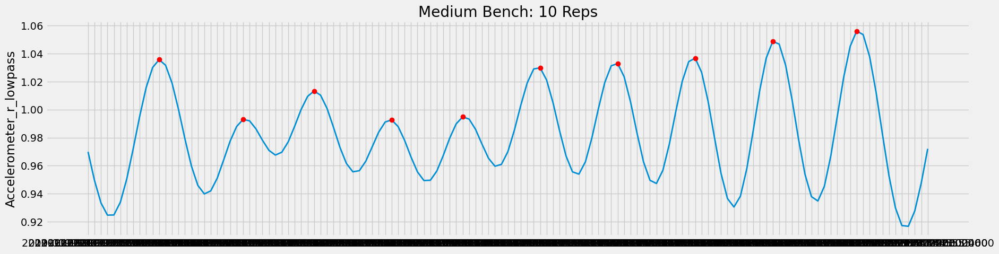

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


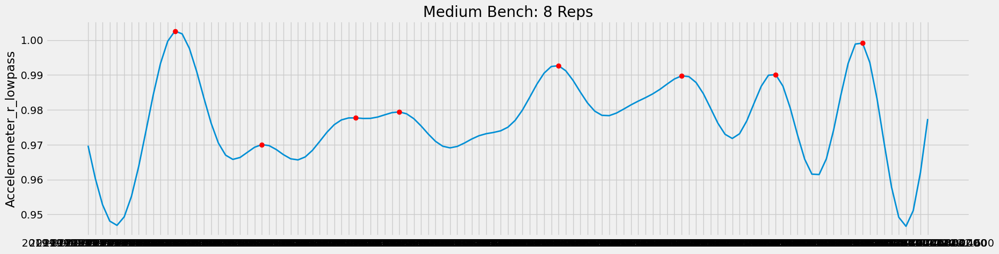

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


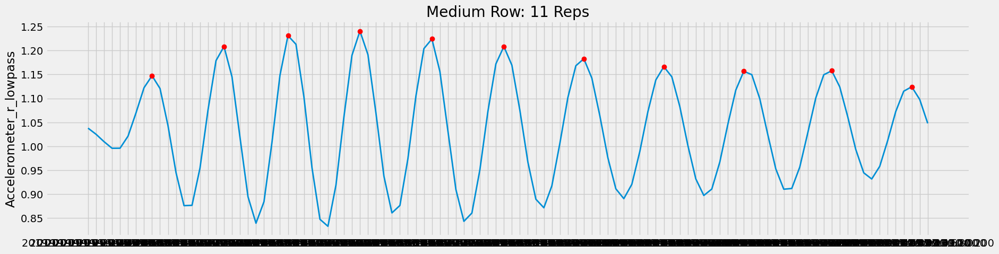

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


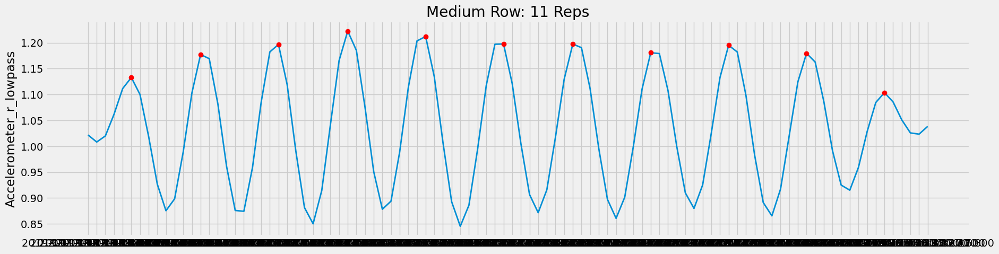

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


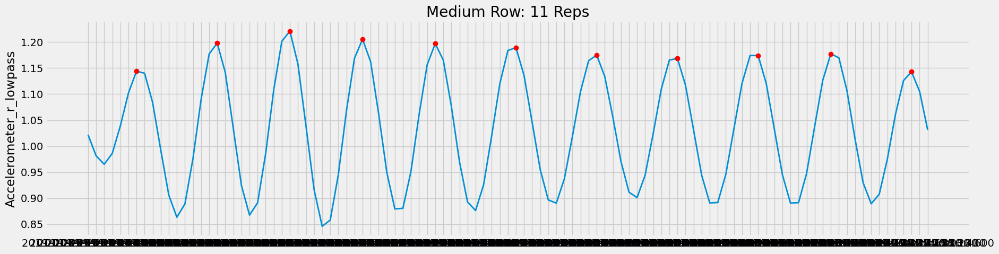

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


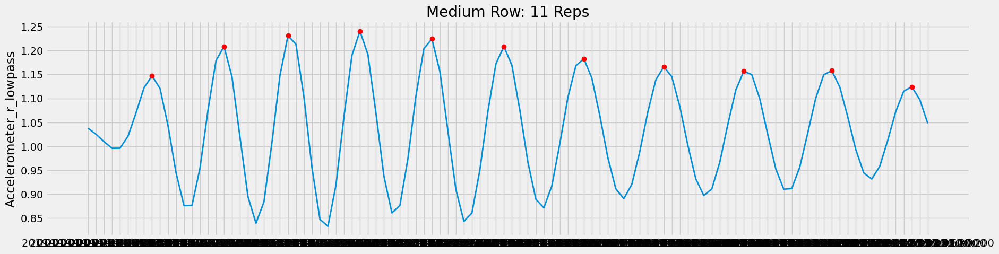

C:\Users\manoj\AppData\Local\Temp\ipykernel_26976\4190003827.py:704: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_table[col + '_lowpass'] = filtfilt(b, a, data_table[col])


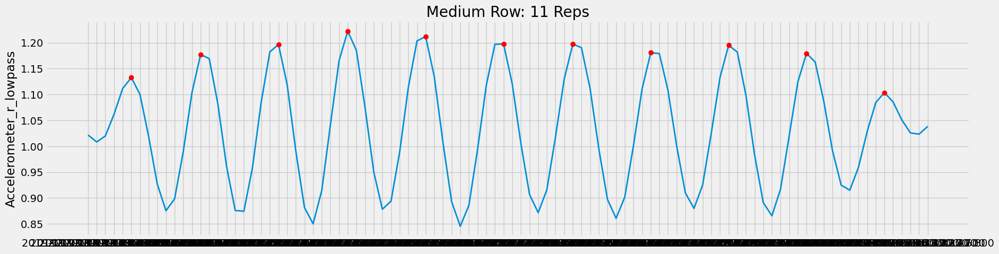

In [75]:
df["Reps"]=df["Category"].apply(lambda x:5 if x == "heavy" else 10)
rep_df=df.groupby(["Label","Category","Set"])["Reps"].max().reset_index()
rep_df["Reps_pred"]=0

for s in df["Set"].unique():
    subset=df[df["Set"]==s]
    column="Accelerometer_r"
    cutoff=0.4
    if subset["Label"].iloc[0] =="squat":
        cutoff=0.35
    if subset["Label"].iloc[0] =="row":
        cutoff=0.65
    if subset["Label"].iloc[0] =="ohp":
        cutoff=0.35

    reps=count(subset,cutoff,10,column)
    rep_df.loc[rep_df["Set"]==s,"Reps_pred"]=reps

In [76]:
rep_df

,Label,Category,Set,Reps,Reps_pred
0,bench,heavy,5,5,5
1,bench,heavy,7,5,5
2,bench,heavy,30,5,5
3,bench,heavy,33,5,5
4,bench,heavy,62,5,4
...,...,...,...,...,...
80,squat,medium,9,10,8
81,squat,medium,16,10,5
82,squat,medium,26,10,7
83,squat,medium,41,10,8


1.02


<Axes: xlabel='Label,Category'>

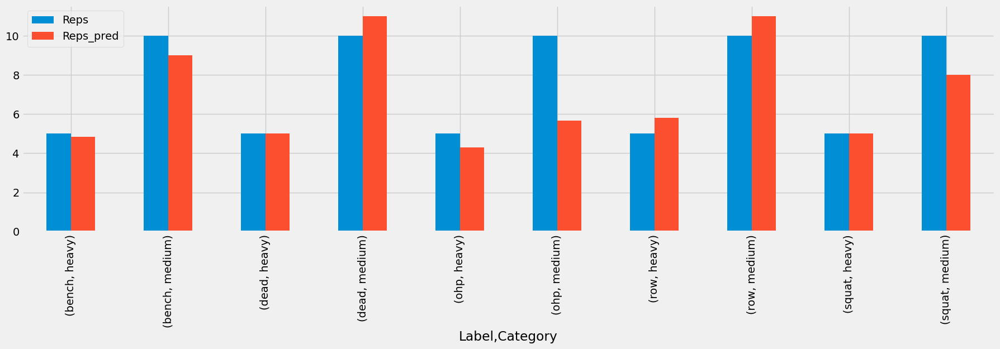

In [77]:
error=mean_absolute_error(rep_df["Reps"],rep_df["Reps_pred"]).round(2)
print(error)
rep_df.groupby(["Label","Category"])[["Reps","Reps_pred"]].mean().plot.bar()